In [1]:
import numpy as np
import h5py

#f = h5py.File("/oak/stanford/groups/akundaje/avsec/basepair/data/"
#              +"processed/comparison/output/nexus,peaks,OSNK,0,10"
#              +",1,FALSE,same,0.5,64,25,0.004,9,FALSE,[1,50],TRUE"
#              +",FALSE,1/deeplift.imp_score.h5", "r")
f = h5py.File("deeplift.imp_score.h5","r")
nanog_mask = np.array(f['metadata']['interval_from_task'][:]=='Nanog')
nanog_profile_wn_hypimp = np.array(f["hyp_imp/Nanog/profile/wn"][:])[nanog_mask]
onehot_seq = np.array(f["inputs/seq"][:])[nanog_mask]
nanog_profile_wn_contribs = nanog_profile_wn_hypimp*onehot_seq

In [2]:
import modisco
#track_set = modisco.tfmodisco_workflow.workflow.prep_track_set(
#    task_names=["Nanog_profile_wn"],
#    contrib_scores={'Nanog_profile_wn': nanog_profile_wn_contribs},
#    hypothetical_contribs={'Nanog_profile_wn': nanog_profile_wn_hypimp},
#    one_hot=onehot_seq)
#grp = h5py.File("/oak/stanford/groups/akundaje/avsec/basepair/data/processed/comparison/output/nexus"
#                +",peaks,OSNK,0,10,1,FALSE,same,0.5,64,25,0.004,9,FALSE,[1,50],TRUE,FALSE,1/deeplift"
#                +"/Nanog/out/profile/wn/modisco.h5","r")
#grp = h5py.File("modisco.h5","r")
#loaded_tfmodisco_results =\
#    modisco.tfmodisco_workflow.workflow.TfModiscoResults.from_hdf5(grp, track_set=track_set)
#grp.close()
#patterns = (loaded_tfmodisco_results
#            .metacluster_idx_to_submetacluster_results["metacluster_0"]
#            .seqlets_to_patterns_result.patterns)

In [3]:
#Saving the seqlets

"""extracted_contrib_scores = []
extracted_hypothetical_scores = []
extracted_onehot_seqs = []
seqlets_list = loaded_tfmodisco_results.multitask_seqlet_creation_results.final_seqlets

window_around = 50

#extract +/- 50bp around each seqlet
for seqlet in seqlets_list:
    example_idx = seqlet.coor.example_idx
    start = seqlet.coor.start
    end = seqlet.coor.end
    if ((start>=window_around) and (end<=1000-window_around)):
        extracted_contrib_scores.append(
            nanog_profile_wn_contribs[example_idx,start-window_around:end+window_around])
        extracted_hypothetical_scores.append(
            nanog_profile_wn_hypimp[example_idx,start-window_around:end+window_around])
        extracted_onehot_seqs.append(
            onehot_seq[example_idx,start-window_around:end+window_around])

np.save("extracted_contrib_scores.npy", np.array(extracted_contrib_scores))
np.save("extracted_hypothetical_scores.npy", np.array(extracted_hypothetical_scores))
np.save("extracted_onehot.npy", np.array(extracted_onehot_seqs))"""

'extracted_contrib_scores = []\nextracted_hypothetical_scores = []\nextracted_onehot_seqs = []\nseqlets_list = loaded_tfmodisco_results.multitask_seqlet_creation_results.final_seqlets\n\nwindow_around = 50\n\n#extract +/- 50bp around each seqlet\nfor seqlet in seqlets_list:\n    example_idx = seqlet.coor.example_idx\n    start = seqlet.coor.start\n    end = seqlet.coor.end\n    if ((start>=window_around) and (end<=1000-window_around)):\n        extracted_contrib_scores.append(\n            nanog_profile_wn_contribs[example_idx,start-window_around:end+window_around])\n        extracted_hypothetical_scores.append(\n            nanog_profile_wn_hypimp[example_idx,start-window_around:end+window_around])\n        extracted_onehot_seqs.append(\n            onehot_seq[example_idx,start-window_around:end+window_around])\n\nnp.save("extracted_contrib_scores.npy", np.array(extracted_contrib_scores))\nnp.save("extracted_hypothetical_scores.npy", np.array(extracted_hypothetical_scores))\nnp.save("

In [4]:
#for i in range(10):
#    seqlets_list = loaded_tfmodisco_results.multitask_seqlet_creation_results.final_seqlets
#    modisco.visualization.viz_sequence.plot_weights(seqlets_list[i]["Nanog_profile_wn_contrib_scores"].fwd)

In [5]:
#visualize the saved patterns:
"""%matplotlib inline
from modisco.visualization import viz_sequence
for idx,pattern in enumerate(patterns):
    print("pattern idx",idx)
    print(len(pattern.seqlets))
    viz_sequence.plot_weights(
        pattern["Nanog_profile_wn_contrib_scores"].fwd)
    viz_sequence.plot_weights(pattern["sequence"].fwd)"""

'%matplotlib inline\nfrom modisco.visualization import viz_sequence\nfor idx,pattern in enumerate(patterns):\n    print("pattern idx",idx)\n    print(len(pattern.seqlets))\n    viz_sequence.plot_weights(\n        pattern["Nanog_profile_wn_contrib_scores"].fwd)\n    viz_sequence.plot_weights(pattern["sequence"].fwd)'

/mnt/lab_data2/avanti/tfmodisco
commit 6249c01586b7a9cc4d27b0bcfdec1307bf066c2d (HEAD -> dev, origin/dev)
Author: Av Shrikumar <avanti.shrikumar@gmail.com>
Date:   Tue Mar 2 23:40:58 2021 -0800

    faster onthefly flank filling
/mnt/lab_data2/avanti/tfmodisco_bio_experiments/bpnet/trial1
MEMORY 2.829246464
On task Nanog_profile_wn
Computing windowed sums on original
Generating null dist
peak(mu)= 0.00754788601747714
Computing threshold
Subsampling!
For increasing = True , the minimum IR precision was 0.37577224214168486 occurring at 0.0 implying a frac_neg of 0.6019793855866568
To be conservative, adjusted frac neg is 0.95
For increasing = False , the minimum IR precision was 0.48571764379950555 occurring at -1.4484976418316364e-07 implying a frac_neg of 0.9444571409915278
To be conservative, adjusted frac neg is 0.95
Thresholds from null dist were -0.026598883792757988  and  0.25093573331832886 with frac passing 0.047041
Passing windows frac was 0.047041 , which is above  0.03 ; adju

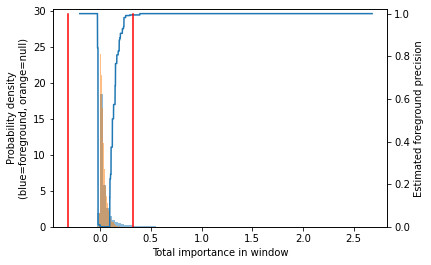

Got 97968 coords
After resolving overlaps, got 97968 seqlets
Across all tasks, the weakest transformed threshold used was: 0.9700270905407408
MEMORY 4.809089024
97968 identified in total
1 activity patterns with support >= 2000 out of 2 possible patterns
Metacluster sizes:  [97965]
Idx to activities:  {0: '1'}
MEMORY 4.809699328
On metacluster 0
Metacluster size 97965 limited to 50000
Relevant tasks:  ('Nanog_profile_wn',)
Relevant signs:  (1,)
TfModiscoSeqletsToPatternsFactory: seed=1234
(Round 1) num seqlets: 50000
(Round 1) Computing coarse affmat
MEMORY 4.809703424
Beginning embedding computation
MEMORY 4.809703424


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s
[Parallel(n_jobs=10)]: Done 290 tasks      | elapsed:    5.4s
[Parallel(n_jobs=10)]: Done 790 tasks      | elapsed:   10.5s
[Parallel(n_jobs=10)]: Done 1490 tasks      | elapsed:   17.2s
[Parallel(n_jobs=10)]: Done 2390 tasks      | elapsed:   25.8s
[Parallel(n_jobs=10)]: Done 3490 tasks      | elapsed:   36.8s
[Parallel(n_jobs=10)]: Done 4790 tasks      | elapsed:   49.5s
[Parallel(n_jobs=10)]: Done 6290 tasks      | elapsed:  1.1min
[Parallel(n_jobs=10)]: Done 7990 tasks      | elapsed:  1.4min
[Parallel(n_jobs=10)]: Done 9890 tasks      | elapsed:  1.7min
[Parallel(n_jobs=10)]: Done 11990 tasks      | elapsed:  2.0min
[Parallel(n_jobs=10)]: Done 14290 tasks      | elapsed:  2.4min
[Parallel(n_jobs=10)]: Done 16750 tasks      | elapsed:  2.8min
[Parallel(n_jobs=10)]: Done 19450 tasks      | elapsed:  3.3min
[Parallel(n_jobs=10)]: Done 22310 tasks 

Constructing csr matrix...
csr matrix made in 15.346668481826782 s


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 50000 out of 50000 | elapsed:  3.4min finished


Constructing csr matrix...
csr matrix made in 14.978031873703003 s
Finished embedding computation in 1584.5 s
MEMORY 12.311281664
Starting affinity matrix computations
MEMORY 12.311281664
Batching in slices of size 1342


100%|██████████| 38/38 [14:50<00:00, 23.43s/it]

Finished affinity matrix computations in 890.94 s
MEMORY 12.31163392


(Round 1) Computed coarse affmat
MEMORY 11.710611456
(Round 1) Computing affinity matrix on nearest neighbors
MEMORY 11.710611456
Launching nearest neighbors affmat calculation job
MEMORY 11.710615552
Parallel runs completed
MEMORY 12.158828544
Job completed in: 479.24 s
MEMORY 12.158312448
Launching nearest neighbors affmat calculation job
MEMORY 12.158312448
Parallel runs completed
MEMORY 12.570632192
Job completed in: 488.33 s
MEMORY 12.570632192
(Round 1) Computed affinity matrix on nearest neighbors in 983.72 s
MEMORY 12.404178944
Filtered down to 41997 of 50000
(Round 1) Retained 41997 rows out of 50000 after filtering
MEMORY 12.404445184
(Round 1) Computing density adapted affmat
MEMORY 12.404445184
[t-SNE] Computed conditional probabilities for sample 1000 / 41997
[t-SNE] Computed conditional probabilities for sample 2000 / 41997
[t-SNE] Computed conditional probabilities for sample 3000 / 41997
[t-SNE] Computed conditional probabilities for sample 4000 / 41997
[t-SNE] Computed

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  6.0min


Quality: 0.7561596221748645
Quality: 0.756257737241806
Quality: 0.7563831136214795
Quality: 0.7564157093885451
Quality: 0.7566731316389486


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  9.8min finished


Got 36 clusters after round 1
Counts:
{17: 919, 7: 2063, 10: 1803, 12: 1581, 3: 2693, 8: 1961, 4: 2527, 11: 1774, 13: 1546, 5: 2225, 16: 1084, 14: 1380, 9: 1944, 1: 3419, 0: 4668, 20: 657, 2: 3028, 15: 1165, 18: 766, 6: 2137, 19: 683, 21: 592, 31: 20, 30: 40, 23: 344, 35: 10, 28: 58, 27: 64, 24: 133, 32: 20, 25: 93, 29: 44, 22: 446, 26: 83, 34: 12, 33: 15}
MEMORY 12.456833024
(Round 1) Aggregating seqlets in each cluster
MEMORY 12.456833024
Aggregating for cluster 0 with 4668 seqlets
MEMORY 12.456833024
Skipped 1 seqlets that went over sequence edge during flank expansion
Skipped 12 due to duplicates
Trimming eliminated 0 seqlets out of 4655
Aggregating for cluster 1 with 3419 seqlets
MEMORY 12.45632512
Skipped 7 due to duplicates
Trimming eliminated 0 seqlets out of 3412
Skipped 1 seqlets that went over the sequence edge during flank expansion
Aggregating for cluster 2 with 3028 seqlets
MEMORY 12.45632512
Skipped 14 due to duplicates
Trimming eliminated 0 seqlets out of 3014
Aggregati

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  31 tasks      | elapsed:   10.3s
[Parallel(n_jobs=10)]: Done 272 tasks      | elapsed:   12.9s
[Parallel(n_jobs=10)]: Done 772 tasks      | elapsed:   17.5s
[Parallel(n_jobs=10)]: Done 1472 tasks      | elapsed:   23.6s
[Parallel(n_jobs=10)]: Done 2372 tasks      | elapsed:   33.1s
[Parallel(n_jobs=10)]: Done 3472 tasks      | elapsed:   43.6s
[Parallel(n_jobs=10)]: Done 4772 tasks      | elapsed:   56.2s
[Parallel(n_jobs=10)]: Done 6272 tasks      | elapsed:  1.2min
[Parallel(n_jobs=10)]: Done 7952 tasks      | elapsed:  1.5min
[Parallel(n_jobs=10)]: Done 9852 tasks      | elapsed:  1.7min
[Parallel(n_jobs=10)]: Done 11952 tasks      | elapsed:  2.0min
[Parallel(n_jobs=10)]: Done 14252 tasks      | elapsed:  2.3min
[Parallel(n_jobs=10)]: Done 18014 tasks      | elapsed:  2.8min
[Parallel(n_jobs=10)]: Done 23414 tasks      | elapsed:  3.5min
[Parallel(n_jobs=10)]: Done 29024 tasks 

Constructing csr matrix...
csr matrix made in 12.5861496925354 s


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 41724 out of 41724 | elapsed:  2.8min finished


Constructing csr matrix...
csr matrix made in 12.921867609024048 s
Finished embedding computation in 1153.27 s
MEMORY 13.793779712
Starting affinity matrix computations
MEMORY 13.793779712
Batching in slices of size 1608


100%|██████████| 26/26 [08:36<00:00, 19.85s/it]

Finished affinity matrix computations in 516.55 s
MEMORY 13.793779712


(Round 2) Computed coarse affmat
MEMORY 13.297393664
(Round 2) Computing affinity matrix on nearest neighbors
MEMORY 13.297393664
Launching nearest neighbors affmat calculation job
MEMORY 13.60437248
Parallel runs completed
MEMORY 13.697171456
Job completed in: 578.51 s
MEMORY 13.696909312
Launching nearest neighbors affmat calculation job
MEMORY 13.696876544
Parallel runs completed
MEMORY 13.877014528
Job completed in: 612.61 s
MEMORY 13.876752384
(Round 2) Computed affinity matrix on nearest neighbors in 1205.69 s
MEMORY 13.497339904
Not applying filtering for rounds above first round
MEMORY 13.497339904
(Round 2) Computing density adapted affmat
MEMORY 13.497339904
[t-SNE] Computed conditional probabilities for sample 1000 / 41724
[t-SNE] Computed conditional probabilities for sample 2000 / 41724
[t-SNE] Computed conditional probabilities for sample 3000 / 41724
[t-SNE] Computed conditional probabilities for sample 4000 / 41724
[t-SNE] Computed conditional probabilities for sample 5

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  5.8min


Quality: 0.7337403400620817
Quality: 0.7342751390960633
Quality: 0.7347553019780648
Quality: 0.7350182349722025


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  9.1min finished


Got 38 clusters after round 2
Counts:
{0: 5072, 8: 2023, 16: 1129, 13: 1412, 1: 3445, 14: 1341, 4: 2342, 10: 1901, 26: 111, 34: 20, 19: 566, 15: 1255, 12: 1606, 3: 2431, 9: 1960, 18: 816, 20: 534, 11: 1763, 7: 2037, 2: 2964, 5: 2104, 6: 2046, 17: 998, 21: 517, 31: 45, 24: 149, 32: 45, 30: 53, 28: 81, 25: 127, 29: 75, 22: 463, 36: 11, 27: 84, 23: 152, 35: 17, 33: 20, 37: 9}
MEMORY 13.494460416
(Round 2) Aggregating seqlets in each cluster
MEMORY 13.494460416
Aggregating for cluster 0 with 5072 seqlets
MEMORY 13.494460416
Removed 1 duplicate seqlets
Skipped 220 due to duplicates
Trimming eliminated 0 seqlets out of 4851
Aggregating for cluster 1 with 3445 seqlets
MEMORY 13.493673984
Skipped 88 due to duplicates
Trimming eliminated 0 seqlets out of 3357
Aggregating for cluster 2 with 2964 seqlets
MEMORY 13.49341184
Skipped 69 due to duplicates
Trimming eliminated 0 seqlets out of 2895
Aggregating for cluster 3 with 2431 seqlets
MEMORY 13.49341184
Skipped 144 due to duplicates
Trimming eli

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  31 tasks      | elapsed:    4.5s
[Parallel(n_jobs=10)]: Done 414 tasks      | elapsed:    7.0s
[Parallel(n_jobs=10)]: Done 1414 tasks      | elapsed:   11.6s
[Parallel(n_jobs=10)]: Done 2814 tasks      | elapsed:   18.1s
[Parallel(n_jobs=10)]: Done 4614 tasks      | elapsed:   26.3s
[Parallel(n_jobs=10)]: Done 4851 out of 4851 | elapsed:   27.4s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 4851
[t-SNE] Computed conditional probabilities for sample 2000 / 4851
[t-SNE] Computed conditional probabilities for sample 3000 / 4851
[t-SNE] Computed conditional probabilities for sample 4000 / 4851
[t-SNE] Computed conditional probabilities for sample 4851 / 4851
[t-SNE] Mean sigma: 0.244644
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  1.3min


Quality: 0.4707135848273627
Quality: 0.4708840240592573
Quality: 0.471392900552412
Quality: 0.4714661558865675
Quality: 0.4714732652226196
Quality: 0.47237356338238395


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  2.0min finished


Got subclusters: Counter({0: 696, 1: 683, 2: 548, 3: 326, 4: 313, 5: 312, 6: 312, 7: 296, 8: 269, 9: 259, 10: 239, 11: 235, 12: 152, 13: 141, 14: 70})
On merging iteration 1
Numbers for each pattern pre-subsample: [696, 683, 548, 326, 313, 312, 312, 296, 269, 259, 239, 235, 152, 141, 70]
Numbers after subsampling: [300, 300, 300, 300, 300, 300, 300, 296, 269, 259, 239, 235, 152, 141, 70]
Computing sims for pattern 0
Computed sims for pattern 0 in 8.070210456848145 s
Computing sims for pattern 1
Computed sims for pattern 1 in 7.629241943359375 s
Computing sims for pattern 2
Computed sims for pattern 2 in 7.675075054168701 s
Computing sims for pattern 3
Computed sims for pattern 3 in 7.910162687301636 s
Computing sims for pattern 4
Computed sims for pattern 4 in 7.53942608833313 s
Computing sims for pattern 5
Computed sims for pattern 5 in 7.659158229827881 s
Computing sims for pattern 6
Computed sims for pattern 6 in 10.323457956314087 s
Computing sims for pattern 7
Computed sims for pa

Removed 1 duplicate seqlets
Skipped 3 due to duplicates
Trimming eliminated 0 seqlets out of 4071
Trimming eliminated 0 seqlets out of 4141
Trimming eliminated 0 seqlets out of 4376
Unmerged patterns remapping: OrderedDict([(4, 1), (12, 2)])
Time spent on merging iteration: 80.5971155166626
On merging iteration 2
Numbers for each pattern pre-subsample: [4376, 313, 152]
Numbers after subsampling: [300, 300, 152]
Computing sims for pattern 0
Computed sims for pattern 0 in 1.0840198993682861 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.5526998043060303 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.338407039642334 s
Cluster sizes
[4376  313  152]
Cross-contamination matrix:
[[1.   0.89 0.8 ]
 [0.57 1.   0.54]
 [0.65 0.69 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.83 0.86]
 [0.83 1.   0.73]
 [0.86 0.73 1.  ]]
Collapsing 0 & 2 with crosscontam 0.6539156392756476 and sim 0.8618149412760803
Trimming eliminated 0 seqlets out of 4528
Unmerged patterns rem

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=10)]: Done 1060 tasks      | elapsed:    3.7s
[Parallel(n_jobs=10)]: Done 3060 tasks      | elapsed:   10.3s
[Parallel(n_jobs=10)]: Done 3357 out of 3357 | elapsed:   11.2s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 3357
[t-SNE] Computed conditional probabilities for sample 2000 / 3357
[t-SNE] Computed conditional probabilities for sample 3000 / 3357
[t-SNE] Computed conditional probabilities for sample 3357 / 3357
[t-SNE] Mean sigma: 0.248560
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   44.3s


Quality: 0.48397440476844344
Quality: 0.4841968947957224
Quality: 0.48472144393379474


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  1.2min finished


Got subclusters: Counter({0: 675, 1: 561, 2: 558, 3: 521, 4: 239, 5: 193, 6: 185, 7: 167, 8: 164, 9: 94})
On merging iteration 1
Numbers for each pattern pre-subsample: [675, 561, 558, 521, 239, 193, 185, 167, 164, 94]
Numbers after subsampling: [300, 300, 300, 300, 239, 193, 185, 167, 164, 94]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.627585172653198 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.601367712020874 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.6640379428863525 s
Computing sims for pattern 3
Computed sims for pattern 3 in 6.198174953460693 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.913205862045288 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.8294925689697266 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.7284934520721436 s
Computing sims for pattern 7
Computed sims for pattern 7 in 3.1054139137268066 s
Computing sims for pattern 8
Computed sims for pattern 8 in 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.2s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    3.5s
[Parallel(n_jobs=10)]: Done 2876 out of 2895 | elapsed:    9.0s remaining:    0.1s
[Parallel(n_jobs=10)]: Done 2895 out of 2895 | elapsed:    9.0s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 2895
[t-SNE] Computed conditional probabilities for sample 2000 / 2895
[t-SNE] Computed conditional probabilities for sample 2895 / 2895
[t-SNE] Mean sigma: 0.274676
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   34.6s


Quality: 0.56097555903219


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   57.2s finished


Got subclusters: Counter({0: 493, 1: 453, 2: 378, 3: 305, 4: 217, 5: 215, 6: 200, 7: 190, 8: 163, 9: 150, 10: 89, 11: 42})
On merging iteration 1
Numbers for each pattern pre-subsample: [493, 453, 378, 305, 217, 215, 200, 190, 163, 150, 89, 42]
Numbers after subsampling: [300, 300, 300, 300, 217, 215, 200, 190, 163, 150, 89, 42]
Computing sims for pattern 0
Computed sims for pattern 0 in 5.714242219924927 s
Computing sims for pattern 1
Computed sims for pattern 1 in 5.713205575942993 s
Computing sims for pattern 2
Computed sims for pattern 2 in 5.644290447235107 s
Computing sims for pattern 3
Computed sims for pattern 3 in 5.8127195835113525 s
Computing sims for pattern 4
Computed sims for pattern 4 in 5.73624587059021 s
Computing sims for pattern 5
Computed sims for pattern 5 in 5.5473926067352295 s
Computing sims for pattern 6
Computed sims for pattern 6 in 5.092893362045288 s
Computing sims for pattern 7
Computed sims for pattern 7 in 4.65223503112793 s
Computing sims for pattern 8


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.4s
[Parallel(n_jobs=10)]: Done 2287 out of 2287 | elapsed:    4.9s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 2287
[t-SNE] Computed conditional probabilities for sample 2000 / 2287
[t-SNE] Computed conditional probabilities for sample 2287 / 2287
[t-SNE] Mean sigma: 0.280784
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   27.9s


Quality: 0.49488835627581945
Quality: 0.4952029881717138


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   42.6s finished


Got subclusters: Counter({0: 582, 1: 571, 2: 396, 3: 186, 4: 145, 5: 113, 6: 101, 7: 94, 8: 54, 9: 45})
On merging iteration 1
Numbers for each pattern pre-subsample: [582, 571, 396, 186, 145, 113, 101, 94, 54, 45]
Numbers after subsampling: [300, 300, 300, 186, 145, 113, 101, 94, 54, 45]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.4480814933776855 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.401301622390747 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.2430078983306885 s
Computing sims for pattern 3
Computed sims for pattern 3 in 3.480325222015381 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.524944543838501 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.071532726287842 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.8643949031829834 s
Computing sims for pattern 7
Computed sims for pattern 7 in 2.2657599449157715 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.4146

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.5s
[Parallel(n_jobs=10)]: Done 2191 out of 2191 | elapsed:    4.9s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 2191
[t-SNE] Computed conditional probabilities for sample 2000 / 2191
[t-SNE] Computed conditional probabilities for sample 2191 / 2191
[t-SNE] Mean sigma: 0.278720
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   22.0s


Quality: 0.4610560697476736
Quality: 0.46299071192014335
Quality: 0.46332449732024045
Quality: 0.46342910619320116
Quality: 0.4638435477134887


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   37.6s finished


Got subclusters: Counter({0: 532, 1: 492, 2: 403, 3: 275, 4: 179, 5: 140, 6: 70, 7: 56, 8: 30, 9: 14})
On merging iteration 1
Numbers for each pattern pre-subsample: [532, 492, 403, 275, 179, 140, 70, 56, 30, 14]
Numbers after subsampling: [300, 300, 300, 275, 179, 140, 70, 56, 30, 14]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.472055673599243 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.342688798904419 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.356900215148926 s
Computing sims for pattern 3
Computed sims for pattern 3 in 4.709759473800659 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.2090766429901123 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.2720866203308105 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.488292932510376 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.3870337009429932 s
Computing sims for pattern 8
Computed sims for pattern 8 in 0.99416112

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.2s
[Parallel(n_jobs=10)]: Done 2000 out of 2000 | elapsed:    4.0s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 2000
[t-SNE] Computed conditional probabilities for sample 2000 / 2000
[t-SNE] Mean sigma: 0.274918
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   23.3s


Quality: 0.44783202233142283
Quality: 0.4489814565054474
Quality: 0.44911896977201765
Quality: 0.44934754154508283
Quality: 0.4494313666897634


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   37.3s finished


Got subclusters: Counter({0: 329, 1: 318, 2: 315, 3: 189, 4: 142, 5: 132, 6: 129, 7: 117, 8: 90, 9: 82, 10: 72, 11: 52, 12: 21, 13: 12})
On merging iteration 1
Numbers for each pattern pre-subsample: [329, 318, 315, 189, 142, 132, 129, 117, 90, 82, 72, 52, 21, 12]
Numbers after subsampling: [300, 300, 300, 189, 142, 132, 129, 117, 90, 82, 72, 52, 21, 12]
Computing sims for pattern 0
Computed sims for pattern 0 in 6.109211444854736 s
Computing sims for pattern 1
Computed sims for pattern 1 in 6.065683126449585 s
Computing sims for pattern 2
Computed sims for pattern 2 in 5.749549388885498 s
Computing sims for pattern 3
Computed sims for pattern 3 in 4.726638317108154 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.0738024711608887 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.503885269165039 s
Computing sims for pattern 6
Computed sims for pattern 6 in 6.212932586669922 s
Computing sims for pattern 7
Computed sims for pattern 7 in 5.290745258331299 s
Co

Computed sims for pattern 0 in 0.8351137638092041 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.2812509536743164 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.10765719413757324 s
Cluster sizes
[1902   82   12]
Cross-contamination matrix:
[[1.   0.81 0.75]
 [0.45 1.   0.3 ]
 [0.31 0.27 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.83 0.77]
 [0.83 1.   0.63]
 [0.77 0.63 1.  ]]
Inspecting pattern 6 for spurious merging


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.4s
[Parallel(n_jobs=10)]: Done 1965 out of 1965 | elapsed:    4.1s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1965
[t-SNE] Computed conditional probabilities for sample 1965 / 1965
[t-SNE] Mean sigma: 0.293124
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   22.2s


Quality: 0.5147951174204425
Quality: 0.5150590127159035
Quality: 0.5153398317733272


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   33.7s finished


Got subclusters: Counter({0: 413, 1: 350, 2: 306, 3: 262, 4: 140, 5: 118, 6: 103, 7: 83, 8: 80, 9: 76, 10: 27, 11: 7})
On merging iteration 1
Numbers for each pattern pre-subsample: [413, 350, 306, 262, 140, 118, 103, 83, 80, 76, 27, 7]
Numbers after subsampling: [300, 300, 300, 262, 140, 118, 103, 83, 80, 76, 27, 7]
Computing sims for pattern 0
Computed sims for pattern 0 in 8.345816135406494 s
Computing sims for pattern 1
Computed sims for pattern 1 in 6.2556328773498535 s
Computing sims for pattern 2
Computed sims for pattern 2 in 6.343267202377319 s
Computing sims for pattern 3
Computed sims for pattern 3 in 5.55919623374939 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.7994980812072754 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.7368478775024414 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.9842371940612793 s
Computing sims for pattern 7
Computed sims for pattern 7 in 3.438647747039795 s
Computing sims for pattern 8
Computed 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.3s
[Parallel(n_jobs=10)]: Done 1909 out of 1909 | elapsed:    3.8s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1909
[t-SNE] Computed conditional probabilities for sample 1909 / 1909
[t-SNE] Mean sigma: 0.275251
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   25.3s


Quality: 0.49458189709294553
Quality: 0.49903171815583164
Quality: 0.5000919029821745
Quality: 0.5002195701332111
Quality: 0.5002383033867678


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   38.4s finished


Got subclusters: Counter({0: 474, 1: 351, 2: 322, 3: 155, 4: 154, 5: 126, 6: 105, 7: 101, 8: 76, 9: 37, 10: 8})
On merging iteration 1
Numbers for each pattern pre-subsample: [474, 351, 322, 155, 154, 126, 105, 101, 76, 37, 8]
Numbers after subsampling: [300, 300, 300, 155, 154, 126, 105, 101, 76, 37, 8]
Computing sims for pattern 0
Computed sims for pattern 0 in 5.486879587173462 s
Computing sims for pattern 1
Computed sims for pattern 1 in 5.4017579555511475 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.9911980628967285 s
Computing sims for pattern 3
Computed sims for pattern 3 in 2.992722272872925 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.9037063121795654 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.7407870292663574 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.323467254638672 s
Computing sims for pattern 7
Computed sims for pattern 7 in 2.163088321685791 s
Computing sims for pattern 8
Computed sims for pat

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.2s
[Parallel(n_jobs=10)]: Done 1853 out of 1872 | elapsed:    3.7s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 1872 out of 1872 | elapsed:    3.7s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1872
[t-SNE] Computed conditional probabilities for sample 1872 / 1872
[t-SNE] Mean sigma: 0.286975
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   17.2s


Quality: 0.48853508738321955
Quality: 0.48863597717426677
Quality: 0.4896670429711656
Quality: 0.4897301804201011
Quality: 0.49021342572254073


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   27.7s finished


Got subclusters: Counter({0: 463, 1: 437, 2: 404, 3: 150, 4: 118, 5: 80, 6: 75, 7: 65, 8: 54, 9: 22, 10: 4})
On merging iteration 1
Numbers for each pattern pre-subsample: [463, 437, 404, 150, 118, 80, 75, 65, 54, 22, 4]
Numbers after subsampling: [300, 300, 300, 150, 118, 80, 75, 65, 54, 22, 4]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.422520399093628 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.445909023284912 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.5476157665252686 s
Computing sims for pattern 3
Computed sims for pattern 3 in 2.636436700820923 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.3418796062469482 s
Computing sims for pattern 5
Computed sims for pattern 5 in 1.8554010391235352 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.803689956665039 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.4735524654388428 s
Computing sims for pattern 8
Computed sims for pattern 8 in

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1600 out of 1600 | elapsed:    2.7s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1600
[t-SNE] Computed conditional probabilities for sample 1600 / 1600
[t-SNE] Mean sigma: 0.266931
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   13.0s


Quality: 0.5515438906731208
Quality: 0.5556324798231256
Quality: 0.5560311353611095
Quality: 0.556073736656801
Quality: 0.5561695699629796
Quality: 0.5561775488079527
Quality: 0.5562640002205784


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   21.0s finished


Got subclusters: Counter({0: 273, 1: 266, 2: 242, 3: 207, 4: 176, 5: 176, 6: 153, 7: 107})
On merging iteration 1
Numbers for each pattern pre-subsample: [273, 266, 242, 207, 176, 176, 153, 107]
Numbers after subsampling: [273, 266, 242, 207, 176, 176, 153, 107]
Computing sims for pattern 0
Computed sims for pattern 0 in 3.824310541152954 s
Computing sims for pattern 1
Computed sims for pattern 1 in 3.6534154415130615 s
Computing sims for pattern 2
Computed sims for pattern 2 in 2.970806360244751 s
Computing sims for pattern 3
Computed sims for pattern 3 in 3.1433324813842773 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.549335241317749 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.6291725635528564 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.1517879962921143 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.6079392433166504 s
Cluster sizes
[273 266 242 207 176 176 153 107]
Cross-contamination matrix:
[[1.   0.66 0.91

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1660 tasks      | elapsed:    3.1s
[Parallel(n_jobs=10)]: Done 1770 out of 1770 | elapsed:    3.2s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1770
[t-SNE] Computed conditional probabilities for sample 1770 / 1770
[t-SNE] Mean sigma: 0.267120
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   19.0s


Quality: 0.4411821417250538
Quality: 0.444685652822781
Quality: 0.44482856033864326
Quality: 0.44504421219173357


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   33.4s finished


Got subclusters: Counter({0: 385, 1: 263, 2: 238, 3: 227, 4: 148, 5: 144, 6: 139, 7: 132, 8: 62, 9: 32})
On merging iteration 1
Numbers for each pattern pre-subsample: [385, 263, 238, 227, 148, 144, 139, 132, 62, 32]
Numbers after subsampling: [300, 263, 238, 227, 148, 144, 139, 132, 62, 32]
Computing sims for pattern 0
Computed sims for pattern 0 in 5.511772155761719 s
Computing sims for pattern 1
Computed sims for pattern 1 in 6.154077053070068 s
Computing sims for pattern 2
Computed sims for pattern 2 in 5.0961525440216064 s
Computing sims for pattern 3
Computed sims for pattern 3 in 5.267833948135376 s
Computing sims for pattern 4
Computed sims for pattern 4 in 4.44970965385437 s
Computing sims for pattern 5
Computed sims for pattern 5 in 3.423581600189209 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.238898515701294 s
Computing sims for pattern 7
Computed sims for pattern 7 in 3.251333475112915 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.65219

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.2s
[Parallel(n_jobs=10)]: Done 1655 out of 1674 | elapsed:    3.2s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 1674 out of 1674 | elapsed:    3.2s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1674
[t-SNE] Computed conditional probabilities for sample 1674 / 1674
[t-SNE] Mean sigma: 0.279352
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   24.6s


Quality: 0.4294573478594303
Quality: 0.42949419160369345


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   38.2s finished


Got subclusters: Counter({0: 243, 1: 228, 2: 192, 3: 180, 4: 173, 5: 145, 6: 142, 7: 133, 8: 108, 9: 96, 10: 31, 11: 3})
On merging iteration 1
Numbers for each pattern pre-subsample: [243, 228, 192, 180, 173, 145, 142, 133, 108, 96, 31, 3]
Numbers after subsampling: [243, 228, 192, 180, 173, 145, 142, 133, 108, 96, 31, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 5.793015718460083 s
Computing sims for pattern 1
Computed sims for pattern 1 in 5.689316511154175 s
Computing sims for pattern 2
Computed sims for pattern 2 in 6.390487194061279 s
Computing sims for pattern 3
Computed sims for pattern 3 in 5.978001117706299 s
Computing sims for pattern 4
Computed sims for pattern 4 in 4.9256956577301025 s
Computing sims for pattern 5
Computed sims for pattern 5 in 4.358789682388306 s
Computing sims for pattern 6
Computed sims for pattern 6 in 3.225188732147217 s
Computing sims for pattern 7
Computed sims for pattern 7 in 4.141911029815674 s
Computing sims for pattern 8
Compu

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1405 tasks      | elapsed:    2.5s
[Parallel(n_jobs=10)]: Done 1511 out of 1511 | elapsed:    2.6s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1511
[t-SNE] Computed conditional probabilities for sample 1511 / 1511
[t-SNE] Mean sigma: 0.280606
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   19.5s


Quality: 0.4623419651805422
Quality: 0.4623491191344215


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   30.8s finished


Got subclusters: Counter({0: 285, 1: 234, 2: 231, 3: 207, 4: 205, 5: 124, 6: 85, 7: 72, 8: 68})
On merging iteration 1
Numbers for each pattern pre-subsample: [285, 234, 231, 207, 205, 124, 85, 72, 68]
Numbers after subsampling: [285, 234, 231, 207, 205, 124, 85, 72, 68]
Computing sims for pattern 0
Computed sims for pattern 0 in 5.768995523452759 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.255514144897461 s
Computing sims for pattern 2
Computed sims for pattern 2 in 6.235130786895752 s
Computing sims for pattern 3
Computed sims for pattern 3 in 4.007680654525757 s
Computing sims for pattern 4
Computed sims for pattern 4 in 4.019366502761841 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.4154083728790283 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.9644975662231445 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.7743561267852783 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.610224723815918 s
Clust

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1285 tasks      | elapsed:    1.8s
[Parallel(n_jobs=10)]: Done 1305 out of 1324 | elapsed:    1.8s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 1324 out of 1324 | elapsed:    1.8s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1324
[t-SNE] Computed conditional probabilities for sample 1324 / 1324
[t-SNE] Mean sigma: 0.283875
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   11.8s


Quality: 0.47372118278377245
Quality: 0.4744150832779477
Quality: 0.474459442448288


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   20.1s finished


Got subclusters: Counter({0: 329, 1: 235, 2: 207, 3: 144, 4: 130, 5: 117, 6: 98, 7: 51, 8: 9, 9: 4})
On merging iteration 1
Numbers for each pattern pre-subsample: [329, 235, 207, 144, 130, 117, 98, 51, 9, 4]
Numbers after subsampling: [300, 235, 207, 144, 130, 117, 98, 51, 9, 4]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.330721378326416 s
Computing sims for pattern 1
Computed sims for pattern 1 in 3.5250377655029297 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.899867296218872 s
Computing sims for pattern 3
Computed sims for pattern 3 in 2.2779934406280518 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.539180040359497 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.1357979774475098 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.2518937587738037 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.289715051651001 s
Computing sims for pattern 8
Computed sims for pattern 8 in 0.5233955383300

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1276 out of 1276 | elapsed:    1.6s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1276
[t-SNE] Computed conditional probabilities for sample 1276 / 1276
[t-SNE] Mean sigma: 0.295348
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   12.4s


Quality: 0.526887211837633
Quality: 0.5291085758009114
Quality: 0.5291444210414012
Quality: 0.5303086929917453


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   18.6s finished


Got subclusters: Counter({0: 228, 2: 170, 1: 170, 3: 164, 4: 141, 5: 126, 6: 115, 7: 84, 8: 47, 9: 31})
On merging iteration 1
Numbers for each pattern pre-subsample: [228, 170, 170, 164, 141, 126, 115, 84, 47, 31]
Numbers after subsampling: [228, 170, 170, 164, 141, 126, 115, 84, 47, 31]
Computing sims for pattern 0
Computed sims for pattern 0 in 3.1935935020446777 s
Computing sims for pattern 1
Computed sims for pattern 1 in 2.8705198764801025 s
Computing sims for pattern 2
Computed sims for pattern 2 in 2.8549275398254395 s
Computing sims for pattern 3
Computed sims for pattern 3 in 3.0019750595092773 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.21518874168396 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.271287679672241 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.0576565265655518 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.9270687103271484 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.149

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1156 out of 1156 | elapsed:    1.4s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1156
[t-SNE] Computed conditional probabilities for sample 1156 / 1156
[t-SNE] Mean sigma: 0.294506
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   11.4s


Quality: 0.4468513911547621
Quality: 0.44785368183172164
Quality: 0.4479443099753985
Quality: 0.44823336987486645
Quality: 0.4486766699091799


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   20.0s finished


Got subclusters: Counter({0: 283, 1: 233, 2: 193, 3: 157, 4: 87, 5: 86, 6: 61, 7: 54, 8: 2})
On merging iteration 1
Numbers for each pattern pre-subsample: [283, 233, 193, 157, 87, 86, 61, 54, 2]
Numbers after subsampling: [283, 233, 193, 157, 87, 86, 61, 54, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 6.218508243560791 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.305146932601929 s
Computing sims for pattern 2
Computed sims for pattern 2 in 4.450028896331787 s
Computing sims for pattern 3
Computed sims for pattern 3 in 3.502734661102295 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.59041166305542 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.7488553524017334 s
Computing sims for pattern 6
Computed sims for pattern 6 in 2.0765092372894287 s
Computing sims for pattern 7
Computed sims for pattern 7 in 2.0962717533111572 s
Computing sims for pattern 8
Computed sims for pattern 8 in 0.4526231288909912 s
Cluster sizes


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1000 tasks      | elapsed:    1.2s
[Parallel(n_jobs=10)]: Done 1037 out of 1037 | elapsed:    1.3s finished


[t-SNE] Computed conditional probabilities for sample 1000 / 1037
[t-SNE] Computed conditional probabilities for sample 1037 / 1037
[t-SNE] Mean sigma: 0.289377
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   11.8s


Quality: 0.4720141751580882
Quality: 0.47258247185855573
Quality: 0.47269963614745186
Quality: 0.47279723446230637
Quality: 0.47282548397046925
Quality: 0.4729252469447559


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   20.0s finished


Got subclusters: Counter({0: 247, 1: 222, 2: 157, 3: 117, 4: 112, 5: 79, 6: 63, 7: 22, 8: 18})
On merging iteration 1
Numbers for each pattern pre-subsample: [247, 222, 157, 117, 112, 79, 63, 22, 18]
Numbers after subsampling: [247, 222, 157, 117, 112, 79, 63, 22, 18]
Computing sims for pattern 0
Computed sims for pattern 0 in 4.571014881134033 s
Computing sims for pattern 1
Computed sims for pattern 1 in 4.280357837677002 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.393321990966797 s
Computing sims for pattern 3
Computed sims for pattern 3 in 2.6611812114715576 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.8513236045837402 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.500159978866577 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.6369662284851074 s
Computing sims for pattern 7
Computed sims for pattern 7 in 0.8973228931427002 s
Computing sims for pattern 8
Computed sims for pattern 8 in 0.6799259185791016 s
Cluste

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 949 out of 949 | elapsed:    1.2s finished


[t-SNE] Computed conditional probabilities for sample 949 / 949
[t-SNE] Mean sigma: 0.314736
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    9.2s


Quality: 0.5215161670715974
Quality: 0.5228430626692957
Quality: 0.5229992200470217
Quality: 0.5230847458640739
Quality: 0.5238061387431527
Quality: 0.5240087832646706
Quality: 0.5241527628200748
Quality: 0.5250950886295241


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   15.8s finished


Got subclusters: Counter({0: 219, 1: 161, 2: 138, 3: 125, 4: 110, 5: 77, 6: 55, 7: 40, 8: 20, 9: 4})
On merging iteration 1
Numbers for each pattern pre-subsample: [219, 161, 138, 125, 110, 77, 55, 40, 20, 4]
Numbers after subsampling: [219, 161, 138, 125, 110, 77, 55, 40, 20, 4]
Computing sims for pattern 0
Computed sims for pattern 0 in 6.311793804168701 s
Computing sims for pattern 1
Computed sims for pattern 1 in 3.8790106773376465 s
Computing sims for pattern 2
Computed sims for pattern 2 in 3.518831968307495 s
Computing sims for pattern 3
Computed sims for pattern 3 in 2.7834513187408447 s
Computing sims for pattern 4
Computed sims for pattern 4 in 2.5020923614501953 s
Computing sims for pattern 5
Computed sims for pattern 5 in 2.1556243896484375 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.6645784378051758 s
Computing sims for pattern 7
Computed sims for pattern 7 in 1.4325616359710693 s
Computing sims for pattern 8
Computed sims for pattern 8 in 1.09041547775

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 700 tasks      | elapsed:    0.8s
[Parallel(n_jobs=10)]: Done 782 out of 782 | elapsed:    0.9s finished


[t-SNE] Computed conditional probabilities for sample 782 / 782
[t-SNE] Mean sigma: 0.312107
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    8.7s


Quality: 0.5196587914294698
Quality: 0.5197192211484143
Quality: 0.5197244370453031
Quality: 0.5201310342907313


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   13.7s finished


Got subclusters: Counter({0: 185, 1: 164, 2: 121, 3: 104, 4: 84, 5: 71, 6: 53})
On merging iteration 1
Numbers for each pattern pre-subsample: [185, 164, 121, 104, 84, 71, 53]
Numbers after subsampling: [185, 164, 121, 104, 84, 71, 53]
Computing sims for pattern 0
Computed sims for pattern 0 in 3.143129348754883 s
Computing sims for pattern 1
Computed sims for pattern 1 in 2.6747453212738037 s
Computing sims for pattern 2
Computed sims for pattern 2 in 2.239445447921753 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.8080005645751953 s
Computing sims for pattern 4
Computed sims for pattern 4 in 1.7990531921386719 s
Computing sims for pattern 5
Computed sims for pattern 5 in 1.6142618656158447 s
Computing sims for pattern 6
Computed sims for pattern 6 in 1.4466383457183838 s
Cluster sizes
[185 164 121 104  84  71  53]
Cross-contamination matrix:
[[1.   0.42 0.58 0.65 0.56 0.64 0.38]
 [0.59 1.   0.63 0.56 0.6  0.67 0.47]
 [0.31 0.24 1.   0.35 0.65 0.56 0.26]
 [0.71 0.42 0

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 554 out of 554 | elapsed:    0.6s finished


[t-SNE] Computed conditional probabilities for sample 554 / 554
[t-SNE] Mean sigma: 0.273507
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.8s


Quality: 0.5637168634081848
Quality: 0.5638847155179909
Quality: 0.5639017378522406
Quality: 0.5639049172105624


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    9.4s finished


Got subclusters: Counter({0: 161, 1: 149, 2: 100, 3: 80, 4: 32, 5: 18, 6: 8, 8: 3, 7: 3})
On merging iteration 1
Numbers for each pattern pre-subsample: [161, 149, 100, 80, 32, 18, 8, 3, 3]
Numbers after subsampling: [161, 149, 100, 80, 32, 18, 8, 3, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 3.1311206817626953 s
Computing sims for pattern 1
Computed sims for pattern 1 in 2.7872650623321533 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.9685657024383545 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.9808189868927002 s
Computing sims for pattern 4
Computed sims for pattern 4 in 1.238455057144165 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.7936577796936035 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.3572554588317871 s
Computing sims for pattern 7
Computed sims for pattern 7 in 0.2515866756439209 s
Computing sims for pattern 8
Computed sims for pattern 8 in 0.25087571144104004 s
Cluster sizes
[16

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 502 out of 502 | elapsed:    0.5s finished


[t-SNE] Computed conditional probabilities for sample 502 / 502
[t-SNE] Mean sigma: 0.337495
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.5s


Quality: 0.4794836932910906
Quality: 0.4795079956269254
Quality: 0.4798141627954583
Quality: 0.47995881049711775
Quality: 0.4803168343956529


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    8.8s finished


Got subclusters: Counter({0: 118, 1: 98, 2: 84, 3: 80, 4: 58, 5: 49, 6: 15})
On merging iteration 1
Numbers for each pattern pre-subsample: [118, 98, 84, 80, 58, 49, 15]
Numbers after subsampling: [118, 98, 84, 80, 58, 49, 15]
Computing sims for pattern 0
Computed sims for pattern 0 in 1.5928468704223633 s
Computing sims for pattern 1
Computed sims for pattern 1 in 1.5966718196868896 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.223714828491211 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.1691124439239502 s
Computing sims for pattern 4
Computed sims for pattern 4 in 1.0235600471496582 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.8465733528137207 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.37775397300720215 s
Cluster sizes
[118  98  84  80  58  49  15]
Cross-contamination matrix:
[[1.   0.43 0.64 0.48 0.59 0.39 0.32]
 [0.76 1.   0.77 0.67 0.65 0.56 0.63]
 [0.53 0.38 1.   0.45 0.55 0.46 0.4 ]
 [0.38 0.3  0.42 1. 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 499 out of 499 | elapsed:    0.4s finished


[t-SNE] Computed conditional probabilities for sample 499 / 499
[t-SNE] Mean sigma: 0.303145
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    5.5s


Quality: 0.3858548101616284
Quality: 0.3859543860003962
Quality: 0.38636988972401426
Quality: 0.38646016829257507
Quality: 0.3866798983670701
Quality: 0.3868619069357105
Got subclusters: Counter({0: 127, 1: 107, 2: 81, 3: 62, 4: 61, 5: 20, 6: 18, 7: 14, 8: 9})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    8.6s finished


Numbers for each pattern pre-subsample: [127, 107, 81, 62, 61, 20, 18, 14, 9]
Numbers after subsampling: [127, 107, 81, 62, 61, 20, 18, 14, 9]
Computing sims for pattern 0
Computed sims for pattern 0 in 2.241943597793579 s
Computing sims for pattern 1
Computed sims for pattern 1 in 1.6367287635803223 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.620335578918457 s
Computing sims for pattern 3
Computed sims for pattern 3 in 1.2123706340789795 s
Computing sims for pattern 4
Computed sims for pattern 4 in 3.32849383354187 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.594782829284668 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.546520471572876 s
Computing sims for pattern 7
Computed sims for pattern 7 in 0.42928624153137207 s
Computing sims for pattern 8
Computed sims for pattern 8 in 0.3920750617980957 s
Cluster sizes
[127 107  81  62  61  20  18  14   9]
Cross-contamination matrix:
[[1.   0.5  0.77 0.55 0.7  0.37 0.36 0.13 0.53]
 [0.6

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 460 out of 460 | elapsed:    0.3s finished


[t-SNE] Computed conditional probabilities for sample 460 / 460
[t-SNE] Mean sigma: 0.407273
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.9s


Quality: 0.5940159088663111
Quality: 0.5942228714503186
Quality: 0.5943270206489398
Got subclusters: Counter({0: 107, 1: 100, 2: 82, 3: 78, 4: 47, 5: 43, 6: 3})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    7.4s finished


Numbers for each pattern pre-subsample: [107, 100, 82, 78, 47, 43, 3]
Numbers after subsampling: [107, 100, 82, 78, 47, 43, 3]
Computing sims for pattern 0
Computed sims for pattern 0 in 1.0959560871124268 s
Computing sims for pattern 1
Computed sims for pattern 1 in 1.0228569507598877 s
Computing sims for pattern 2
Computed sims for pattern 2 in 1.0640599727630615 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.9789793491363525 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.6850554943084717 s
Computing sims for pattern 5
Computed sims for pattern 5 in 0.6388900279998779 s
Computing sims for pattern 6
Computed sims for pattern 6 in 0.1729109287261963 s
Cluster sizes
[107 100  82  78  47  43   3]
Cross-contamination matrix:
[[1.   0.17 0.66 0.11 0.09 0.37 1.  ]
 [0.52 1.   0.5  0.83 0.75 0.77 0.48]
 [0.69 0.15 1.   0.53 0.1  0.91 0.32]
 [0.15 0.32 0.44 1.   0.31 0.45 0.11]
 [0.42 0.72 0.36 0.78 1.   0.61 0.34]
 [0.3  0.12 0.69 0.33 0.09 1.   0.32]
 [0.13

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 112 out of 112 | elapsed:    0.1s finished


Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.27001837988592026
Got subclusters: Counter({0: 39, 1: 33, 2: 31, 3: 9})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.3s finished


Numbers for each pattern pre-subsample: [39, 33, 31, 9]
Numbers after subsampling: [39, 33, 31, 9]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.2939729690551758 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.25840139389038086 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.30101442337036133 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.1348104476928711 s
Cluster sizes
[39 33 31  9]
Cross-contamination matrix:
[[1.   0.83 0.77 0.47]
 [0.8  1.   0.81 0.49]
 [0.61 0.69 1.   0.25]
 [0.37 0.33 0.33 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.85 0.71 0.64]
 [0.85 1.   0.82 0.6 ]
 [0.71 0.82 1.   0.53]
 [0.64 0.6  0.53 1.  ]]
Collapsing 0 & 1 with crosscontam 0.8029864228211336 and sim 0.8499815115817071
Trimming eliminated 0 seqlets out of 72
Unmerged patterns remapping: OrderedDict([(2, 1), (3, 2)])
Time spent on merging iteration: 0.35472822189331055
On merging iteration 2
Numbers for each pattern pre-subsample: [72, 31

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 124 out of 143 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 143 out of 143 | elapsed:    0.1s finished


[t-SNE] Computed conditional probabilities for sample 143 / 143
[t-SNE] Mean sigma: 0.435296
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.3s


Quality: 0.3799515812467949
Got subclusters: Counter({0: 63, 1: 36, 2: 36, 3: 6, 4: 2})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.1s finished


Numbers for each pattern pre-subsample: [63, 36, 36, 6, 2]
Numbers after subsampling: [63, 36, 36, 6, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.47600340843200684 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.35443997383117676 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.3812601566314697 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.1267225742340088 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.0821073055267334 s
Cluster sizes
[63 36 36  6  2]
Cross-contamination matrix:
[[1.   0.45 0.28 0.64 0.38]
 [0.8  1.   0.77 0.55 0.63]
 [0.07 0.14 1.   0.02 0.1 ]
 [0.91 0.45 0.2  1.   0.27]
 [0.   0.   0.   0.   1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.76 0.59 0.82 0.53]
 [0.76 1.   0.71 0.71 0.59]
 [0.59 0.71 1.   0.46 0.52]
 [0.82 0.71 0.45 1.   0.39]
 [0.53 0.59 0.52 0.39 1.  ]]
Inspecting pattern 25 for spurious merging
[t-SNE] Computed conditional probabilities for sample 124 / 124
[t-SNE] M

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 124 out of 124 | elapsed:    0.1s finished


Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.3493819670562605
Quality: 0.34950158950784393
Quality: 0.350073279988461
Got subclusters: Counter({0: 52, 1: 36, 2: 27, 3: 9})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.4s finished


Numbers for each pattern pre-subsample: [52, 36, 27, 9]
Numbers after subsampling: [52, 36, 27, 9]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.31006479263305664 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.2808043956756592 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.2110147476196289 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.10237717628479004 s
Cluster sizes
[52 36 27  9]
Cross-contamination matrix:
[[1.   0.46 0.49 0.47]
 [0.12 1.   0.27 0.31]
 [0.58 0.85 1.   0.53]
 [0.69 0.84 0.63 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.34 0.42 0.38]
 [0.34 1.   0.57 0.4 ]
 [0.42 0.57 1.   0.36]
 [0.38 0.41 0.39 1.  ]]
Inspecting pattern 26 for spurious merging


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 109 out of 109 | elapsed:    0.1s finished


[t-SNE] Computed conditional probabilities for sample 109 / 109
[t-SNE] Mean sigma: 0.378852
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.6s


Quality: 0.297418750719856
Got subclusters: Counter({0: 37, 1: 35, 2: 23, 3: 12, 4: 2})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished


Numbers for each pattern pre-subsample: [37, 35, 23, 12, 2]
Numbers after subsampling: [37, 35, 23, 12, 2]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.363006591796875 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.3460533618927002 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.23025798797607422 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.14772796630859375 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.09256148338317871 s
Cluster sizes
[37 35 23 12  2]
Cross-contamination matrix:
[[1.   0.51 0.45 0.35 0.15]
 [0.57 1.   0.66 0.33 0.21]
 [0.77 0.91 1.   0.47 0.2 ]
 [0.81 0.71 0.69 1.   0.38]
 [0.   0.   0.   0.   1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.94 0.89 0.83 0.54]
 [0.94 1.   0.92 0.78 0.55]
 [0.89 0.92 1.   0.79 0.5 ]
 [0.83 0.78 0.79 1.   0.51]
 [0.54 0.55 0.5  0.51 1.  ]]
Collapsing 0 & 1 with crosscontam 0.5125540441829703 and sim 0.941589771088067
Collapsing 1 & 2 with crosscontam 0

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done  84 out of  84 | elapsed:    0.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.6s


Quality: 0.22216737022112934
Got subclusters: Counter({0: 36, 1: 24, 2: 10, 3: 9, 4: 5})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished


Numbers for each pattern pre-subsample: [36, 24, 10, 9, 5]
Numbers after subsampling: [36, 24, 10, 9, 5]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.34987783432006836 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.24582338333129883 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.11997103691101074 s
Computing sims for pattern 3
Computed sims for pattern 3 in 0.11777973175048828 s
Computing sims for pattern 4
Computed sims for pattern 4 in 0.09363031387329102 s
Cluster sizes
[36 24 10  9  5]
Cross-contamination matrix:
[[1.   0.53 0.   0.03 0.46]
 [0.73 1.   0.01 0.03 0.5 ]
 [0.   0.   1.   0.   0.  ]
 [0.1  0.04 0.   1.   0.08]
 [0.56 0.49 0.   0.03 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.95 0.32 0.42 0.84]
 [0.95 1.   0.27 0.42 0.84]
 [0.33 0.28 1.   0.27 0.28]
 [0.42 0.42 0.27 1.   0.44]
 [0.84 0.84 0.31 0.44 1.  ]]
Collapsing 0 & 1 with crosscontam 0.5280671296296298 and sim 0.9504736939717141
Trimming eliminated 0 seqlets out

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  80 out of  80 | elapsed:    0.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.3058950743941245
Got subclusters: Counter({0: 38, 1: 30, 2: 12})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished


Numbers for each pattern pre-subsample: [38, 30, 12]
Numbers after subsampling: [38, 30, 12]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.20150184631347656 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.15941381454467773 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.07545804977416992 s
Cluster sizes
[38 30 12]
Cross-contamination matrix:
[[1.   0.2  0.06]
 [0.35 1.   0.09]
 [0.19 0.21 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.63 0.46]
 [0.63 1.   0.52]
 [0.46 0.52 1.  ]]
Inspecting pattern 29 for spurious merging
[t-SNE] Computed conditional probabilities for sample 75 / 75
[t-SNE] Mean sigma: 0.506978
Beginning preprocessing + Leiden


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  56 out of  75 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done  75 out of  75 | elapsed:    0.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.2331357396557747
Got subclusters: Counter({0: 32, 1: 32, 2: 11})
On merging iteration 1


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished


Numbers for each pattern pre-subsample: [32, 32, 11]
Numbers after subsampling: [32, 32, 11]
Computing sims for pattern 0
Computed sims for pattern 0 in 0.16939783096313477 s
Computing sims for pattern 1
Computed sims for pattern 1 in 0.15146684646606445 s
Computing sims for pattern 2
Computed sims for pattern 2 in 0.08381772041320801 s
Cluster sizes
[32 32 11]
Cross-contamination matrix:
[[1.   0.86 0.65]
 [0.05 1.   0.29]
 [0.65 0.92 1.  ]]
Pattern-to-pattern sim matrix:
[[1.   0.91 0.87]
 [0.91 1.   0.92]
 [0.87 0.92 1.  ]]
Collapsing 1 & 2 with crosscontam 0.28819691051136354 and sim 0.9173757071596907
Collapsing 0 & 2 with crosscontam 0.6456298828125 and sim 0.8739931535983424
Trimming eliminated 0 seqlets out of 43
Trimming eliminated 0 seqlets out of 75
Unmerged patterns remapping: OrderedDict()
Time spent on merging iteration: 0.3024330139160156
On merging iteration 2
Numbers for each pattern pre-subsample: [75]
Numbers after subsampling: [75]
Computing sims for pattern 0
Compu

Computed sims for pattern 66 in 27.375322818756104 s
Computing sims for pattern 67
Computed sims for pattern 67 in 23.902355670928955 s
Computing sims for pattern 68
Computed sims for pattern 68 in 10.569986343383789 s
Computing sims for pattern 69
Computed sims for pattern 69 in 9.393876075744629 s
Computing sims for pattern 70
Computed sims for pattern 70 in 169.6070055961609 s
Computing sims for pattern 71
Computed sims for pattern 71 in 84.7361044883728 s
Computing sims for pattern 72
Computed sims for pattern 72 in 55.34744691848755 s
Computing sims for pattern 73
Computed sims for pattern 73 in 27.639604806900024 s
Computing sims for pattern 74
Computed sims for pattern 74 in 26.04706335067749 s
Computing sims for pattern 75
Computed sims for pattern 75 in 18.63858652114868 s
Computing sims for pattern 76
Computed sims for pattern 76 in 14.1528160572052 s
Computing sims for pattern 77
Computed sims for pattern 77 in 5.477115869522095 s
Computing sims for pattern 78
Computed sims 

Collapsing 0 & 80 with crosscontam 0.7469209543812105 and sim 0.8722883580176714
Collapsing 36 & 65 with crosscontam 0.5523059819753087 and sim 0.8614570214360334
Collapsing 18 & 25 with crosscontam 0.5232120740129969 and sim 0.8600323833753596
Collapsing 14 & 101 with crosscontam 0.5939107200000002 and sim 0.8558429680758473
Collapsing 10 & 45 with crosscontam 0.6386899186791859 and sim 0.8540974498604834
Skipped 53 due to duplicates
Trimming eliminated 0 seqlets out of 228
Skipped 54 due to duplicates
Trimming eliminated 0 seqlets out of 319
Skipped 7 due to duplicates
Trimming eliminated 0 seqlets out of 76
Skipped 35 due to duplicates
Trimming eliminated 0 seqlets out of 3481
Skipped 10 due to duplicates
Trimming eliminated 0 seqlets out of 40
Skipped 11 due to duplicates
Trimming eliminated 0 seqlets out of 264
Skipped 3 due to duplicates
Trimming eliminated 0 seqlets out of 3540
Trimming eliminated 0 seqlets out of 2002
Removed 1 duplicate seqlets
Skipped 29 due to duplicates
Tri

Computed sims for pattern 47 in 1.4865365028381348 s
Computing sims for pattern 48
Computed sims for pattern 48 in 1.5969228744506836 s
Computing sims for pattern 49
Computed sims for pattern 49 in 1.531898021697998 s
Computing sims for pattern 50
Computed sims for pattern 50 in 1.5524179935455322 s
Computing sims for pattern 51
Computed sims for pattern 51 in 1.48270845413208 s
Computing sims for pattern 52
Computed sims for pattern 52 in 1.4959795475006104 s
Computing sims for pattern 53
Computed sims for pattern 53 in 20.94142985343933 s
Computing sims for pattern 54
Computed sims for pattern 54 in 1.453139305114746 s
Computing sims for pattern 55
Computed sims for pattern 55 in 1.408864974975586 s
Computing sims for pattern 56
Computed sims for pattern 56 in 1.255781650543213 s
Computing sims for pattern 57
Computed sims for pattern 57 in 1.1895337104797363 s
Computing sims for pattern 58
Computed sims for pattern 58 in 1.274207353591919 s
Computing sims for pattern 59
Computed sim

Numbers for each pattern pre-subsample: [10116, 7766, 2059, 1673, 1597, 1152, 1089, 987, 931, 895, 867, 673, 442, 438, 413, 378, 344, 329, 319, 289, 285, 276, 264, 262, 215, 161, 157, 155, 150, 150, 126, 125, 118, 118, 113, 112, 110, 107, 104, 101, 101, 98, 89, 84, 84, 83, 82, 80, 80, 79, 78, 77, 76, 76, 75, 72, 63, 61, 58, 56, 55, 54, 54, 52, 49, 48, 47, 45, 45, 40, 38, 36, 36, 32, 31, 31, 31, 30, 30, 27, 27, 22, 22, 20, 20, 18, 18, 18, 17, 16, 15, 14, 14, 12, 12, 12, 9, 9, 9, 9, 9, 9, 8, 8, 7, 6, 5, 4, 4, 4, 3, 3, 3, 3, 2, 2, 2]
Numbers after subsampling: [300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 300, 289, 285, 276, 264, 262, 215, 161, 157, 155, 150, 150, 126, 125, 118, 118, 113, 112, 110, 107, 104, 101, 101, 98, 89, 84, 84, 83, 82, 80, 80, 79, 78, 77, 76, 76, 75, 72, 63, 61, 58, 56, 55, 54, 54, 52, 49, 48, 47, 45, 45, 40, 38, 36, 36, 32, 31, 31, 31, 30, 30, 27, 27, 22, 22, 20, 20, 18, 18, 18, 17, 16, 15, 14, 14, 12, 12, 12, 9, 9, 9, 9

Computed sims for pattern 87 in 0.18823027610778809 s
Computing sims for pattern 88
Computed sims for pattern 88 in 0.18539857864379883 s
Computing sims for pattern 89
Computed sims for pattern 89 in 0.178269624710083 s
Computing sims for pattern 90
Computed sims for pattern 90 in 0.17350053787231445 s
Computing sims for pattern 91
Computed sims for pattern 91 in 0.16750526428222656 s
Computing sims for pattern 92
Computed sims for pattern 92 in 0.1735236644744873 s
Computing sims for pattern 93
Computed sims for pattern 93 in 0.17066740989685059 s
Computing sims for pattern 94
Computed sims for pattern 94 in 0.16175127029418945 s
Computing sims for pattern 95
Computed sims for pattern 95 in 0.16271543502807617 s
Computing sims for pattern 96
Computed sims for pattern 96 in 0.15355801582336426 s
Computing sims for pattern 97
Computed sims for pattern 97 in 0.15070199966430664 s
Computing sims for pattern 98
Computed sims for pattern 98 in 0.14595270156860352 s
Computing sims for patter

Computed sims for pattern 23 in 0.5509688854217529 s
Computing sims for pattern 24
Computed sims for pattern 24 in 0.3754549026489258 s
Computing sims for pattern 25
Computed sims for pattern 25 in 0.37087249755859375 s
Computing sims for pattern 26
Computed sims for pattern 26 in 0.3549997806549072 s
Computing sims for pattern 27
Computed sims for pattern 27 in 0.3349161148071289 s
Computing sims for pattern 28
Computed sims for pattern 28 in 0.33793044090270996 s
Computing sims for pattern 29
Computed sims for pattern 29 in 0.3182804584503174 s
Computing sims for pattern 30
Computed sims for pattern 30 in 0.34099602699279785 s
Computing sims for pattern 31
Computed sims for pattern 31 in 0.313321590423584 s
Computing sims for pattern 32
Computed sims for pattern 32 in 0.31510448455810547 s
Computing sims for pattern 33
Computed sims for pattern 33 in 0.29498982429504395 s
Computing sims for pattern 34
Computed sims for pattern 34 in 0.2856292724609375 s
Computing sims for pattern 35


Removed 1 duplicate seqlets
Skipped 6 due to duplicates
Trimming eliminated 0 seqlets out of 8847
Unmerged patterns remapping: OrderedDict([(0, 0), (2, 2), (3, 3), (4, 4), (5, 5), (6, 6), (7, 7), (8, 8), (9, 9), (10, 10), (11, 11), (12, 12), (13, 13), (14, 14), (15, 15), (16, 16), (17, 17), (18, 18), (19, 19), (20, 20), (21, 21), (23, 22), (24, 23), (25, 24), (26, 25), (27, 26), (28, 27), (29, 28), (30, 29), (31, 30), (32, 31), (33, 32), (34, 33), (35, 34), (36, 35), (37, 36), (38, 37), (39, 38), (40, 39), (41, 40), (42, 41), (43, 42), (44, 43), (45, 44), (46, 45), (47, 46), (48, 47), (49, 48), (50, 49), (51, 50), (52, 51), (53, 52), (54, 53), (55, 54), (56, 55), (57, 56), (58, 57), (59, 58), (60, 59), (61, 60), (62, 61), (63, 62), (64, 63), (65, 64), (66, 65), (67, 66), (68, 67), (69, 68), (70, 69), (71, 70), (72, 71), (73, 72), (74, 73), (75, 74), (76, 75), (77, 76), (78, 77), (79, 78), (80, 79), (81, 80), (82, 81), (83, 82), (84, 83), (85, 84), (86, 85), (87, 86), (88, 87), (89, 88)

Computed sims for pattern 70 in 0.1611640453338623 s
Computing sims for pattern 71
Computed sims for pattern 71 in 0.14683032035827637 s
Computing sims for pattern 72
Computed sims for pattern 72 in 0.14902353286743164 s
Computing sims for pattern 73
Computed sims for pattern 73 in 0.15243935585021973 s
Computing sims for pattern 74
Computed sims for pattern 74 in 0.15677857398986816 s
Computing sims for pattern 75
Computed sims for pattern 75 in 0.1455237865447998 s
Computing sims for pattern 76
Computed sims for pattern 76 in 0.14731311798095703 s
Computing sims for pattern 77
Computed sims for pattern 77 in 0.15268659591674805 s
Computing sims for pattern 78
Computed sims for pattern 78 in 0.13585710525512695 s
Computing sims for pattern 79
Computed sims for pattern 79 in 0.12362194061279297 s
Computing sims for pattern 80
Computed sims for pattern 80 in 0.12486457824707031 s
Computing sims for pattern 81
Computed sims for pattern 81 in 0.12157106399536133 s
Computing sims for patte

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.7s
[Parallel(n_jobs=10)]: Done 340 tasks      | elapsed:    4.9s
[Parallel(n_jobs=10)]: Done 840 tasks      | elapsed:   11.9s
[Parallel(n_jobs=10)]: Done 1540 tasks      | elapsed:   21.5s
[Parallel(n_jobs=10)]: Done 2440 tasks      | elapsed:   33.6s
[Parallel(n_jobs=10)]: Done 3540 tasks      | elapsed:   48.5s
[Parallel(n_jobs=10)]: Done 4840 tasks      | elapsed:  1.1min
[Parallel(n_jobs=10)]: Done 6340 tasks      | elapsed:  1.4min
[Parallel(n_jobs=10)]: Done 8040 tasks      | elapsed:  1.8min
[Parallel(n_jobs=10)]: Done 9940 tasks      | elapsed:  2.2min
[Parallel(n_jobs=10)]: Done 10130 out of 10149 | elapsed:  2.3min remaining:    0.3s
[Parallel(n_jobs=10)]: Done 10149 out of 10149 | elapsed:  2.3min finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 10149 samples in 0.102s...
[t-SNE] Computed neighbors for 10149 samples in 0.010s...


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 1000 / 10149
[t-SNE] Computed conditional probabilities for sample 2000 / 10149
[t-SNE] Computed conditional probabilities for sample 3000 / 10149
[t-SNE] Computed conditional probabilities for sample 4000 / 10149
[t-SNE] Computed conditional probabilities for sample 5000 / 10149
[t-SNE] Computed conditional probabilities for sample 6000 / 10149
[t-SNE] Computed conditional probabilities for sample 7000 / 10149
[t-SNE] Computed conditional probabilities for sample 8000 / 10149
[t-SNE] Computed conditional probabilities for sample 9000 / 10149
[t-SNE] Computed conditional probabilities for sample 10000 / 10149
[t-SNE] Computed conditional probabilities for sample 10149 / 10149
[t-SNE] Mean sigma: 0.247506
[t-SNE] Computed conditional probabilities in 1.151s
[t-SNE] Iteration 50: error = 88.7032166, gradient norm = 0.0000054 (50 iterations in 10.002s)
[t-SNE] Iteration 100: error = 88.7028503, gradient norm = 0.0000000 (50 iterations 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  3.6min


Quality: 0.5098167366109283
Quality: 0.5104768248939475
Quality: 0.5109746135217954
Quality: 0.5112913226874959
Quality: 0.5114041409823946


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  5.4min finished


Got subclusters: Counter({0: 2074, 1: 1456, 2: 1306, 3: 762, 4: 685, 5: 661, 6: 591, 7: 512, 8: 376, 9: 334, 10: 295, 11: 281, 12: 272, 13: 214, 14: 175, 15: 131, 16: 24})
On pattern 1


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.5s
[Parallel(n_jobs=10)]: Done 340 tasks      | elapsed:    4.0s
[Parallel(n_jobs=10)]: Done 840 tasks      | elapsed:    9.7s
[Parallel(n_jobs=10)]: Done 1540 tasks      | elapsed:   17.7s
[Parallel(n_jobs=10)]: Done 2440 tasks      | elapsed:   28.0s
[Parallel(n_jobs=10)]: Done 3540 tasks      | elapsed:   40.5s
[Parallel(n_jobs=10)]: Done 4840 tasks      | elapsed:   55.4s
[Parallel(n_jobs=10)]: Done 6340 tasks      | elapsed:  1.2min
[Parallel(n_jobs=10)]: Done 8040 tasks      | elapsed:  1.5min
[Parallel(n_jobs=10)]: Done 8914 out of 8933 | elapsed:  1.7min remaining:    0.2s
[Parallel(n_jobs=10)]: Done 8933 out of 8933 | elapsed:  1.7min finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 8933 samples in 0.089s...
[t-SNE] Computed neighbors for 8933 samples in 0.009s...


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 1000 / 8933
[t-SNE] Computed conditional probabilities for sample 2000 / 8933
[t-SNE] Computed conditional probabilities for sample 3000 / 8933
[t-SNE] Computed conditional probabilities for sample 4000 / 8933
[t-SNE] Computed conditional probabilities for sample 5000 / 8933
[t-SNE] Computed conditional probabilities for sample 6000 / 8933
[t-SNE] Computed conditional probabilities for sample 7000 / 8933
[t-SNE] Computed conditional probabilities for sample 8000 / 8933
[t-SNE] Computed conditional probabilities for sample 8933 / 8933
[t-SNE] Mean sigma: 0.269858
[t-SNE] Computed conditional probabilities in 0.973s
[t-SNE] Iteration 50: error = 88.0550079, gradient norm = 0.0000000 (50 iterations in 7.449s)
[t-SNE] Iteration 50: gradient norm 0.000000. Finished.
[t-SNE] KL divergence after 50 iterations with early exaggeration: 88.055008
[t-SNE] Iteration 100: error = 4.2221999, gradient norm = 0.0035177 (50 iterations in 6.171s)
[t-

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:  2.8min


Quality: 0.5199256490455245
Quality: 0.5208130412377517


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:  4.5min finished


Got subclusters: Counter({0: 1669, 1: 1217, 2: 1123, 3: 999, 4: 937, 5: 506, 6: 411, 7: 410, 8: 397, 9: 366, 10: 276, 11: 250, 12: 223, 13: 133, 14: 16})
On pattern 2


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.7s
[Parallel(n_jobs=10)]: Done 2069 out of 2069 | elapsed:    5.0s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2069 samples in 0.019s...
[t-SNE] Computed neighbors for 2069 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2069


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 2000 / 2069
[t-SNE] Computed conditional probabilities for sample 2069 / 2069
[t-SNE] Mean sigma: 0.288494
[t-SNE] Computed conditional probabilities in 0.222s
[t-SNE] Iteration 50: error = 70.1460800, gradient norm = 0.0280576 (50 iterations in 1.828s)
[t-SNE] Iteration 100: error = 70.1492157, gradient norm = 0.0360111 (50 iterations in 1.867s)
[t-SNE] Iteration 150: error = 70.1451645, gradient norm = 0.0244056 (50 iterations in 2.046s)
[t-SNE] Iteration 200: error = 70.1469269, gradient norm = 0.0294094 (50 iterations in 2.078s)
[t-SNE] Iteration 250: error = 70.1474838, gradient norm = 0.0313693 (50 iterations in 1.901s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.147484
[t-SNE] Iteration 300: error = 2.0392144, gradient norm = 0.0012590 (50 iterations in 1.150s)
[t-SNE] Iteration 350: error = 1.9021327, gradient norm = 0.0003951 (50 iterations in 1.075s)
[t-SNE] Iteration 400: error = 1.8528086, grad

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   19.4s


Quality: 0.5177338019810578
Quality: 0.5178187524724045
Quality: 0.518868654283158
Quality: 0.5195228546203079
Quality: 0.5196050769932851


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   33.0s finished


Got subclusters: Counter({0: 349, 1: 344, 2: 259, 3: 256, 4: 162, 5: 158, 6: 158, 7: 140, 8: 104, 9: 73, 10: 63, 11: 3})
On pattern 3


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.2s
[Parallel(n_jobs=10)]: Done 1712 out of 1712 | elapsed:    3.3s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1712 samples in 0.020s...
[t-SNE] Computed neighbors for 1712 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1712
[t-SNE] Computed conditional probabilities for sample 1712 / 1712
[t-SNE] Mean sigma: 0.283266
[t-SNE] Computed conditional probabilities in 0.179s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 69.7985001, gradient norm = 0.1947308 (50 iterations in 1.408s)
[t-SNE] Iteration 100: error = 70.3916397, gradient norm = 0.1608517 (50 iterations in 1.474s)
[t-SNE] Iteration 150: error = 70.6778488, gradient norm = 0.1797511 (50 iterations in 1.482s)
[t-SNE] Iteration 200: error = 71.4543915, gradient norm = 0.1695012 (50 iterations in 1.350s)
[t-SNE] Iteration 250: error = 70.2718353, gradient norm = 0.1678505 (50 iterations in 1.338s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.271835
[t-SNE] Iteration 300: error = 2.3128283, gradient norm = 0.0013015 (50 iterations in 0.974s)
[t-SNE] Iteration 350: error = 2.2450614, gradient norm = 0.0003643 (50 iterations in 0.896s)
[t-SNE] Iteration 400: error = 2.2152059, gradient norm = 0.0001810 (50 iterations in 0.894s)
[t-SNE] Iteration 450: error = 2.2010992, gradient norm = 0.0001377 (50 iterations in 0.903s)
[t-SNE] Iteration 500: error = 2.1945233, gradient norm = 0.0001098 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   19.2s


Quality: 0.40109686077791756
Quality: 0.40255260170822565
Quality: 0.40301692286750757


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   30.2s finished


Got subclusters: Counter({0: 309, 1: 244, 2: 219, 3: 217, 4: 214, 5: 129, 6: 122, 7: 94, 8: 66, 9: 60, 10: 38})
On pattern 4


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1100 tasks      | elapsed:    2.0s
[Parallel(n_jobs=10)]: Done 1600 out of 1600 | elapsed:    2.9s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1600 samples in 0.016s...
[t-SNE] Computed neighbors for 1600 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1600
[t-SNE] Computed conditional probabilities for sample 1600 / 1600
[t-SNE] Mean sigma: 0.270879
[t-SNE] Computed conditional probabilities in 0.172s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 66.9117355, gradient norm = 0.1463103 (50 iterations in 1.856s)
[t-SNE] Iteration 100: error = 66.8692093, gradient norm = 0.1291407 (50 iterations in 1.825s)
[t-SNE] Iteration 150: error = 66.7657776, gradient norm = 0.1170633 (50 iterations in 2.002s)
[t-SNE] Iteration 200: error = 66.8342133, gradient norm = 0.1292512 (50 iterations in 1.857s)
[t-SNE] Iteration 250: error = 66.8914795, gradient norm = 0.1382506 (50 iterations in 1.841s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.891479
[t-SNE] Iteration 300: error = 1.7694856, gradient norm = 0.0011272 (50 iterations in 0.996s)
[t-SNE] Iteration 350: error = 1.6772488, gradient norm = 0.0004149 (50 iterations in 0.843s)
[t-SNE] Iteration 400: error = 1.6493515, gradient norm = 0.0001901 (50 iterations in 0.836s)
[t-SNE] Iteration 450: error = 1.6381688, gradient norm = 0.0001271 (50 iterations in 0.827s)
[t-SNE] Iteration 500: error = 1.6328940, gradient norm = 0.0000920 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   13.4s


Quality: 0.5273090122693802
Quality: 0.5276983414103413
Quality: 0.5279049504613663
Quality: 0.5279093914146601


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   22.4s finished


Got subclusters: Counter({0: 286, 1: 273, 2: 241, 3: 223, 4: 180, 5: 170, 6: 163, 7: 54, 8: 5, 9: 3, 10: 2})
On pattern 5


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1150 tasks      | elapsed:    1.5s
[Parallel(n_jobs=10)]: Done 1184 out of 1184 | elapsed:    1.5s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1184 samples in 0.011s...
[t-SNE] Computed neighbors for 1184 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1184
[t-SNE] Computed conditional probabilities for sample 1184 / 1184
[t-SNE] Mean sigma: 0.284445
[t-SNE] Computed conditional probabilities in 0.127s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 68.2000351, gradient norm = 0.2526455 (50 iterations in 0.857s)
[t-SNE] Iteration 100: error = 69.6951675, gradient norm = 0.2477036 (50 iterations in 0.843s)
[t-SNE] Iteration 150: error = 68.9133301, gradient norm = 0.2612560 (50 iterations in 0.937s)
[t-SNE] Iteration 200: error = 68.9262390, gradient norm = 0.2592687 (50 iterations in 0.946s)
[t-SNE] Iteration 250: error = 69.0411682, gradient norm = 0.2579977 (50 iterations in 0.952s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.041168
[t-SNE] Iteration 300: error = 2.0857377, gradient norm = 0.0022757 (50 iterations in 0.663s)
[t-SNE] Iteration 350: error = 2.0181034, gradient norm = 0.0005714 (50 iterations in 0.590s)
[t-SNE] Iteration 400: error = 1.9931035, gradient norm = 0.0002972 (50 iterations in 0.552s)
[t-SNE] Iteration 450: error = 1.9837043, gradient norm = 0.0002052 (50 iterations in 0.553s)
[t-SNE] Iteration 500: error = 1.9760627, gradient norm = 0.0002595 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:   10.8s


Quality: 0.3924840938671059
Quality: 0.3938086557003958
Quality: 0.3948029179707727
Quality: 0.395695322255296


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   17.8s finished


Got subclusters: Counter({0: 176, 1: 171, 2: 169, 3: 162, 4: 156, 5: 106, 6: 102, 7: 98, 8: 42, 9: 2})
On pattern 6


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1106 out of 1106 | elapsed:    1.4s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1106 samples in 0.011s...
[t-SNE] Computed neighbors for 1106 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1106
[t-SNE] Computed conditional probabilities for sample 1106 / 1106
[t-SNE] Mean sigma: 0.297438
[t-SNE] Computed conditional probabilities in 0.116s
[t-SNE] Iteration 50: error = 68.1307831, gradient norm = 0.2900253 (50 iterations in 0.758s)
[t-SNE] Iteration 100: error = 69.0886536, gradient norm = 0.2785304 (50 iterations in 0.776s)
[t-SNE] Iteration 150: error = 69.6493301, gradient norm = 0.2855353 (50 iterations in 0.782s)
[t-SNE] Iteration 200: error = 69.3236771, gradient norm = 0.2836623 (50 iterations in 0.854s)
[t-SNE] Iteration 250: error = 70.8414001, gradient norm = 0.2571201 (50 iterations in 0.736s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.841400
[t-SNE] Iteration 300: error = 1.8762259, gradient norm = 0.0028136 (50 iterations in 0.599s

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    9.0s


Quality: 0.4235543152066803
Quality: 0.4246878342071243


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   14.8s finished


Got subclusters: Counter({0: 307, 1: 276, 2: 175, 3: 109, 4: 92, 5: 73, 6: 71, 7: 3})
On pattern 7


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 1000 tasks      | elapsed:    1.2s
[Parallel(n_jobs=10)]: Done 1044 out of 1044 | elapsed:    1.2s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1044 samples in 0.012s...
[t-SNE] Computed neighbors for 1044 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1044
[t-SNE] Computed conditional probabilities for sample 1044 / 1044
[t-SNE] Mean sigma: 0.299205
[t-SNE] Computed conditional probabilities in 0.107s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 66.4038544, gradient norm = 0.2990623 (50 iterations in 0.711s)
[t-SNE] Iteration 100: error = 67.4020081, gradient norm = 0.2975010 (50 iterations in 0.810s)
[t-SNE] Iteration 150: error = 66.9060135, gradient norm = 0.2999359 (50 iterations in 0.775s)
[t-SNE] Iteration 200: error = 67.3855743, gradient norm = 0.3090079 (50 iterations in 0.726s)
[t-SNE] Iteration 250: error = 66.9841537, gradient norm = 0.2880584 (50 iterations in 0.733s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 66.984154
[t-SNE] Iteration 300: error = 1.6204150, gradient norm = 0.0025116 (50 iterations in 0.563s)
[t-SNE] Iteration 350: error = 1.5631816, gradient norm = 0.0004790 (50 iterations in 0.486s)
[t-SNE] Iteration 400: error = 1.5398926, gradient norm = 0.0004259 (50 iterations in 0.477s)
[t-SNE] Iteration 450: error = 1.5313634, gradient norm = 0.0002451 (50 iterations in 0.477s)
[t-SNE] Iteration 500: error = 1.5269887, gradient norm = 0.0001742 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    7.7s


Quality: 0.4873626485903304
Quality: 0.48738536368864727
Quality: 0.48739734100695253
Quality: 0.48742887903314286
Quality: 0.4874630898167716
Quality: 0.48754400013310734
Quality: 0.48756082949341


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   12.5s finished


Got subclusters: Counter({0: 226, 1: 200, 2: 169, 3: 162, 4: 133, 5: 125, 6: 14, 7: 9, 8: 4, 9: 2})
On pattern 8


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 961 out of 961 | elapsed:    1.0s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 961 samples in 0.011s...
[t-SNE] Computed neighbors for 961 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 961 / 961
[t-SNE] Mean sigma: 0.290760
[t-SNE] Computed conditional probabilities in 0.101s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 69.3684845, gradient norm = 0.3258373 (50 iterations in 0.683s)
[t-SNE] Iteration 100: error = 71.1502075, gradient norm = 0.3025323 (50 iterations in 0.699s)
[t-SNE] Iteration 150: error = 71.7110138, gradient norm = 0.2960889 (50 iterations in 0.663s)
[t-SNE] Iteration 200: error = 72.5221481, gradient norm = 0.2922167 (50 iterations in 0.679s)
[t-SNE] Iteration 250: error = 72.3233414, gradient norm = 0.2868187 (50 iterations in 0.657s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.323341
[t-SNE] Iteration 300: error = 1.9488811, gradient norm = 0.0025292 (50 iterations in 0.588s)
[t-SNE] Iteration 350: error = 1.8978465, gradient norm = 0.0007540 (50 iterations in 0.437s)
[t-SNE] Iteration 400: error = 1.8626769, gradient norm = 0.0007127 (50 iterations in 0.457s)
[t-SNE] Iteration 450: error = 1.8451566, gradient norm = 0.0003688 (50 iterations in 0.432s)
[t-SNE] Iteration 500: error = 1.8354778, gradient norm = 0.0003223 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    9.0s


Quality: 0.39840383830425835
Quality: 0.3988214670710797


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   14.3s finished


Got subclusters: Counter({0: 180, 1: 178, 2: 131, 3: 126, 4: 98, 5: 90, 6: 76, 7: 69, 8: 13})
On pattern 9


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 850 tasks      | elapsed:    0.8s
[Parallel(n_jobs=10)]: Done 901 out of 901 | elapsed:    0.9s finished


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 901 samples in 0.009s...
[t-SNE] Computed neighbors for 901 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 901 / 901
[t-SNE] Mean sigma: 0.299769
[t-SNE] Computed conditional probabilities in 0.098s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 68.2500763, gradient norm = 0.3130126 (50 iterations in 0.574s)
[t-SNE] Iteration 100: error = 68.8912659, gradient norm = 0.3109361 (50 iterations in 0.591s)
[t-SNE] Iteration 150: error = 68.7504044, gradient norm = 0.3221896 (50 iterations in 0.666s)
[t-SNE] Iteration 200: error = 68.5310287, gradient norm = 0.3369671 (50 iterations in 0.647s)
[t-SNE] Iteration 250: error = 68.4766006, gradient norm = 0.3061925 (50 iterations in 0.734s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.476601
[t-SNE] Iteration 300: error = 1.8027164, gradient norm = 0.0024455 (50 iterations in 0.575s)
[t-SNE] Iteration 350: error = 1.7408489, gradient norm = 0.0005628 (50 iterations in 0.398s)
[t-SNE] Iteration 400: error = 1.7137885, gradient norm = 0.0004374 (50 iterations in 0.406s)
[t-SNE] Iteration 450: error = 1.6975460, gradient norm = 0.0004635 (50 iterations in 0.413s)
[t-SNE] Iteration 500: error = 1.6903886, gradient norm = 0.0002402 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    7.2s


Quality: 0.40614310789511593
Quality: 0.4068690521981675


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   12.6s finished


Got subclusters: Counter({0: 178, 1: 118, 2: 111, 3: 91, 4: 86, 5: 84, 6: 77, 7: 74, 8: 34, 9: 33, 10: 8, 11: 4, 12: 3})
On pattern 10


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 684 out of 684 | elapsed:    0.5s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 684 samples in 0.008s...
[t-SNE] Computed neighbors for 684 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 684 / 684
[t-SNE] Mean sigma: 0.262798
[t-SNE] Computed conditional probabilities in 0.073s
[t-SNE] Iteration 50: error = 70.0122147, gradient norm = 0.3849438 (50 iterations in 0.431s)
[t-SNE] Iteration 100: error = 70.5731964, gradient norm = 0.4067920 (50 iterations in 0.462s)
[t-SNE] Iteration 150: error = 74.7779617, gradient norm = 0.3391754 (50 iterations in 0.456s)
[t-SNE] Iteration 200: error = 73.7546539, gradient norm = 0.3299449 (50 iterations in 0.444s)
[t-SNE] Iteration 250: error = 71.8382874, gradient norm = 0.3926290 (50 iterations in 0.463s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.838287
[t-SNE] Iteration 300: error = 1.6330798, gradient norm = 0.0033672 (50 iterations in 0.341s)
[t-SNE] Iteration 350: error = 1.5681221, gradient norm = 0.0010214 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    6.5s


Quality: 0.3471449450611079
Quality: 0.34765324285700283
Quality: 0.34766032221420284
Quality: 0.3477733351699337
Quality: 0.347949018756001
Quality: 0.3480800167384012


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:   10.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 178, 1: 162, 2: 94, 3: 86, 4: 70, 5: 63, 6: 21, 8: 4, 7: 4, 9: 2})
On pattern 11


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 477 out of 477 | elapsed:    0.3s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 477 samples in 0.006s...
[t-SNE] Computed neighbors for 477 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 477 / 477
[t-SNE] Mean sigma: 0.308972
[t-SNE] Computed conditional probabilities in 0.049s
[t-SNE] Iteration 50: error = 67.9272919, gradient norm = 0.4905331 (50 iterations in 0.256s)
[t-SNE] Iteration 100: error = 72.4028473, gradient norm = 0.4002835 (50 iterations in 0.262s)
[t-SNE] Iteration 150: error = 75.6340256, gradient norm = 0.4183728 (50 iterations in 0.267s)
[t-SNE] Iteration 200: error = 74.8503342, gradient norm = 0.4235790 (50 iterations in 0.292s)
[t-SNE] Iteration 250: error = 73.3092804, gradient norm = 0.4248263 (50 iterations in 0.306s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.309280
[t-SNE] Iteration 300: error = 1.5920568, gradient norm = 0.0036882 (50 iterations in 0.327s)
[t-SNE] Iteration 350: error = 1.4349645, gradient norm = 0.0022199 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.8s


Quality: 0.35209396675894694
Quality: 0.3521336507202924
Quality: 0.35238967293532886


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    7.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 116, 1: 113, 2: 82, 3: 65, 4: 63, 5: 34, 6: 4})
On pattern 12


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 469 out of 469 | elapsed:    0.3s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 469 samples in 0.007s...
[t-SNE] Computed neighbors for 469 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 469 / 469
[t-SNE] Mean sigma: 0.306069
[t-SNE] Computed conditional probabilities in 0.049s
[t-SNE] Iteration 50: error = 66.7037048, gradient norm = 0.4679547 (50 iterations in 0.246s)
[t-SNE] Iteration 100: error = 69.2038727, gradient norm = 0.4455128 (50 iterations in 0.256s)
[t-SNE] Iteration 150: error = 71.9905472, gradient norm = 0.4377385 (50 iterations in 0.265s)
[t-SNE] Iteration 200: error = 70.1290131, gradient norm = 0.4336348 (50 iterations in 0.275s)
[t-SNE] Iteration 250: error = 70.8250809, gradient norm = 0.4414081 (50 iterations in 0.273s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.825081
[t-SNE] Iteration 300: error = 1.4841949, gradient norm = 0.0032038 (50 iterations in 0.212s)
[t-SNE] Iteration 350: error = 1.4138435, gradient norm = 0.0016422 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.1s


Quality: 0.34872580497702765
Quality: 0.34891593597997456
Quality: 0.34938777917108915


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    7.3s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 118, 1: 106, 2: 59, 3: 56, 4: 43, 5: 41, 6: 15, 7: 15, 8: 9, 9: 4, 10: 3})
On pattern 13


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 400 tasks      | elapsed:    0.4s
[Parallel(n_jobs=10)]: Done 438 out of 438 | elapsed:    0.5s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 438 samples in 0.005s...
[t-SNE] Computed neighbors for 438 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 438 / 438
[t-SNE] Mean sigma: 0.306972
[t-SNE] Computed conditional probabilities in 0.051s
[t-SNE] Iteration 50: error = 68.6089706, gradient norm = 0.4736998 (50 iterations in 0.228s)
[t-SNE] Iteration 100: error = 70.1433182, gradient norm = 0.4599027 (50 iterations in 0.247s)
[t-SNE] Iteration 150: error = 72.4241486, gradient norm = 0.4422662 (50 iterations in 0.252s)
[t-SNE] Iteration 200: error = 73.3613129, gradient norm = 0.4242696 (50 iterations in 0.236s)
[t-SNE] Iteration 250: error = 73.8924713, gradient norm = 0.4247234 (50 iterations in 0.236s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.892471
[t-SNE] Iteration 300: error = 1.5776374, gradient norm = 0.0039100 (50 iterations in 0.194s)
[t-SNE] Iteration 350: error = 1.5021502, gradient norm = 0.0025904 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.4s


Quality: 0.3019333256537756
Quality: 0.305679820665199
Quality: 0.30595433320956666
Quality: 0.3062211392529707


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    7.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 90, 1: 86, 2: 65, 3: 54, 4: 45, 5: 39, 6: 25, 7: 22, 8: 7, 9: 3, 10: 2})
On pattern 14


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 386 out of 386 | elapsed:    0.4s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 386 samples in 0.006s...
[t-SNE] Computed neighbors for 386 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 386 / 386
[t-SNE] Mean sigma: 0.311601
[t-SNE] Computed conditional probabilities in 0.043s
[t-SNE] Iteration 50: error = 65.2508621, gradient norm = 0.5048475 (50 iterations in 0.201s)
[t-SNE] Iteration 100: error = 69.1287994, gradient norm = 0.4403548 (50 iterations in 0.202s)
[t-SNE] Iteration 150: error = 67.4623947, gradient norm = 0.4584007 (50 iterations in 0.204s)
[t-SNE] Iteration 200: error = 70.2841721, gradient norm = 0.4452147 (50 iterations in 0.202s)
[t-SNE] Iteration 250: error = 70.1087723, gradient norm = 0.4498839 (50 iterations in 0.222s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.108772
[t-SNE] Iteration 300: error = 1.2906253, gradient norm = 0.0041816 (50 iterations in 0.242s)
[t-SNE] Iteration 350: error = 1.0958754, gradient norm = 0.0050890 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.4s


Quality: 0.36975487996311435
Quality: 0.3703654125854326
Quality: 0.37107608777481654


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({1: 85, 0: 85, 2: 78, 3: 71, 4: 35, 5: 19, 6: 13})
On pattern 15


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 391 out of 391 | elapsed:    0.4s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 391 samples in 0.005s...
[t-SNE] Computed neighbors for 391 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 391 / 391
[t-SNE] Mean sigma: 0.315348
[t-SNE] Computed conditional probabilities in 0.040s
[t-SNE] Iteration 50: error = 65.3999939, gradient norm = 0.5136651 (50 iterations in 0.192s)
[t-SNE] Iteration 100: error = 72.0751877, gradient norm = 0.4414567 (50 iterations in 0.192s)
[t-SNE] Iteration 150: error = 70.9931564, gradient norm = 0.4429121 (50 iterations in 0.209s)
[t-SNE] Iteration 200: error = 69.6711502, gradient norm = 0.4434191 (50 iterations in 0.199s)
[t-SNE] Iteration 250: error = 70.4678116, gradient norm = 0.4595912 (50 iterations in 0.213s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.467812
[t-SNE] Iteration 300: error = 1.4465030, gradient norm = 0.0049158 (50 iterations in 0.192s)
[t-SNE] Iteration 350: error = 1.3057547, gradient norm = 0.0019763 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    4.1s


Quality: 0.3186109274201759
Quality: 0.318927464041179
Quality: 0.31909282017459417
Quality: 0.3190956174035993
Quality: 0.31967587012638
Quality: 0.3196829889336394


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    6.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 81, 1: 75, 2: 55, 3: 54, 4: 43, 5: 36, 6: 22, 7: 19, 8: 6})
On pattern 16


[Parallel(n_jobs=10)]: Done 348 out of 348 | elapsed:    0.3s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 348 samples in 0.005s...
[t-SNE] Computed neighbors for 348 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 348 / 348
[t-SNE] Mean sigma: 0.299238
[t-SNE] Computed conditional probabilities in 0.037s
[t-SNE] Iteration 50: error = 66.9400482, gradient norm = 0.4946698 (50 iterations in 0.176s)
[t-SNE] Iteration 100: error = 70.4978561, gradient norm = 0.4674448 (50 iterations in 0.178s)
[t-SNE] Iteration 150: error = 74.0892868, gradient norm = 0.4263543 (50 iterations in 0.181s)
[t-SNE] Iteration 200: error = 71.8911514, gradient norm = 0.4236118 (50 iterations in 0.172s)
[t-SNE] Iteration 250: error = 69.9083786, gradient norm = 0.4526552 (50 iterations in 0.177s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.908379
[t-SNE] Iteration 300: error = 1.3840421, gradient norm = 0.0044989 (50 iterations in 0.142s)
[t-SNE] Iteration 350: error = 1.2296374, gradient norm = 0.0046711 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.6s


Quality: 0.27666286349568747
Quality: 0.2768114853090929
Quality: 0.2783239508106534
Quality: 0.2787492387569845


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.9s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 74, 1: 67, 2: 61, 3: 46, 4: 40, 5: 34, 6: 17, 7: 6, 8: 3})
On pattern 17


[Parallel(n_jobs=10)]: Done 340 out of 340 | elapsed:    0.3s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 340 samples in 0.004s...
[t-SNE] Computed neighbors for 340 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 340 / 340
[t-SNE] Mean sigma: 0.297631
[t-SNE] Computed conditional probabilities in 0.035s
[t-SNE] Iteration 50: error = 68.8898849, gradient norm = 0.4767964 (50 iterations in 0.177s)
[t-SNE] Iteration 100: error = 71.0254593, gradient norm = 0.4304170 (50 iterations in 0.174s)
[t-SNE] Iteration 150: error = 71.1700974, gradient norm = 0.4484683 (50 iterations in 0.175s)
[t-SNE] Iteration 200: error = 71.8545380, gradient norm = 0.4410696 (50 iterations in 0.171s)
[t-SNE] Iteration 250: error = 73.9024887, gradient norm = 0.4349809 (50 iterations in 0.185s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.902489
[t-SNE] Iteration 300: error = 1.2178578, gradient norm = 0.0048410 (50 iterations in 0.174s)
[t-SNE] Iteration 350: error = 1.0125353, gradient norm = 0.0023145 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.2s


Quality: 0.3713338224322592
Quality: 0.37179692296528377
Quality: 0.3718200203070881
Quality: 0.37185583188953175
Quality: 0.37187916795416265


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 77, 1: 70, 2: 66, 3: 51, 4: 41, 5: 15, 6: 13, 7: 4, 8: 3})
On pattern 18


[Parallel(n_jobs=10)]: Done 308 out of 308 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 308 samples in 0.004s...
[t-SNE] Computed neighbors for 308 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 308 / 308
[t-SNE] Mean sigma: 0.313694
[t-SNE] Computed conditional probabilities in 0.032s
[t-SNE] Iteration 50: error = 67.0805054, gradient norm = 0.4698650 (50 iterations in 0.135s)
[t-SNE] Iteration 100: error = 65.9276047, gradient norm = 0.4867370 (50 iterations in 0.142s)
[t-SNE] Iteration 150: error = 67.4553299, gradient norm = 0.4897355 (50 iterations in 0.152s)
[t-SNE] Iteration 200: error = 66.1577911, gradient norm = 0.5027634 (50 iterations in 0.152s)
[t-SNE] Iteration 250: error = 70.6027603, gradient norm = 0.4388520 (50 iterations in 0.143s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 70.602760
[t-SNE] Iteration 300: error = 1.3846798, gradient norm = 0.0058604 (50 iterations in 0.132s)
[t-SNE] Iteration 350: error = 1.1887493, gradient norm = 0.0033503 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.6s


Quality: 0.3043310156518667
Quality: 0.3054116513878389
Quality: 0.3064751377855676
Quality: 0.3079013652612087
Quality: 0.30912837728760983
Quality: 0.3092744844067801


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.6s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 93, 1: 81, 2: 59, 3: 55, 4: 13, 5: 5, 6: 2})
On pattern 19


[Parallel(n_jobs=10)]: Done 307 out of 307 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 307 samples in 0.004s...
[t-SNE] Computed neighbors for 307 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 307 / 307
[t-SNE] Mean sigma: 0.314338
[t-SNE] Computed conditional probabilities in 0.032s
[t-SNE] Iteration 50: error = 63.8766327, gradient norm = 0.5081816 (50 iterations in 0.150s)
[t-SNE] Iteration 100: error = 63.7015114, gradient norm = 0.5244339 (50 iterations in 0.142s)
[t-SNE] Iteration 150: error = 69.1280136, gradient norm = 0.4670117 (50 iterations in 0.152s)
[t-SNE] Iteration 200: error = 67.3764572, gradient norm = 0.5028037 (50 iterations in 0.164s)
[t-SNE] Iteration 250: error = 68.4358673, gradient norm = 0.4783229 (50 iterations in 0.160s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.435867
[t-SNE] Iteration 300: error = 1.4165245, gradient norm = 0.0046023 (50 iterations in 0.133s)
[t-SNE] Iteration 350: error = 1.2359595, gradient norm = 0.0048378 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.3s


Quality: 0.2886497920359082
Quality: 0.2896089096434929
Quality: 0.289637838592091


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.3s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 75, 1: 50, 2: 46, 3: 46, 4: 40, 5: 24, 6: 19, 7: 3, 9: 2, 8: 2})
On pattern 20


[Parallel(n_jobs=10)]: Done 281 out of 281 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 281 samples in 0.003s...
[t-SNE] Computed neighbors for 281 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 281 / 281
[t-SNE] Mean sigma: 0.349479
[t-SNE] Computed conditional probabilities in 0.029s
[t-SNE] Iteration 50: error = 60.8225632, gradient norm = 0.5426015 (50 iterations in 0.130s)
[t-SNE] Iteration 100: error = 62.9509201, gradient norm = 0.4634791 (50 iterations in 0.133s)
[t-SNE] Iteration 150: error = 63.5562935, gradient norm = 0.4764963 (50 iterations in 0.129s)
[t-SNE] Iteration 200: error = 62.4349747, gradient norm = 0.5047019 (50 iterations in 0.128s)
[t-SNE] Iteration 250: error = 61.1165581, gradient norm = 0.5172369 (50 iterations in 0.132s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.116558
[t-SNE] Iteration 300: error = 0.8958189, gradient norm = 0.0051972 (50 iterations in 0.111s)
[t-SNE] Iteration 350: error = 0.7307358, gradient norm = 0.0033839 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.0s


Quality: 0.41672956562237884
Quality: 0.4179872526507528
Quality: 0.41810594106380927


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.6s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s


Got subclusters: Counter({0: 82, 1: 49, 2: 41, 3: 37, 4: 33, 5: 19, 6: 17, 7: 3})
On pattern 21


[Parallel(n_jobs=10)]: Done 300 out of 300 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 300 samples in 0.005s...
[t-SNE] Computed neighbors for 300 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 300 / 300
[t-SNE] Mean sigma: 0.301385
[t-SNE] Computed conditional probabilities in 0.039s
[t-SNE] Iteration 50: error = 65.6393967, gradient norm = 0.4691576 (50 iterations in 0.145s)
[t-SNE] Iteration 100: error = 65.3284073, gradient norm = 0.5246693 (50 iterations in 0.152s)
[t-SNE] Iteration 150: error = 65.2172852, gradient norm = 0.4640683 (50 iterations in 0.159s)
[t-SNE] Iteration 200: error = 66.0000153, gradient norm = 0.4772462 (50 iterations in 0.151s)
[t-SNE] Iteration 250: error = 64.7109756, gradient norm = 0.4806653 (50 iterations in 0.149s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.710976
[t-SNE] Iteration 300: error = 1.0425903, gradient norm = 0.0046409 (50 iterations in 0.128s)
[t-SNE] Iteration 350: error = 0.8919337, gradient norm = 0.0037247 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.2s


Quality: 0.3410697720878344
Quality: 0.3411444250769697
Quality: 0.3413806394451487
Quality: 0.3414232052142707
Quality: 0.34143993311987725
Quality: 0.34146339634738454


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 71, 1: 53, 2: 52, 3: 51, 4: 27, 5: 20, 6: 16, 7: 10})
On pattern 22


[Parallel(n_jobs=10)]: Done 227 out of 227 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 227 samples in 0.003s...
[t-SNE] Computed neighbors for 227 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 227 / 227
[t-SNE] Mean sigma: 0.349498
[t-SNE] Computed conditional probabilities in 0.024s
[t-SNE] Iteration 50: error = 58.3507080, gradient norm = 0.5420999 (50 iterations in 0.098s)
[t-SNE] Iteration 100: error = 58.9885101, gradient norm = 0.5357418 (50 iterations in 0.104s)
[t-SNE] Iteration 150: error = 57.4956093, gradient norm = 0.5182750 (50 iterations in 0.097s)
[t-SNE] Iteration 200: error = 58.5730133, gradient norm = 0.5137193 (50 iterations in 0.098s)
[t-SNE] Iteration 250: error = 59.2820854, gradient norm = 0.4946398 (50 iterations in 0.092s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.282085
[t-SNE] Iteration 300: error = 0.9315297, gradient norm = 0.0061706 (50 iterations in 0.095s)
[t-SNE] Iteration 350: error = 0.8153963, gradient norm = 0.0045280 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.9s


Quality: 0.34669487582561875
Quality: 0.3467996500871998
Quality: 0.3469652957150839
Quality: 0.3482733859816707


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 58, 1: 44, 2: 41, 3: 26, 5: 25, 4: 25, 6: 5, 7: 3})
On pattern 23


[Parallel(n_jobs=10)]: Done 195 out of 195 | elapsed:    0.2s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 195 samples in 0.003s...
[t-SNE] Computed neighbors for 195 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 195 / 195
[t-SNE] Mean sigma: 0.343413
[t-SNE] Computed conditional probabilities in 0.021s
[t-SNE] Iteration 50: error = 61.1278839, gradient norm = 0.4688902 (50 iterations in 0.082s)
[t-SNE] Iteration 100: error = 57.9790878, gradient norm = 0.5408024 (50 iterations in 0.079s)
[t-SNE] Iteration 150: error = 59.2125664, gradient norm = 0.4941544 (50 iterations in 0.082s)
[t-SNE] Iteration 200: error = 61.3634262, gradient norm = 0.5274663 (50 iterations in 0.084s)
[t-SNE] Iteration 250: error = 58.1882858, gradient norm = 0.5375847 (50 iterations in 0.081s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.188286
[t-SNE] Iteration 300: error = 0.9259362, gradient norm = 0.0066915 (50 iterations in 0.074s)
[t-SNE] Iteration 350: error = 0.7205945, gradient norm = 0.0048437 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.9s


Quality: 0.303114413209485
Quality: 0.3034762985586245
Quality: 0.30385868412215883


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 64, 1: 50, 2: 21, 3: 19, 4: 16, 5: 14, 6: 11})
On pattern 24


[Parallel(n_jobs=10)]: Done 179 out of 179 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 179 samples in 0.003s...
[t-SNE] Computed neighbors for 179 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 179 / 179
[t-SNE] Mean sigma: 0.352949
[t-SNE] Computed conditional probabilities in 0.019s
[t-SNE] Iteration 50: error = 59.0999947, gradient norm = 0.5047142 (50 iterations in 0.075s)
[t-SNE] Iteration 100: error = 54.9487495, gradient norm = 0.5261419 (50 iterations in 0.073s)
[t-SNE] Iteration 150: error = 55.3908615, gradient norm = 0.5614585 (50 iterations in 0.072s)
[t-SNE] Iteration 200: error = 57.2538795, gradient norm = 0.5323965 (50 iterations in 0.077s)
[t-SNE] Iteration 250: error = 57.7098846, gradient norm = 0.5166182 (50 iterations in 0.076s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.709885
[t-SNE] Iteration 300: error = 0.8350185, gradient norm = 0.0083116 (50 iterations in 0.066s)
[t-SNE] Iteration 350: error = 0.6656930, gradient norm = 0.0028580 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.2686299365026095
Quality: 0.26955389161954635
Quality: 0.27012546207700633


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 160 out of 160 | elapsed:    0.1s finished


Got subclusters: Counter({0: 43, 1: 38, 2: 27, 3: 25, 4: 23, 5: 11, 6: 8, 7: 4})
On pattern 25
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 160 samples in 0.003s...
[t-SNE] Computed neighbors for 160 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 160 / 160
[t-SNE] Mean sigma: 0.364590


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities in 0.018s
[t-SNE] Iteration 50: error = 56.9095917, gradient norm = 0.5423729 (50 iterations in 0.061s)
[t-SNE] Iteration 100: error = 57.0195503, gradient norm = 0.4919158 (50 iterations in 0.066s)
[t-SNE] Iteration 150: error = 55.7432823, gradient norm = 0.5077170 (50 iterations in 0.060s)
[t-SNE] Iteration 200: error = 57.5252991, gradient norm = 0.5351931 (50 iterations in 0.061s)
[t-SNE] Iteration 250: error = 56.1728058, gradient norm = 0.5434518 (50 iterations in 0.061s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.172806
[t-SNE] Iteration 300: error = 0.8855528, gradient norm = 0.0086951 (50 iterations in 0.063s)
[t-SNE] Iteration 350: error = 0.6315417, gradient norm = 0.0062796 (50 iterations in 0.054s)
[t-SNE] Iteration 400: error = 0.5886603, gradient norm = 0.0051160 (50 iterations in 0.056s)
[t-SNE] Iteration 450: error = 0.5654142, gradient norm = 0.0009922 (50 iterations in 0.056s)
[t-SNE] Iteration 5

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.3s


Quality: 0.24702108795372626
Quality: 0.24777368938361616
Quality: 0.24792817011748916
Quality: 0.24802542185861737


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 150 out of 150 | elapsed:    0.1s finished


Got subclusters: Counter({0: 53, 1: 42, 2: 22, 3: 18, 4: 13, 5: 12})
On pattern 26
[t-SNE] Computing 149 nearest neighbors...
[t-SNE] Indexed 150 samples in 0.003s...
[t-SNE] Computed neighbors for 150 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 150 / 150
[t-SNE] Mean sigma: 0.406973
[t-SNE] Computed conditional probabilities in 0.016s


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 50: error = 55.7511139, gradient norm = 0.5008110 (50 iterations in 0.055s)
[t-SNE] Iteration 100: error = 53.1662216, gradient norm = 0.5834665 (50 iterations in 0.066s)
[t-SNE] Iteration 150: error = 54.5987473, gradient norm = 0.5583596 (50 iterations in 0.056s)
[t-SNE] Iteration 200: error = 57.9970207, gradient norm = 0.5110320 (50 iterations in 0.057s)
[t-SNE] Iteration 250: error = 55.8361702, gradient norm = 0.5183735 (50 iterations in 0.056s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.836170
[t-SNE] Iteration 300: error = 0.6593538, gradient norm = 0.0115356 (50 iterations in 0.051s)
[t-SNE] Iteration 350: error = 0.4352250, gradient norm = 0.0037320 (50 iterations in 0.050s)
[t-SNE] Iteration 400: error = 0.4154920, gradient norm = 0.0006265 (50 iterations in 0.055s)
[t-SNE] Iteration 450: error = 0.4142511, gradient norm = 0.0002413 (50 iterations in 0.050s)
[t-SNE] Iteration 500: error = 0.4140723, gradient norm = 0.0002628 (50 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.6s


Quality: 0.3192482854594134
Quality: 0.31982061283872515
Quality: 0.32008271308958924


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 172 out of 172 | elapsed:    0.1s finished


Got subclusters: Counter({0: 41, 1: 38, 2: 33, 3: 30, 4: 8})
On pattern 27
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 172 samples in 0.003s...
[t-SNE] Computed neighbors for 172 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 172 / 172
[t-SNE] Mean sigma: 0.366489
[t-SNE] Computed conditional probabilities in 0.018s
[t-SNE] Iteration 50: error = 57.0805969, gradient norm = 0.4937209 (50 iterations in 0.071s)
[t-SNE] Iteration 100: error = 57.2553482, gradient norm = 0.5255805 (50 iterations in 0.066s)


/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 150: error = 60.7954025, gradient norm = 0.4953992 (50 iterations in 0.069s)
[t-SNE] Iteration 200: error = 57.2059479, gradient norm = 0.5168241 (50 iterations in 0.067s)
[t-SNE] Iteration 250: error = 62.5175629, gradient norm = 0.5152434 (50 iterations in 0.068s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.517563
[t-SNE] Iteration 300: error = 1.0790471, gradient norm = 0.0088282 (50 iterations in 0.065s)
[t-SNE] Iteration 350: error = 0.7766125, gradient norm = 0.0067959 (50 iterations in 0.060s)
[t-SNE] Iteration 400: error = 0.6465005, gradient norm = 0.0042695 (50 iterations in 0.062s)
[t-SNE] Iteration 450: error = 0.6305240, gradient norm = 0.0007491 (50 iterations in 0.059s)
[t-SNE] Iteration 500: error = 0.6294894, gradient norm = 0.0002878 (50 iterations in 0.060s)
[t-SNE] Iteration 550: error = 0.6295124, gradient norm = 0.0001233 (50 iterations in 0.063s)
[t-SNE] Iteration 600: error = 0.6295066, gradient norm = 0.0002493 (50 i

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.7s


Quality: 0.27288110313789565
Quality: 0.27291905787957094


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 124 out of 143 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 143 out of 143 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 50, 1: 47, 2: 35, 3: 29, 4: 9, 5: 2})
On pattern 28
[t-SNE] Computing 142 nearest neighbors...
[t-SNE] Indexed 143 samples in 0.002s...
[t-SNE] Computed neighbors for 143 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 143 / 143
[t-SNE] Mean sigma: 0.428211
[t-SNE] Computed conditional probabilities in 0.014s
[t-SNE] Iteration 50: error = 56.9440804, gradient norm = 0.4656599 (50 iterations in 0.056s)
[t-SNE] Iteration 100: error = 55.3236084, gradient norm = 0.4916879 (50 iterations in 0.053s)
[t-SNE] Iteration 150: error = 54.7278595, gradient norm = 0.5239077 (50 iterations in 0.057s)
[t-SNE] Iteration 200: error = 55.2638130, gradient norm = 0.4942263 (50 iterations in 0.057s)
[t-SNE] Iteration 250: error = 52.0351067, gradient norm = 0.5502391 (50 iterations in 0.052s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.035107
[t-SNE] Iteration 300: error = 0.5138270, gradient norm = 0.0135015 (50 iteration

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.3691082618715188


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s


Got subclusters: Counter({0: 38, 1: 35, 2: 25, 3: 23, 4: 20, 5: 2})
On pattern 29
[t-SNE] Computing 136 nearest neighbors...
[t-SNE] Indexed 137 samples in 0.002s...
[t-SNE] Computed neighbors for 137 samples in 0.001s...


[Parallel(n_jobs=10)]: Done 137 out of 137 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Computed conditional probabilities for sample 137 / 137
[t-SNE] Mean sigma: 0.404120
[t-SNE] Computed conditional probabilities in 0.014s
[t-SNE] Iteration 50: error = 53.7903442, gradient norm = 0.5845808 (50 iterations in 0.050s)
[t-SNE] Iteration 100: error = 55.8685989, gradient norm = 0.5105702 (50 iterations in 0.051s)
[t-SNE] Iteration 150: error = 57.1450462, gradient norm = 0.4775541 (50 iterations in 0.051s)
[t-SNE] Iteration 200: error = 53.2455521, gradient norm = 0.5772523 (50 iterations in 0.051s)
[t-SNE] Iteration 250: error = 56.5613060, gradient norm = 0.4804515 (50 iterations in 0.050s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.561306
[t-SNE] Iteration 300: error = 0.8919090, gradient norm = 0.0073154 (50 iterations in 0.046s)
[t-SNE] Iteration 350: error = 0.5227799, gradient norm = 0.0058219 (50 iterations in 0.046s)
[t-SNE] Iteration 400: error = 0.5022765, gradient norm = 0.0028608 (50 iterations in 0.046s)
[t-SNE] Iteration 45

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.24990038688498997
Quality: 0.2501680945496671
Quality: 0.250192922653635


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done 127 out of 127 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 28, 1: 27, 2: 25, 3: 23, 4: 13, 5: 10, 6: 8, 7: 3})
On pattern 30
[t-SNE] Computing 126 nearest neighbors...
[t-SNE] Indexed 127 samples in 0.002s...
[t-SNE] Computed neighbors for 127 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 127 / 127
[t-SNE] Mean sigma: 0.436640
[t-SNE] Computed conditional probabilities in 0.011s
[t-SNE] Iteration 50: error = 54.5861015, gradient norm = 0.4696430 (50 iterations in 0.044s)
[t-SNE] Iteration 100: error = 55.4975510, gradient norm = 0.4645374 (50 iterations in 0.043s)
[t-SNE] Iteration 150: error = 54.2463417, gradient norm = 0.4610313 (50 iterations in 0.055s)
[t-SNE] Iteration 200: error = 52.8494453, gradient norm = 0.5274538 (50 iterations in 0.043s)
[t-SNE] Iteration 250: error = 52.4558411, gradient norm = 0.5324340 (50 iterations in 0.043s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.455841
[t-SNE] Iteration 300: error = 0.5617576, gradient norm = 0.0099856

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.27947776124212964


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 147 out of 147 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 53, 1: 43, 2: 23, 3: 5, 4: 3})
On pattern 31
[t-SNE] Computing 146 nearest neighbors...
[t-SNE] Indexed 147 samples in 0.002s...
[t-SNE] Computed neighbors for 147 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 147 / 147
[t-SNE] Mean sigma: 0.358943
[t-SNE] Computed conditional probabilities in 0.016s
[t-SNE] Iteration 50: error = 56.4816017, gradient norm = 0.4929854 (50 iterations in 0.058s)
[t-SNE] Iteration 100: error = 56.7316170, gradient norm = 0.5283555 (50 iterations in 0.055s)
[t-SNE] Iteration 150: error = 61.0995407, gradient norm = 0.4419958 (50 iterations in 0.056s)
[t-SNE] Iteration 200: error = 58.4506302, gradient norm = 0.4804137 (50 iterations in 0.055s)
[t-SNE] Iteration 250: error = 55.1417580, gradient norm = 0.5452511 (50 iterations in 0.055s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.141758
[t-SNE] Iteration 300: error = 0.7573812, gradient norm = 0.0099682 (50 iterations in 0.

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.6s


Quality: 0.23637913262197582
Quality: 0.23805671144020138


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 132 out of 132 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 30, 1: 25, 2: 23, 3: 20, 4: 19, 5: 14, 6: 12, 7: 4})
On pattern 32
[t-SNE] Computing 131 nearest neighbors...
[t-SNE] Indexed 132 samples in 0.002s...
[t-SNE] Computed neighbors for 132 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 132 / 132
[t-SNE] Mean sigma: 0.409509
[t-SNE] Computed conditional probabilities in 0.012s
[t-SNE] Iteration 50: error = 54.6083336, gradient norm = 0.6019690 (50 iterations in 0.050s)
[t-SNE] Iteration 100: error = 56.8554573, gradient norm = 0.4960477 (50 iterations in 0.046s)
[t-SNE] Iteration 150: error = 57.3471260, gradient norm = 0.4808783 (50 iterations in 0.047s)
[t-SNE] Iteration 200: error = 55.1390495, gradient norm = 0.4879929 (50 iterations in 0.050s)
[t-SNE] Iteration 250: error = 56.8082199, gradient norm = 0.4832208 (50 iterations in 0.047s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.808220
[t-SNE] Iteration 300: error = 0.8667057, gradient norm = 0.011369

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.2426735881468964
Quality: 0.24395074034510983
Quality: 0.24406737140588713
Quality: 0.24421448804705417


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 116 out of 116 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 32, 2: 22, 1: 22, 3: 19, 4: 17, 5: 16, 6: 4})
On pattern 33
[t-SNE] Computing 115 nearest neighbors...
[t-SNE] Indexed 116 samples in 0.002s...
[t-SNE] Computed neighbors for 116 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 116 / 116
[t-SNE] Mean sigma: 0.383037
[t-SNE] Computed conditional probabilities in 0.010s
[t-SNE] Iteration 50: error = 56.2144203, gradient norm = 0.4731735 (50 iterations in 0.040s)
[t-SNE] Iteration 100: error = 55.5446053, gradient norm = 0.5270895 (50 iterations in 0.040s)
[t-SNE] Iteration 150: error = 56.3269539, gradient norm = 0.5181974 (50 iterations in 0.040s)
[t-SNE] Iteration 200: error = 55.7134476, gradient norm = 0.4715799 (50 iterations in 0.039s)
[t-SNE] Iteration 250: error = 54.6913338, gradient norm = 0.5431012 (50 iterations in 0.039s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.691334
[t-SNE] Iteration 300: error = 0.7773206, gradient norm = 0.0076928 (50 i

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.2993545361512346
Quality: 0.3003969387646664


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 117 out of 117 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 53, 1: 52, 2: 11})
On pattern 34
[t-SNE] Computing 116 nearest neighbors...
[t-SNE] Indexed 117 samples in 0.001s...
[t-SNE] Computed neighbors for 117 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 117 / 117
[t-SNE] Mean sigma: 0.468232
[t-SNE] Computed conditional probabilities in 0.010s
[t-SNE] Iteration 50: error = 55.7329292, gradient norm = 0.4801791 (50 iterations in 0.039s)
[t-SNE] Iteration 100: error = 54.9387474, gradient norm = 0.4987114 (50 iterations in 0.041s)
[t-SNE] Iteration 150: error = 55.7095108, gradient norm = 0.4480585 (50 iterations in 0.040s)
[t-SNE] Iteration 200: error = 56.3004150, gradient norm = 0.4682704 (50 iterations in 0.040s)
[t-SNE] Iteration 250: error = 54.4406967, gradient norm = 0.5056280 (50 iterations in 0.049s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.440697
[t-SNE] Iteration 300: error = 0.6898152, gradient norm = 0.0141955 (50 iterations in 0.039s)
[t-SNE

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.0s


Quality: 0.23555850026821126
Quality: 0.23662179787232876


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 109 out of 109 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({1: 34, 0: 34, 2: 15, 3: 13, 4: 8, 5: 7, 6: 6})
On pattern 35
[t-SNE] Computing 108 nearest neighbors...
[t-SNE] Indexed 109 samples in 0.001s...
[t-SNE] Computed neighbors for 109 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 109 / 109
[t-SNE] Mean sigma: 0.460754
[t-SNE] Computed conditional probabilities in 0.008s
[t-SNE] Iteration 50: error = 51.8871307, gradient norm = 0.5630301 (50 iterations in 0.036s)
[t-SNE] Iteration 100: error = 51.3958664, gradient norm = 0.4852110 (50 iterations in 0.037s)
[t-SNE] Iteration 150: error = 52.0487595, gradient norm = 0.5223835 (50 iterations in 0.041s)
[t-SNE] Iteration 200: error = 50.4238853, gradient norm = 0.5447924 (50 iterations in 0.036s)
[t-SNE] Iteration 250: error = 50.1151047, gradient norm = 0.5260181 (50 iterations in 0.036s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.115105
[t-SNE] Iteration 300: error = 0.4270682, gradient norm = 0.0118105 (50 ite

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.29974390760108194


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 125 out of 125 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 47, 1: 23, 2: 22, 3: 15, 4: 2})
On pattern 36
[t-SNE] Computing 124 nearest neighbors...
[t-SNE] Indexed 125 samples in 0.002s...
[t-SNE] Computed neighbors for 125 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 125 / 125
[t-SNE] Mean sigma: 0.408170
[t-SNE] Computed conditional probabilities in 0.011s
[t-SNE] Iteration 50: error = 55.9688072, gradient norm = 0.4916217 (50 iterations in 0.042s)
[t-SNE] Iteration 100: error = 55.3168716, gradient norm = 0.5333274 (50 iterations in 0.044s)
[t-SNE] Iteration 150: error = 53.8835106, gradient norm = 0.5283041 (50 iterations in 0.044s)
[t-SNE] Iteration 200: error = 54.0561867, gradient norm = 0.5278843 (50 iterations in 0.044s)
[t-SNE] Iteration 250: error = 58.9026794, gradient norm = 0.4431977 (50 iterations in 0.044s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.902679
[t-SNE] Iteration 300: error = 0.9884861, gradient norm = 0.0117497 (50 iterations in 0

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.23842597703579244
Quality: 0.23867127155628187


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 114 out of 114 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 39, 1: 30, 2: 27, 3: 20, 4: 7, 5: 2})
On pattern 37
[t-SNE] Computing 113 nearest neighbors...
[t-SNE] Indexed 114 samples in 0.002s...
[t-SNE] Computed neighbors for 114 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 114 / 114
[t-SNE] Mean sigma: 0.434934
[t-SNE] Computed conditional probabilities in 0.009s
[t-SNE] Iteration 50: error = 57.3064346, gradient norm = 0.4461752 (50 iterations in 0.042s)
[t-SNE] Iteration 100: error = 52.9612694, gradient norm = 0.4813857 (50 iterations in 0.040s)
[t-SNE] Iteration 150: error = 55.2798004, gradient norm = 0.4614454 (50 iterations in 0.039s)
[t-SNE] Iteration 200: error = 57.4267807, gradient norm = 0.4989457 (50 iterations in 0.038s)
[t-SNE] Iteration 250: error = 55.4792252, gradient norm = 0.5226533 (50 iterations in 0.038s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.479225
[t-SNE] Iteration 300: error = 0.7682518, gradient norm = 0.0069219 (50 iteration

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.2s


Quality: 0.24341866719211402
Quality: 0.24361225873686143
Quality: 0.24644851370851864


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.8s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  84 out of 103 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 103 out of 103 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 40, 1: 22, 2: 19, 3: 14, 4: 11, 5: 8})
On pattern 38
[t-SNE] Computing 102 nearest neighbors...
[t-SNE] Indexed 103 samples in 0.002s...
[t-SNE] Computed neighbors for 103 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 103 / 103
[t-SNE] Mean sigma: 0.445673
[t-SNE] Computed conditional probabilities in 0.008s
[t-SNE] Iteration 50: error = 53.7627258, gradient norm = 0.5204052 (50 iterations in 0.035s)
[t-SNE] Iteration 100: error = 52.3028069, gradient norm = 0.5089191 (50 iterations in 0.038s)
[t-SNE] Iteration 150: error = 51.4295502, gradient norm = 0.5174333 (50 iterations in 0.036s)
[t-SNE] Iteration 200: error = 51.0656815, gradient norm = 0.4792759 (50 iterations in 0.036s)
[t-SNE] Iteration 250: error = 51.0562439, gradient norm = 0.5802436 (50 iterations in 0.035s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.056244
[t-SNE] Iteration 300: error = 0.8035099, gradient norm = 0.0074656 (50 iteratio

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.22683315991320496
Quality: 0.2272577044633207


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 122 out of 122 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 48, 1: 41, 2: 9, 3: 5})
On pattern 39
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 122 samples in 0.002s...
[t-SNE] Computed neighbors for 122 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 122 / 122
[t-SNE] Mean sigma: 0.425781
[t-SNE] Computed conditional probabilities in 0.010s
[t-SNE] Iteration 50: error = 59.3213806, gradient norm = 0.4784947 (50 iterations in 0.042s)
[t-SNE] Iteration 100: error = 57.8867722, gradient norm = 0.5039588 (50 iterations in 0.043s)
[t-SNE] Iteration 150: error = 59.8660202, gradient norm = 0.5308471 (50 iterations in 0.042s)
[t-SNE] Iteration 200: error = 56.2120590, gradient norm = 0.5311343 (50 iterations in 0.050s)
[t-SNE] Iteration 250: error = 56.1753883, gradient norm = 0.5475153 (50 iterations in 0.042s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.175388
[t-SNE] Iteration 300: error = 0.7903787, gradient norm = 0.0100968 (50 iterations in 0.040s)
[

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.2513734949187821
Quality: 0.251423395360398


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  92 out of  92 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 37, 1: 35, 2: 21, 3: 18, 4: 11})
On pattern 40
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 92 samples in 0.001s...
[t-SNE] Computed neighbors for 92 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 92 / 92
[t-SNE] Mean sigma: 0.471157
[t-SNE] Computed conditional probabilities in 0.006s
[t-SNE] Iteration 50: error = 51.7044754, gradient norm = 0.5322706 (50 iterations in 0.031s)
[t-SNE] Iteration 100: error = 51.5605354, gradient norm = 0.5438466 (50 iterations in 0.039s)
[t-SNE] Iteration 150: error = 55.2087631, gradient norm = 0.4366848 (50 iterations in 0.034s)
[t-SNE] Iteration 200: error = 53.0187645, gradient norm = 0.4614592 (50 iterations in 0.032s)
[t-SNE] Iteration 250: error = 51.9491158, gradient norm = 0.4798216 (50 iterations in 0.031s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.949116
[t-SNE] Iteration 300: error = 0.6381670, gradient norm = 0.0087396 (50 iterations in 0.029

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.7s


Quality: 0.2092142060303916
Quality: 0.21507556557061447


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    5.3s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 100 out of 100 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 24, 1: 24, 2: 19, 3: 16, 4: 9})
On pattern 41
[t-SNE] Computing 99 nearest neighbors...
[t-SNE] Indexed 100 samples in 0.001s...
[t-SNE] Computed neighbors for 100 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 100 / 100
[t-SNE] Mean sigma: 0.409735
[t-SNE] Computed conditional probabilities in 0.007s
[t-SNE] Iteration 50: error = 54.2653923, gradient norm = 0.5247363 (50 iterations in 0.034s)
[t-SNE] Iteration 100: error = 51.6472168, gradient norm = 0.5598313 (50 iterations in 0.034s)
[t-SNE] Iteration 150: error = 53.4668198, gradient norm = 0.5983168 (50 iterations in 0.035s)
[t-SNE] Iteration 200: error = 55.1635284, gradient norm = 0.5065603 (50 iterations in 0.033s)
[t-SNE] Iteration 250: error = 52.6075821, gradient norm = 0.5467755 (50 iterations in 0.033s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.607582
[t-SNE] Iteration 300: error = 0.8661038, gradient norm = 0.0054522 (50 iterations in 0.

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.20875052737593178
Quality: 0.20883856564804565
Quality: 0.2089053911289814


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 109 out of 109 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 35, 1: 30, 2: 23, 3: 12})
On pattern 42
[t-SNE] Computing 108 nearest neighbors...
[t-SNE] Indexed 109 samples in 0.002s...
[t-SNE] Computed neighbors for 109 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 109 / 109
[t-SNE] Mean sigma: 0.369879
[t-SNE] Computed conditional probabilities in 0.008s
[t-SNE] Iteration 50: error = 54.6133652, gradient norm = 0.4937491 (50 iterations in 0.036s)
[t-SNE] Iteration 100: error = 53.6361313, gradient norm = 0.5172086 (50 iterations in 0.038s)
[t-SNE] Iteration 150: error = 55.8140793, gradient norm = 0.4460746 (50 iterations in 0.037s)
[t-SNE] Iteration 200: error = 54.5169868, gradient norm = 0.5110146 (50 iterations in 0.038s)
[t-SNE] Iteration 250: error = 52.4301529, gradient norm = 0.5363787 (50 iterations in 0.038s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.430153
[t-SNE] Iteration 300: error = 0.8047318, gradient norm = 0.0098179 (50 iterations in 0.035s)

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.18028885534659753
Quality: 0.18072424489688474
Quality: 0.1817741189385176
Quality: 0.18205908650716704
Quality: 0.18372501245510475
Quality: 0.18379944613413507
Quality: 0.18402606047845455
Quality: 0.1842911524831331


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 115 out of 115 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 32, 1: 25, 2: 20, 3: 19, 4: 10, 5: 3})
On pattern 43
[t-SNE] Computing 114 nearest neighbors...
[t-SNE] Indexed 115 samples in 0.002s...
[t-SNE] Computed neighbors for 115 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 115 / 115
[t-SNE] Mean sigma: 0.452717
[t-SNE] Computed conditional probabilities in 0.009s
[t-SNE] Iteration 50: error = 54.8605614, gradient norm = 0.4693724 (50 iterations in 0.038s)
[t-SNE] Iteration 100: error = 52.8128166, gradient norm = 0.4982345 (50 iterations in 0.039s)
[t-SNE] Iteration 150: error = 55.3816910, gradient norm = 0.4819916 (50 iterations in 0.039s)
[t-SNE] Iteration 200: error = 53.4272385, gradient norm = 0.5808415 (50 iterations in 0.038s)
[t-SNE] Iteration 250: error = 56.5032997, gradient norm = 0.5024270 (50 iterations in 0.046s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.503300
[t-SNE] Iteration 300: error = 0.8122868, gradient norm = 0.0116242 (50 iteratio

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.1s


Quality: 0.25424014558614916


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 122 out of 122 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 42, 1: 22, 2: 17, 3: 14, 4: 8, 5: 6, 6: 6})
On pattern 44
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 122 samples in 0.002s...
[t-SNE] Computed neighbors for 122 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 122 / 122
[t-SNE] Mean sigma: 0.413637
[t-SNE] Computed conditional probabilities in 0.010s
[t-SNE] Iteration 50: error = 57.7631111, gradient norm = 0.4501779 (50 iterations in 0.044s)
[t-SNE] Iteration 100: error = 54.5392342, gradient norm = 0.5756569 (50 iterations in 0.044s)
[t-SNE] Iteration 150: error = 55.9596176, gradient norm = 0.5119673 (50 iterations in 0.048s)
[t-SNE] Iteration 200: error = 54.5358582, gradient norm = 0.4371843 (50 iterations in 0.042s)
[t-SNE] Iteration 250: error = 55.3726349, gradient norm = 0.4498781 (50 iterations in 0.042s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.372635
[t-SNE] Iteration 300: error = 0.7015803, gradient norm = 0.0130406 (50 ite

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.27475544466676766
Quality: 0.27560167726655604


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  88 out of  88 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 47, 1: 24, 2: 23, 3: 16, 4: 10, 5: 2})
On pattern 45
[t-SNE] Computing 87 nearest neighbors...
[t-SNE] Indexed 88 samples in 0.001s...
[t-SNE] Computed neighbors for 88 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 88 / 88
[t-SNE] Mean sigma: 0.514149
[t-SNE] Computed conditional probabilities in 0.006s
[t-SNE] Iteration 50: error = 51.3151779, gradient norm = 0.4949113 (50 iterations in 0.038s)
[t-SNE] Iteration 100: error = 50.3062057, gradient norm = 0.4958736 (50 iterations in 0.030s)
[t-SNE] Iteration 150: error = 49.1707535, gradient norm = 0.6935106 (50 iterations in 0.031s)
[t-SNE] Iteration 200: error = 51.5803719, gradient norm = 0.4879592 (50 iterations in 0.031s)
[t-SNE] Iteration 250: error = 51.2639427, gradient norm = 0.5295675 (50 iterations in 0.030s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.263943
[t-SNE] Iteration 300: error = 0.7705422, gradient norm = 0.0078259 (50 iterations in

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.2568665437788152


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  84 out of  84 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 33, 1: 26, 2: 20, 3: 7, 4: 2})
On pattern 46
[t-SNE] Computing 83 nearest neighbors...
[t-SNE] Indexed 84 samples in 0.002s...
[t-SNE] Computed neighbors for 84 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 84 / 84
[t-SNE] Mean sigma: 0.517354
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 49.2551613, gradient norm = 0.5206547 (50 iterations in 0.027s)
[t-SNE] Iteration 100: error = 48.2481041, gradient norm = 0.5085520 (50 iterations in 0.028s)
[t-SNE] Iteration 150: error = 53.3320503, gradient norm = 0.5379320 (50 iterations in 0.028s)
[t-SNE] Iteration 200: error = 49.9608383, gradient norm = 0.4413792 (50 iterations in 0.028s)
[t-SNE] Iteration 250: error = 50.3730812, gradient norm = 0.5423976 (50 iterations in 0.027s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.373081
[t-SNE] Iteration 300: error = 0.8547191, gradient norm = 0.0028454 (50 iterations in 0.027s)

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.15240594269139043
Quality: 0.15586554664281643


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.5s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done  84 out of 103 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 103 out of 103 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 36, 1: 36, 2: 8, 3: 4})
On pattern 47
[t-SNE] Computing 102 nearest neighbors...
[t-SNE] Indexed 103 samples in 0.001s...
[t-SNE] Computed neighbors for 103 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 103 / 103
[t-SNE] Mean sigma: 0.426806
[t-SNE] Computed conditional probabilities in 0.007s
[t-SNE] Iteration 50: error = 57.2045593, gradient norm = 0.5126159 (50 iterations in 0.033s)
[t-SNE] Iteration 100: error = 56.3935013, gradient norm = 0.4608289 (50 iterations in 0.035s)
[t-SNE] Iteration 150: error = 57.4773102, gradient norm = 0.5081966 (50 iterations in 0.034s)
[t-SNE] Iteration 200: error = 53.6781960, gradient norm = 0.5881457 (50 iterations in 0.043s)
[t-SNE] Iteration 250: error = 53.1991730, gradient norm = 0.5119557 (50 iterations in 0.034s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.199173
[t-SNE] Iteration 300: error = 0.7411269, gradient norm = 0.0104901 (50 iterations in 0.032s)
[

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.15993926858173943
Quality: 0.16149694289910763


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  91 out of  91 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 34, 1: 26, 2: 24, 3: 12, 4: 5, 5: 2})
On pattern 48
[t-SNE] Computing 90 nearest neighbors...
[t-SNE] Indexed 91 samples in 0.002s...
[t-SNE] Computed neighbors for 91 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 91 / 91
[t-SNE] Mean sigma: 0.494278
[t-SNE] Computed conditional probabilities in 0.006s
[t-SNE] Iteration 50: error = 51.8936577, gradient norm = 0.4588032 (50 iterations in 0.029s)
[t-SNE] Iteration 100: error = 53.2689934, gradient norm = 0.5148122 (50 iterations in 0.031s)
[t-SNE] Iteration 150: error = 54.7291641, gradient norm = 0.5267500 (50 iterations in 0.031s)
[t-SNE] Iteration 200: error = 50.0855637, gradient norm = 0.5437426 (50 iterations in 0.030s)
[t-SNE] Iteration 250: error = 51.5989761, gradient norm = 0.4978123 (50 iterations in 0.034s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.598976
[t-SNE] Iteration 300: error = 0.8055267, gradient norm = 0.0069185 (50 iterations in 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.18906549495055255


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    3.9s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  88 out of 107 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=10)]: Done 107 out of 107 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 39, 1: 34, 2: 8, 3: 6, 4: 4})
On pattern 49
[t-SNE] Computing 106 nearest neighbors...
[t-SNE] Indexed 107 samples in 0.001s...
[t-SNE] Computed neighbors for 107 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 107 / 107
[t-SNE] Mean sigma: 0.417262
[t-SNE] Computed conditional probabilities in 0.008s
[t-SNE] Iteration 50: error = 52.1090431, gradient norm = 0.6325256 (50 iterations in 0.035s)
[t-SNE] Iteration 100: error = 55.9530678, gradient norm = 0.5031938 (50 iterations in 0.036s)
[t-SNE] Iteration 150: error = 54.8191910, gradient norm = 0.4646116 (50 iterations in 0.035s)
[t-SNE] Iteration 200: error = 52.7226219, gradient norm = 0.5533724 (50 iterations in 0.036s)
[t-SNE] Iteration 250: error = 53.5542755, gradient norm = 0.5166210 (50 iterations in 0.036s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.554276
[t-SNE] Iteration 300: error = 0.7926152, gradient norm = 0.0065202 (50 iterations in 0.0

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.23222557008054365


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  80 out of  80 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 42, 1: 24, 2: 22, 3: 14, 4: 3, 5: 2})
On pattern 50
[t-SNE] Computing 79 nearest neighbors...
[t-SNE] Indexed 80 samples in 0.001s...
[t-SNE] Computed neighbors for 80 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 80 / 80
[t-SNE] Mean sigma: 0.497820
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 48.9967308, gradient norm = 0.5056163 (50 iterations in 0.026s)
[t-SNE] Iteration 100: error = 49.6601410, gradient norm = 0.4429910 (50 iterations in 0.027s)
[t-SNE] Iteration 150: error = 50.8409195, gradient norm = 0.4719936 (50 iterations in 0.028s)
[t-SNE] Iteration 200: error = 52.3878479, gradient norm = 0.4945250 (50 iterations in 0.031s)
[t-SNE] Iteration 250: error = 52.0615425, gradient norm = 0.4308006 (50 iterations in 0.026s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 52.061543
[t-SNE] Iteration 300: error = 0.8642324, gradient norm = 0.0031598 (50 iterations in 

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.8s


Quality: 0.16921772039737482


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.4s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 101 out of 101 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 36, 1: 25, 2: 19})
On pattern 51
[t-SNE] Computing 100 nearest neighbors...
[t-SNE] Indexed 101 samples in 0.001s...
[t-SNE] Computed neighbors for 101 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 101 / 101
[t-SNE] Mean sigma: 0.464206
[t-SNE] Computed conditional probabilities in 0.007s
[t-SNE] Iteration 50: error = 55.0450554, gradient norm = 0.5384063 (50 iterations in 0.033s)
[t-SNE] Iteration 100: error = 49.6455917, gradient norm = 0.5292993 (50 iterations in 0.033s)
[t-SNE] Iteration 150: error = 50.6887512, gradient norm = 0.4784819 (50 iterations in 0.042s)
[t-SNE] Iteration 200: error = 52.1311264, gradient norm = 0.4460054 (50 iterations in 0.033s)
[t-SNE] Iteration 250: error = 49.2161674, gradient norm = 0.6182868 (50 iterations in 0.033s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.216167
[t-SNE] Iteration 300: error = 0.4028630, gradient norm = 0.0238091 (50 iterations in 0.032s)
[t-SNE

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.20728532525816715
Quality: 0.20738908663566363
Quality: 0.20744245149885143
Quality: 0.20762820927015077


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 102 out of 102 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 28, 1: 26, 2: 25, 3: 13, 4: 9})
On pattern 52
[t-SNE] Computing 101 nearest neighbors...
[t-SNE] Indexed 102 samples in 0.001s...
[t-SNE] Computed neighbors for 102 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 102 / 102
[t-SNE] Mean sigma: 0.482809
[t-SNE] Computed conditional probabilities in 0.007s
[t-SNE] Iteration 50: error = 50.7056503, gradient norm = 0.4150137 (50 iterations in 0.034s)
[t-SNE] Iteration 100: error = 50.7882080, gradient norm = 0.5409092 (50 iterations in 0.035s)
[t-SNE] Iteration 150: error = 53.9247627, gradient norm = 0.4949695 (50 iterations in 0.034s)
[t-SNE] Iteration 200: error = 53.9280968, gradient norm = 0.4983235 (50 iterations in 0.035s)
[t-SNE] Iteration 250: error = 49.6058388, gradient norm = 0.5055116 (50 iterations in 0.035s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.605839
[t-SNE] Iteration 300: error = 0.5183566, gradient norm = 0.0158226 (50 iterations in 0

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.27272950934793433


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.2s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.


Got subclusters: Counter({0: 30, 1: 24, 2: 20, 3: 10, 5: 9, 4: 9})
On pattern 53
[t-SNE] Computing 90 nearest neighbors...
[t-SNE] Indexed 91 samples in 0.001s...
[t-SNE] Computed neighbors for 91 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 91 / 91
[t-SNE] Mean sigma: 0.479637
[t-SNE] Computed conditional probabilities in 0.006s
[t-SNE] Iteration 50: error = 52.6723366, gradient norm = 0.5222107 (50 iterations in 0.030s)
[t-SNE] Iteration 100: error = 50.7630692, gradient norm = 0.5231575 (50 iterations in 0.030s)


[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.1s
[Parallel(n_jobs=10)]: Done  91 out of  91 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


[t-SNE] Iteration 150: error = 51.9855156, gradient norm = 0.4940132 (50 iterations in 0.030s)
[t-SNE] Iteration 200: error = 50.1636391, gradient norm = 0.4674354 (50 iterations in 0.031s)
[t-SNE] Iteration 250: error = 53.8346252, gradient norm = 0.5010700 (50 iterations in 0.030s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.834625
[t-SNE] Iteration 300: error = 0.9556357, gradient norm = 0.0037237 (50 iterations in 0.030s)
[t-SNE] Iteration 350: error = 0.8048185, gradient norm = 0.0025727 (50 iterations in 0.029s)
[t-SNE] Iteration 400: error = 0.7192362, gradient norm = 0.0025434 (50 iterations in 0.028s)
[t-SNE] Iteration 450: error = 0.6089670, gradient norm = 0.0032773 (50 iterations in 0.042s)
[t-SNE] Iteration 500: error = 0.2989416, gradient norm = 0.0203126 (50 iterations in 0.029s)
[t-SNE] Iteration 550: error = 0.2743728, gradient norm = 0.0029634 (50 iterations in 0.028s)
[t-SNE] Iteration 600: error = 0.2739066, gradient norm = 0.0005354 (50 i

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    3.1s


Quality: 0.21900533158533061


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.7s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done  80 out of  80 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 27, 1: 25, 2: 17, 3: 15, 4: 7})
On pattern 54
[t-SNE] Computing 79 nearest neighbors...
[t-SNE] Indexed 80 samples in 0.001s...
[t-SNE] Computed neighbors for 80 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 80 / 80
[t-SNE] Mean sigma: 0.530251
[t-SNE] Computed conditional probabilities in 0.005s
[t-SNE] Iteration 50: error = 55.7037315, gradient norm = 0.3974439 (50 iterations in 0.027s)
[t-SNE] Iteration 100: error = 54.9874344, gradient norm = 0.5347115 (50 iterations in 0.028s)
[t-SNE] Iteration 150: error = 53.5342751, gradient norm = 0.5918366 (50 iterations in 0.028s)
[t-SNE] Iteration 200: error = 52.5105019, gradient norm = 0.4210296 (50 iterations in 0.028s)
[t-SNE] Iteration 250: error = 50.9890785, gradient norm = 0.4598930 (50 iterations in 0.028s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.989079
[t-SNE] Iteration 300: error = 0.6917980, gradient norm = 0.0034941 (50 iterations in 0.026s

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.5s


Quality: 0.10233784246109229
Quality: 0.10252679469324666
Quality: 0.10286852594159694


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.1s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  40 tasks      | elapsed:    0.0s
[Parallel(n_jobs=10)]: Done 109 out of 109 | elapsed:    0.1s finished
/users/avanti/anaconda3/lib/python3.7/site-packages/sklearn/neighbors/_base.py:168: EfficiencyWarning: Precomputed sparse input was not sorted by data.
  EfficiencyWarning)


Got subclusters: Counter({0: 27, 1: 26, 2: 23, 3: 4})
On pattern 55
[t-SNE] Computing 108 nearest neighbors...
[t-SNE] Indexed 109 samples in 0.002s...
[t-SNE] Computed neighbors for 109 samples in 0.001s...
[t-SNE] Computed conditional probabilities for sample 109 / 109
[t-SNE] Mean sigma: 0.494473
[t-SNE] Computed conditional probabilities in 0.008s
[t-SNE] Iteration 50: error = 53.3060379, gradient norm = 0.4716515 (50 iterations in 0.037s)
[t-SNE] Iteration 100: error = 50.1557274, gradient norm = 0.6050287 (50 iterations in 0.037s)
[t-SNE] Iteration 150: error = 52.1585846, gradient norm = 0.5267817 (50 iterations in 0.041s)
[t-SNE] Iteration 200: error = 51.0180702, gradient norm = 0.4714707 (50 iterations in 0.036s)
[t-SNE] Iteration 250: error = 50.0693130, gradient norm = 0.5644759 (50 iterations in 0.036s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.069313
[t-SNE] Iteration 300: error = 0.5643543, gradient norm = 0.0115205 (50 iterations in 0.036s)


[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done  30 tasks      | elapsed:    2.4s


Quality: 0.35041346974849563


[Parallel(n_jobs=10)]: Done  50 out of  50 | elapsed:    4.0s finished


Got subclusters: Counter({0: 33, 1: 29, 2: 24, 3: 23})


In [6]:
#print modisco commit hash
%cd /users/avanti/tfmodisco
!git log -n 1
%cd /users/avanti/tfmodisco_bio_experiments/bpnet/trial1

from importlib import reload

%matplotlib inline
import h5py
import numpy as np
import modisco
import modisco.seqlet_embedding.advanced_gapped_kmer
reload(modisco.seqlet_embedding.advanced_gapped_kmer)
import modisco.seqlet_embedding
reload(modisco.seqlet_embedding)
import modisco
reload(modisco)
reload(modisco.util)
import modisco.cluster.phenograph.core
reload(modisco.cluster.phenograph.core)
import modisco.cluster.phenograph.cluster
reload(modisco.cluster.phenograph.cluster)
import modisco.cluster.phenograph
reload(modisco.cluster.phenograph)
import modisco.cluster.core
reload(modisco.cluster.core)
import modisco.cluster
reload(modisco.cluster)
import modisco.affinitymat.core
reload(modisco.affinitymat.core)
import modisco.affinitymat.transformers
reload(modisco.affinitymat.transformers)
import modisco.tfmodisco_workflow.seqlets_to_patterns
reload(modisco.tfmodisco_workflow.seqlets_to_patterns)
import modisco.tfmodisco_workflow.workflow
reload(modisco.tfmodisco_workflow.workflow)
import modisco.nearest_neighbors
reload(modisco.nearest_neighbors)
import modisco.affinitymat
reload(modisco.affinitymat)
import modisco.aggregator
reload(modisco.aggregator)
import modisco.value_provider
reload(modisco.value_provider)
import modisco.core
reload(modisco.core)
import modisco.coordproducers
reload(modisco.coordproducers)
import modisco.metaclusterers
reload(modisco.metaclusterers)
import modisco.clusterinit.memeinit
reload(modisco.clusterinit.memeinit)

%matplotlib inline

workflow = modisco.tfmodisco_workflow.workflow.TfModiscoWorkflow(
    sliding_window_size=21,#[5,9,13,17,21],
    flank_size=10,
    target_seqlet_fdr=0.01,
    min_passing_windows_frac=0.03,
    max_passing_windows_frac=0.03,
    min_metacluster_size=2000,
    min_metacluster_size_frac=0.02,
    max_seqlets_per_metacluster=50000,
    seqlets_to_patterns_factory=
      modisco.tfmodisco_workflow.seqlets_to_patterns.TfModiscoSeqletsToPatternsFactory(
        #initclusterer_factory=modisco.clusterinit.memeinit.MemeInitClustererFactory(    
        #                meme_command="/software/meme/5.0.1/bin/meme",
        #                base_outdir="meme_out",            
        #                num_seqlets_to_use=10000,
        #                nmotifs=20, n_jobs=4),
        use_louvain=False,
        trim_to_window_size=30,
        initial_flank_to_add=10,
        
        embedder_factory=modisco.seqlet_embedding
                         .advanced_gapped_kmer
                         .AdvancedGappedKmerEmbedderFactory(),
        #kmer_len=6,
        #num_gaps=2,
        #num_mismatches=0,        
        n_cores=10,
        final_min_cluster_size=60
    )
)

results = workflow(
    task_names=["Nanog_profile_wn"],
    contrib_scores={'Nanog_profile_wn': nanog_profile_wn_contribs},
    hypothetical_contribs={'Nanog_profile_wn': nanog_profile_wn_hypimp},
    one_hot=onehot_seq)

In [7]:
import h5py
import modisco.util
reload(modisco.util)
import os

file_path = "v0.5.14.0_ontheflyflankfill.hdf5"
if (os.path.exists(file_path)):
    os.remove(file_path)
grp = h5py.File(file_path, "w")
results.save_hdf5(grp)
grp.close()

metacluster_0
activity pattern: [1]
metacluster_0 pattern_0
total seqlets: 10149
Task 0 hypothetical scores:


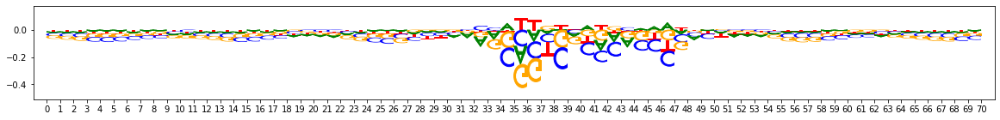

Task 0 actual importance scores:


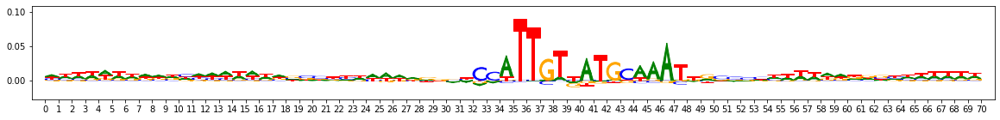

onehot, fwd and rev:


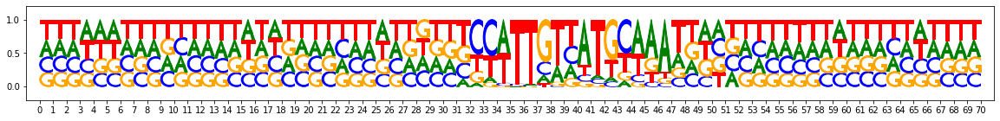

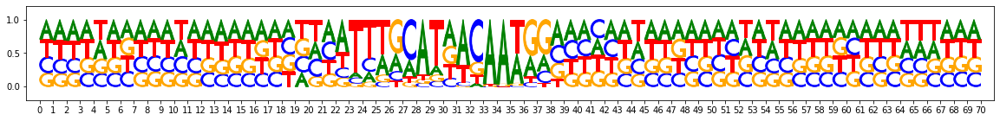

metacluster_0 pattern_1
total seqlets: 8933
Task 0 hypothetical scores:


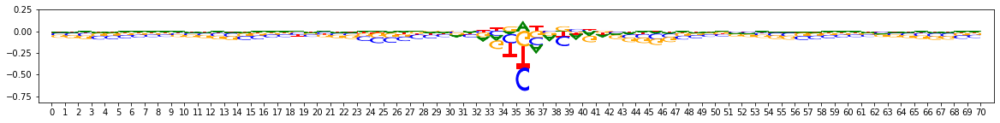

Task 0 actual importance scores:


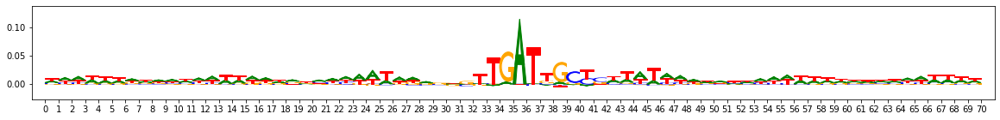

onehot, fwd and rev:


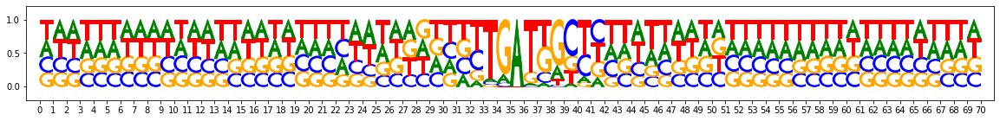

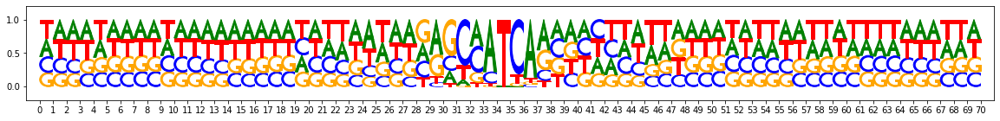

metacluster_0 pattern_2
total seqlets: 2069
Task 0 hypothetical scores:


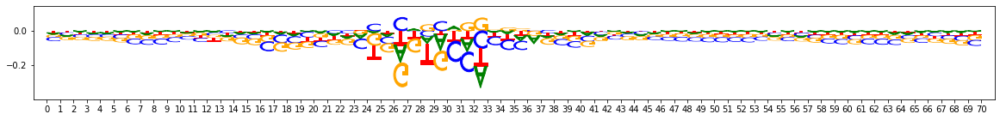

Task 0 actual importance scores:


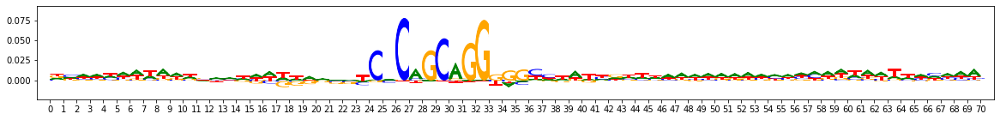

onehot, fwd and rev:


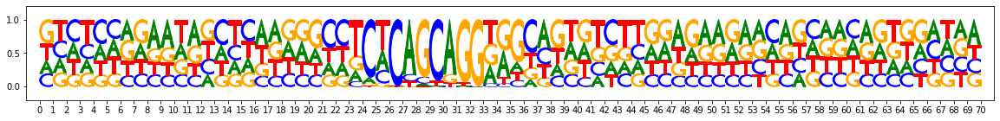

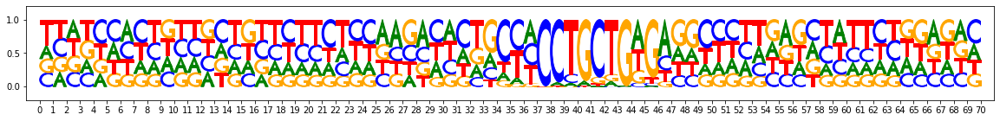

metacluster_0 pattern_3
total seqlets: 1712
Task 0 hypothetical scores:


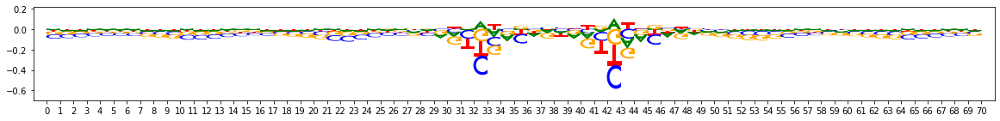

Task 0 actual importance scores:


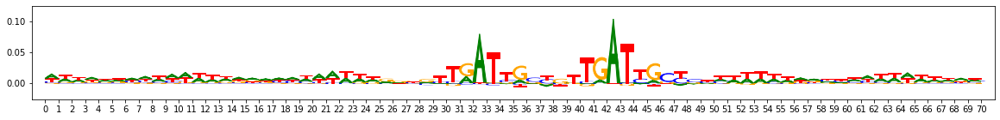

onehot, fwd and rev:


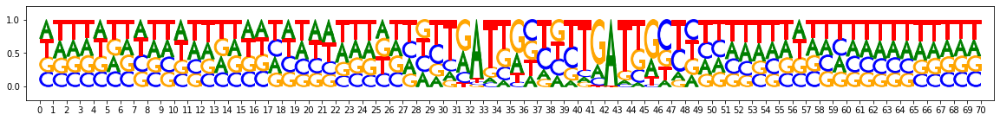

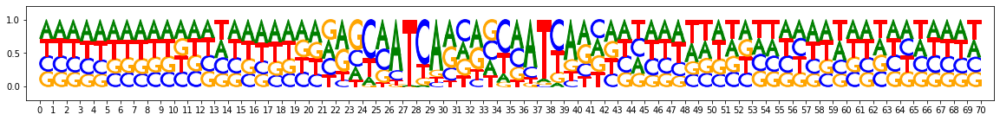

metacluster_0 pattern_4
total seqlets: 1600
Task 0 hypothetical scores:


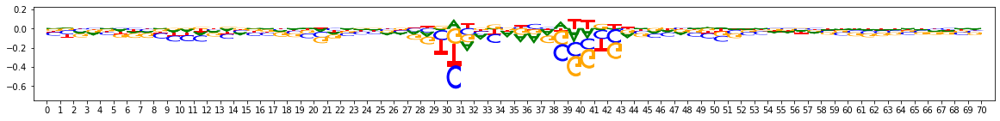

Task 0 actual importance scores:


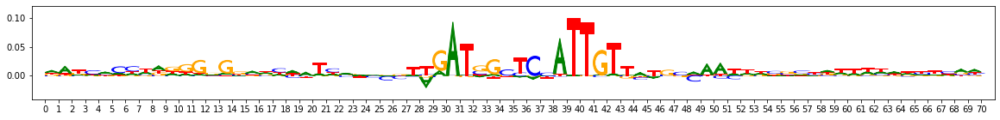

onehot, fwd and rev:


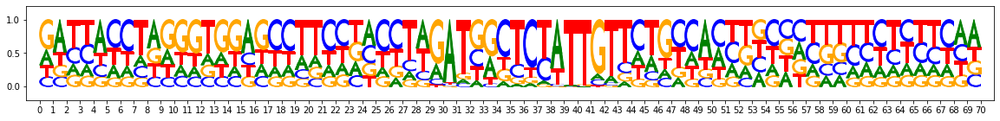

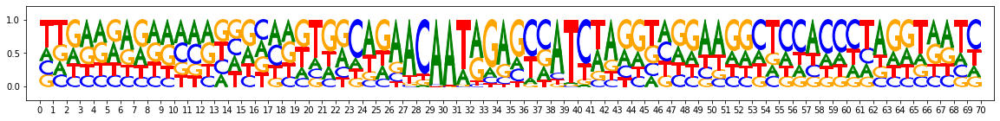

metacluster_0 pattern_5
total seqlets: 1184
Task 0 hypothetical scores:


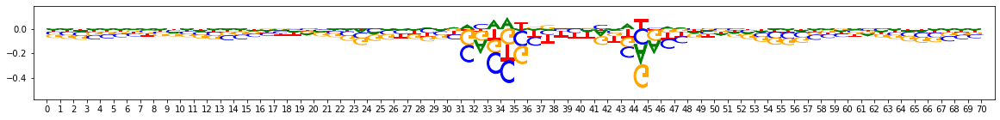

Task 0 actual importance scores:


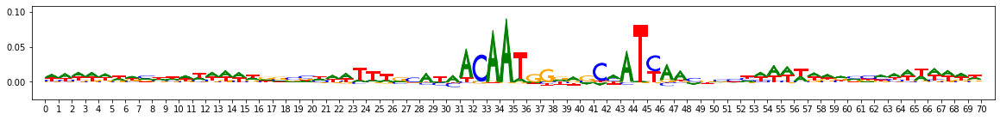

onehot, fwd and rev:


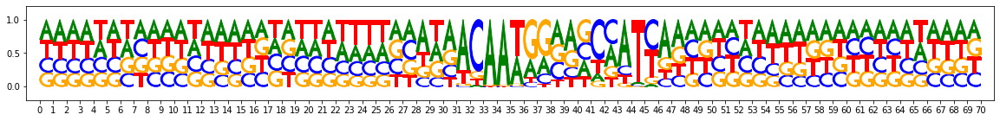

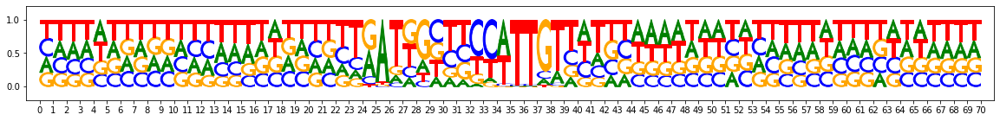

metacluster_0 pattern_6
total seqlets: 1106
Task 0 hypothetical scores:


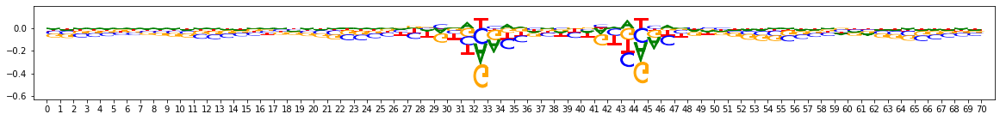

Task 0 actual importance scores:


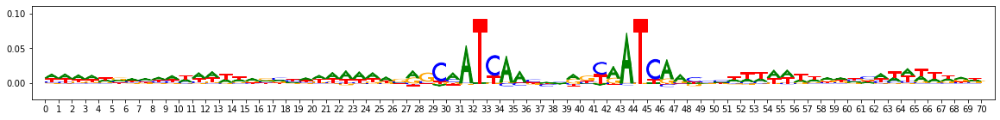

onehot, fwd and rev:


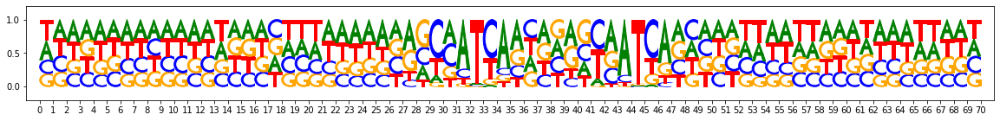

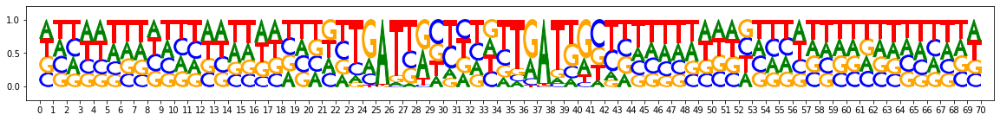

metacluster_0 pattern_7
total seqlets: 1044
Task 0 hypothetical scores:


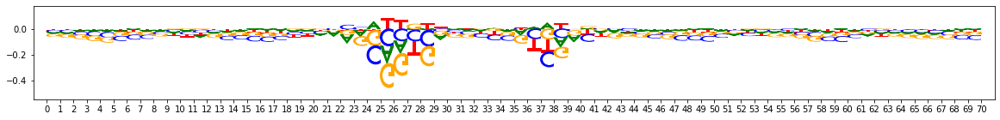

Task 0 actual importance scores:


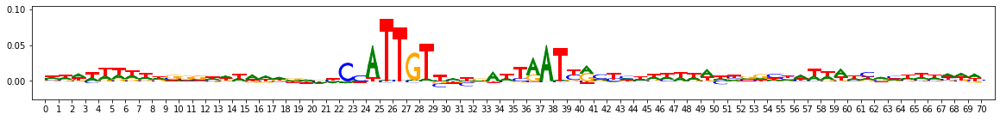

onehot, fwd and rev:


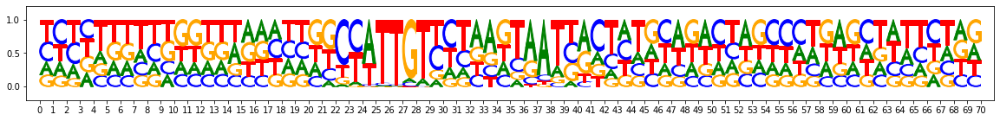

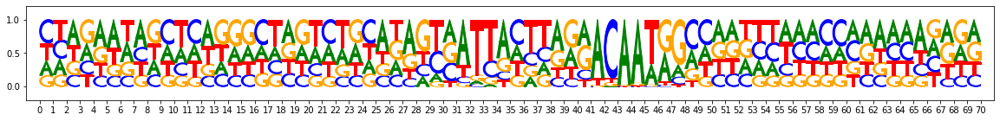

metacluster_0 pattern_8
total seqlets: 961
Task 0 hypothetical scores:


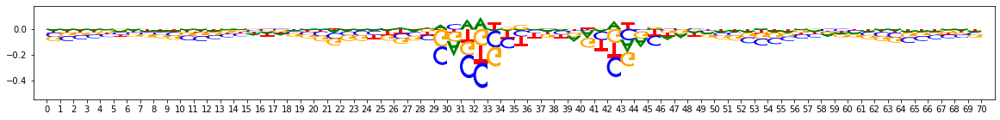

Task 0 actual importance scores:


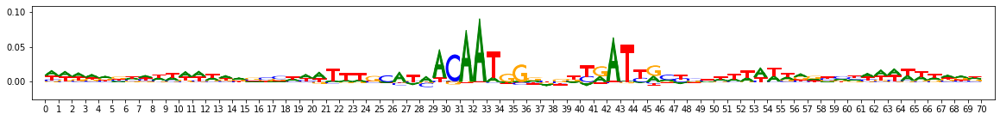

onehot, fwd and rev:


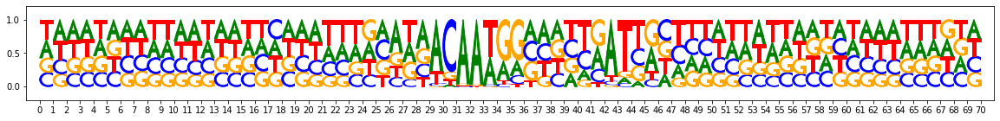

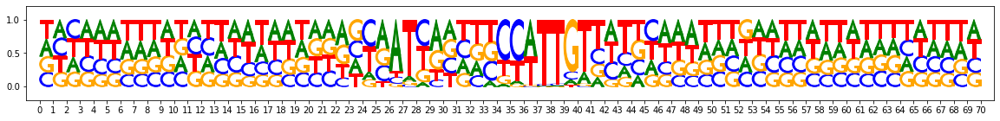

metacluster_0 pattern_9
total seqlets: 901
Task 0 hypothetical scores:


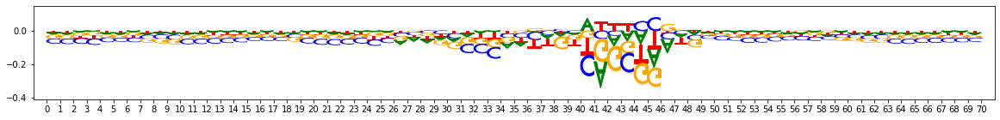

Task 0 actual importance scores:


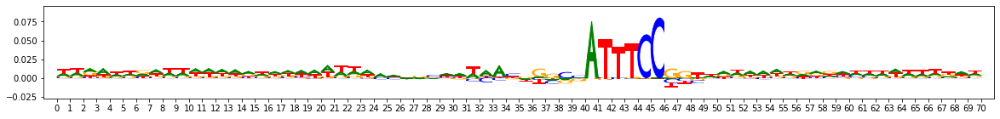

onehot, fwd and rev:


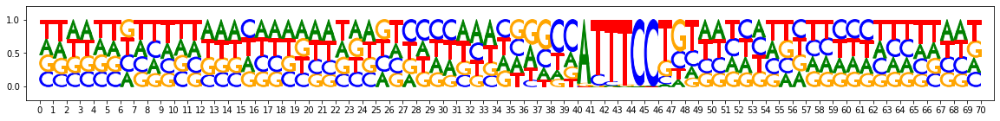

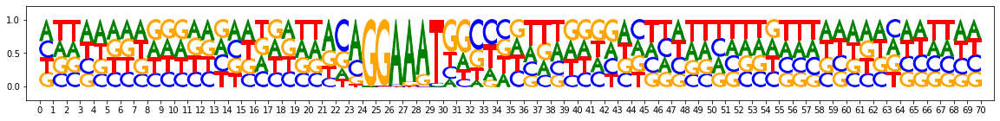

metacluster_0 pattern_10
total seqlets: 684
Task 0 hypothetical scores:


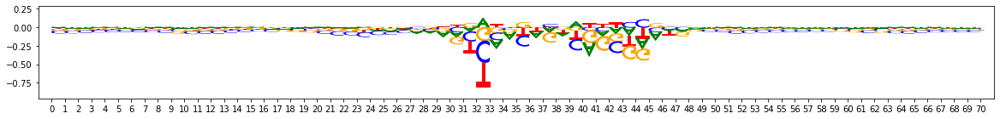

Task 0 actual importance scores:


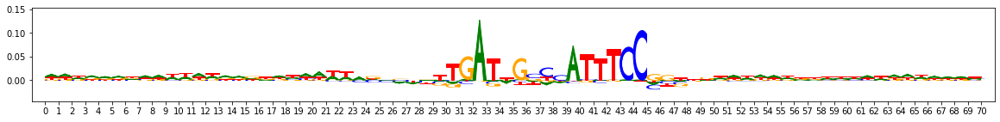

onehot, fwd and rev:


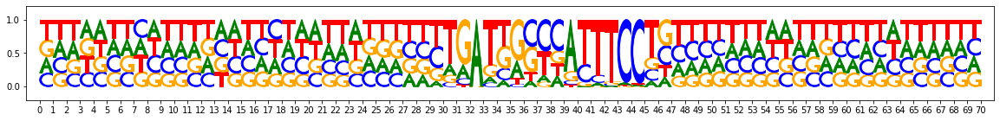

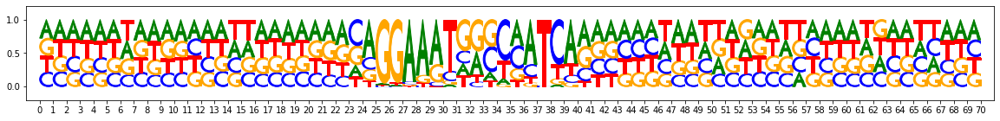

metacluster_0 pattern_11
total seqlets: 477
Task 0 hypothetical scores:


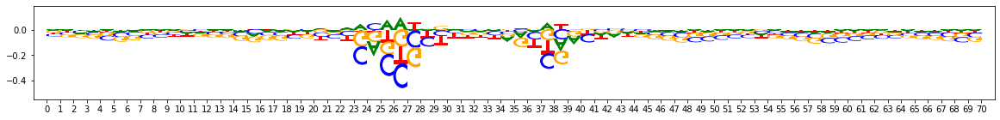

Task 0 actual importance scores:


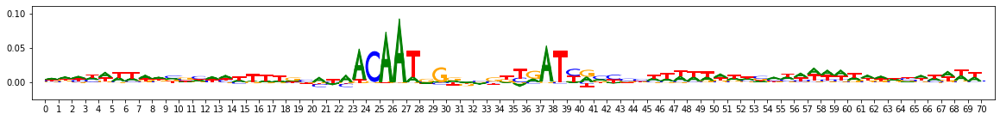

onehot, fwd and rev:


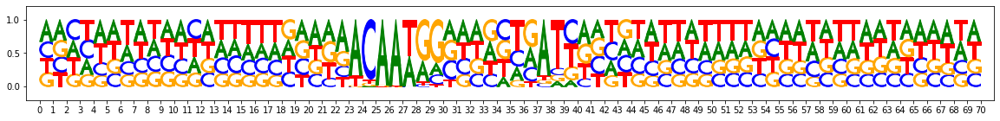

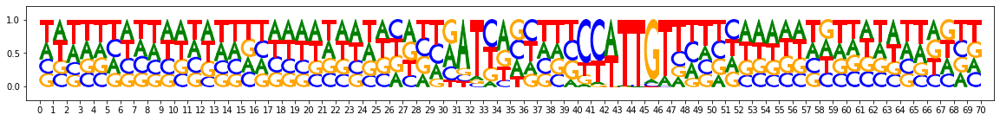

metacluster_0 pattern_12
total seqlets: 469
Task 0 hypothetical scores:


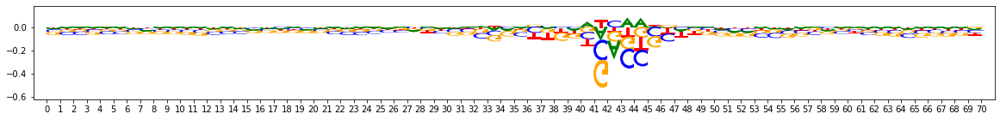

Task 0 actual importance scores:


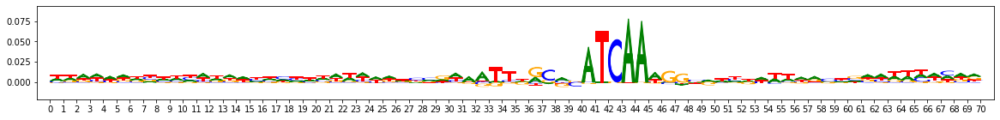

onehot, fwd and rev:


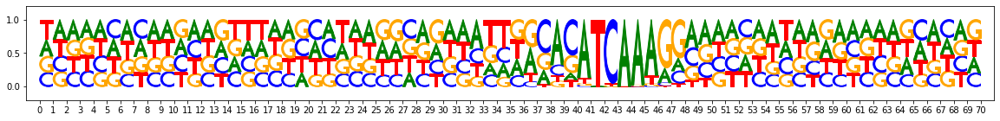

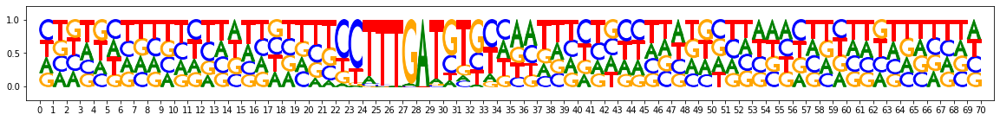

metacluster_0 pattern_13
total seqlets: 438
Task 0 hypothetical scores:


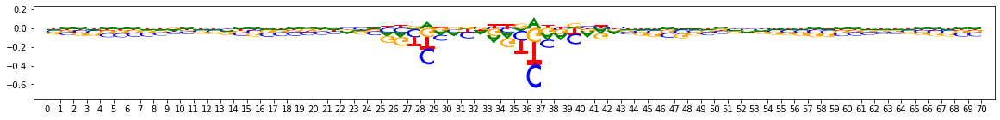

Task 0 actual importance scores:


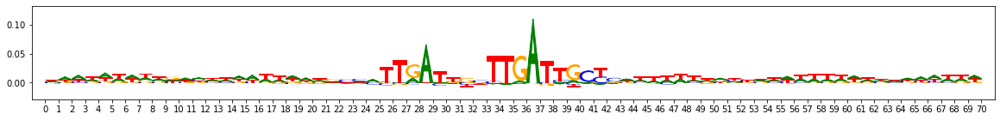

onehot, fwd and rev:


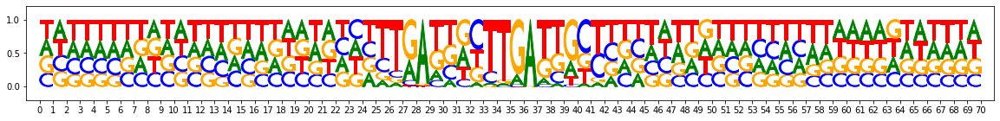

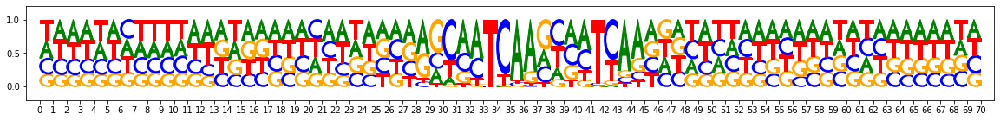

metacluster_0 pattern_14
total seqlets: 386
Task 0 hypothetical scores:


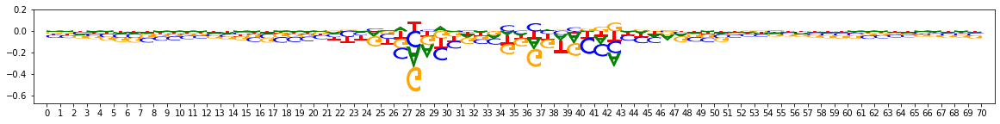

Task 0 actual importance scores:


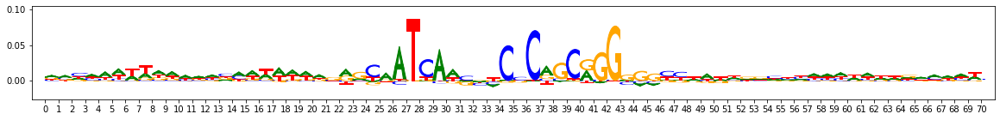

onehot, fwd and rev:


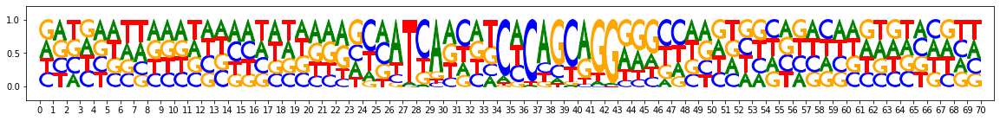

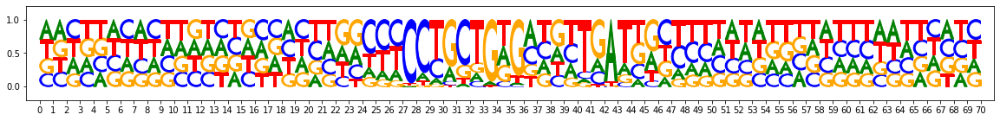

metacluster_0 pattern_15
total seqlets: 391
Task 0 hypothetical scores:


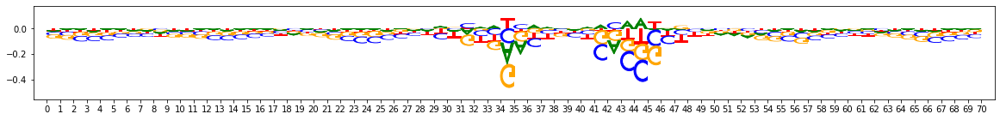

Task 0 actual importance scores:


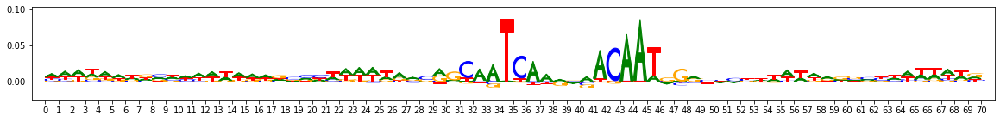

onehot, fwd and rev:


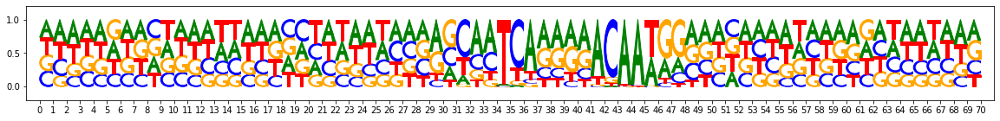

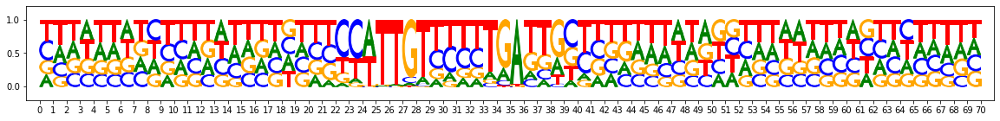

metacluster_0 pattern_16
total seqlets: 348
Task 0 hypothetical scores:


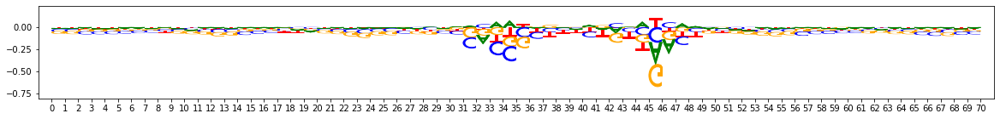

Task 0 actual importance scores:


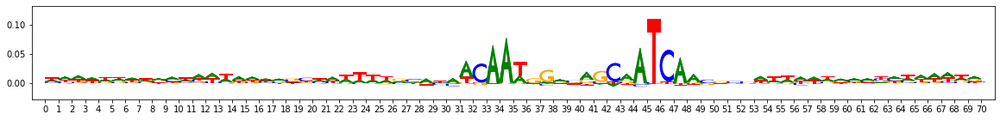

onehot, fwd and rev:


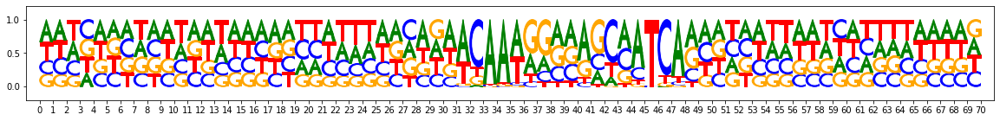

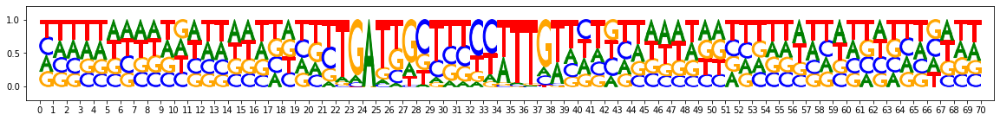

metacluster_0 pattern_17
total seqlets: 340
Task 0 hypothetical scores:


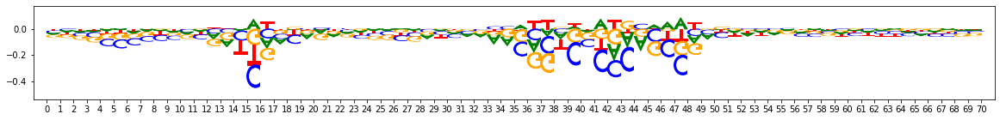

Task 0 actual importance scores:


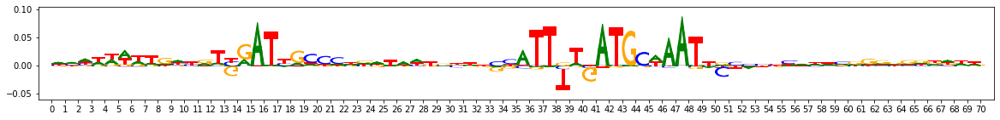

onehot, fwd and rev:


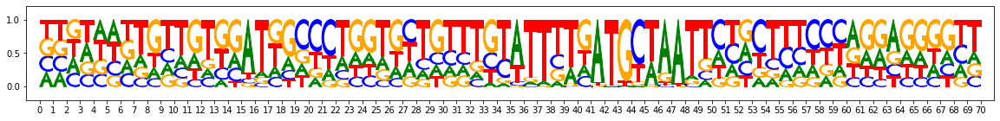

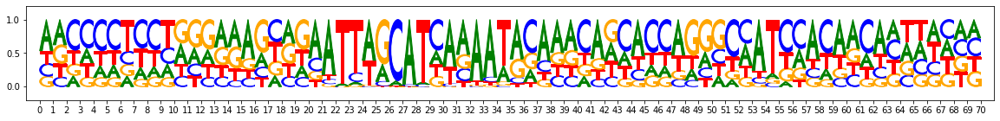

metacluster_0 pattern_18
total seqlets: 308
Task 0 hypothetical scores:


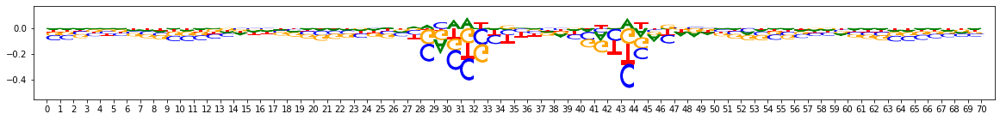

Task 0 actual importance scores:


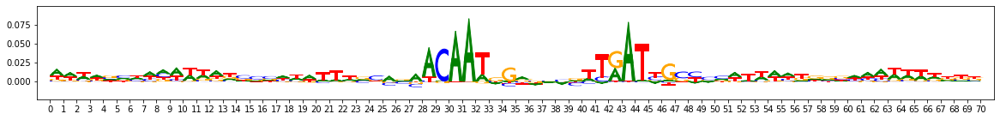

onehot, fwd and rev:


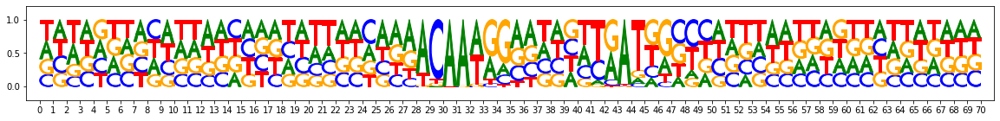

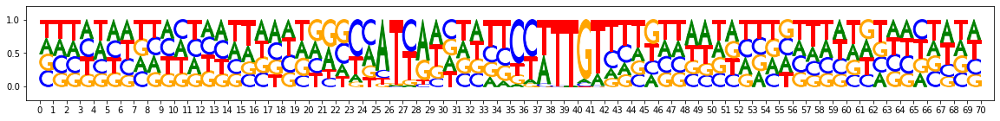

metacluster_0 pattern_19
total seqlets: 307
Task 0 hypothetical scores:


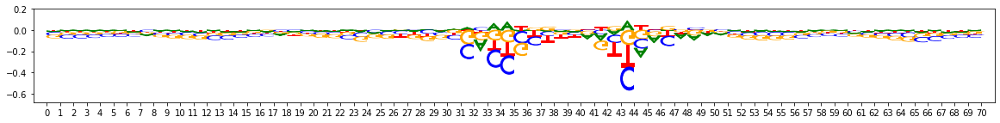

Task 0 actual importance scores:


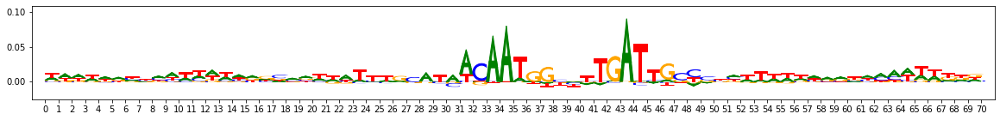

onehot, fwd and rev:


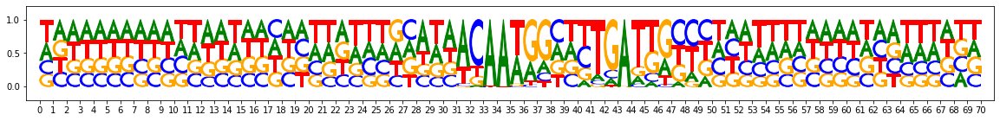

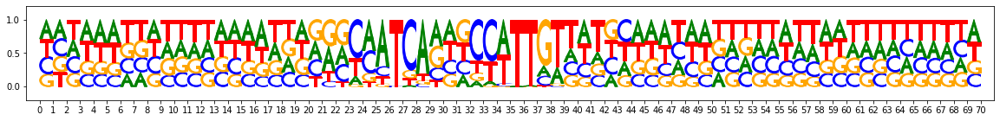

metacluster_0 pattern_20
total seqlets: 281
Task 0 hypothetical scores:


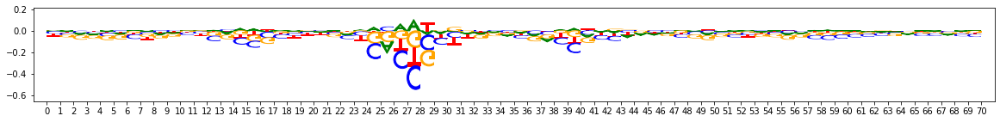

Task 0 actual importance scores:


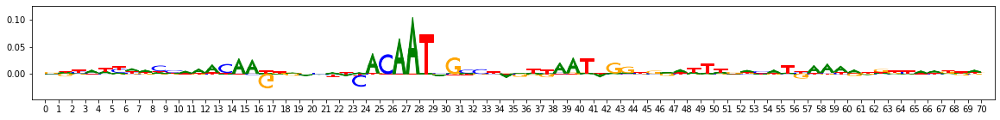

onehot, fwd and rev:


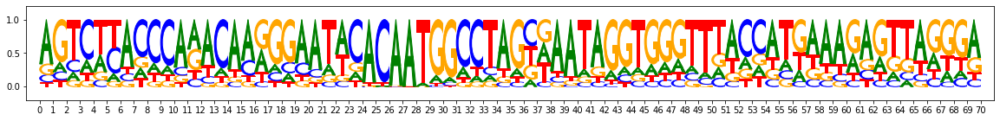

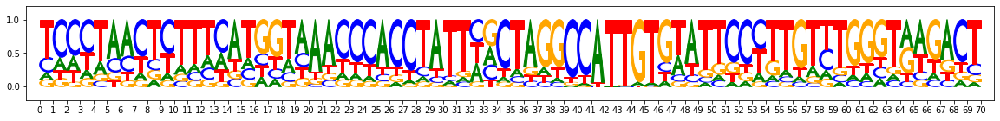

metacluster_0 pattern_21
total seqlets: 300
Task 0 hypothetical scores:


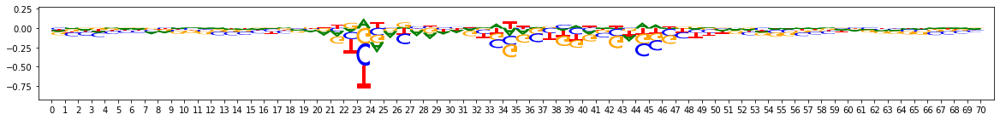

Task 0 actual importance scores:


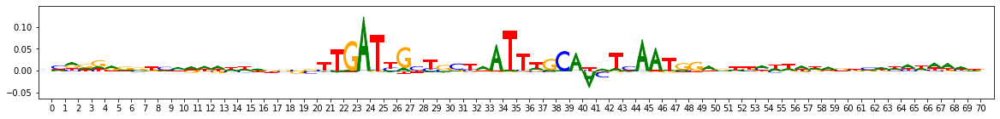

onehot, fwd and rev:


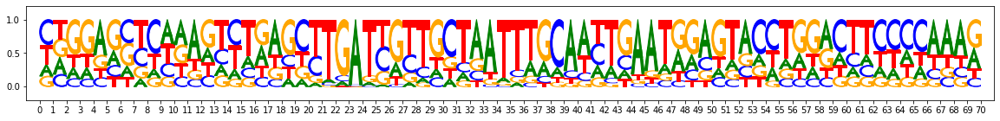

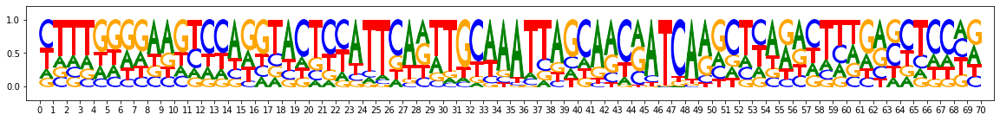

metacluster_0 pattern_22
total seqlets: 227
Task 0 hypothetical scores:


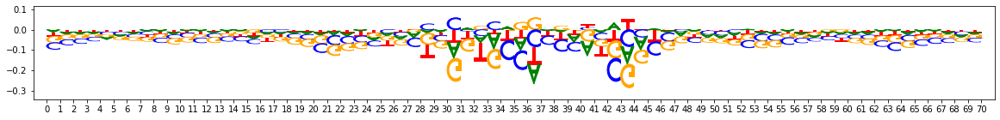

Task 0 actual importance scores:


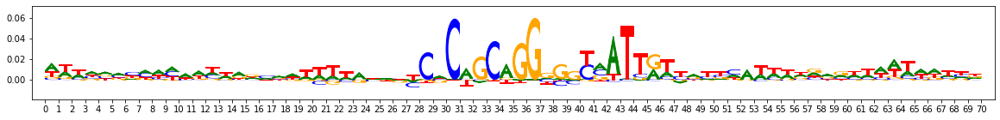

onehot, fwd and rev:


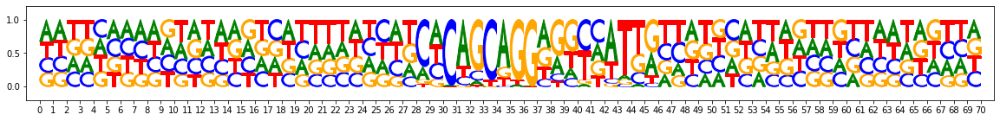

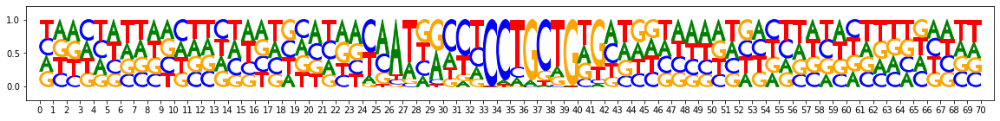

metacluster_0 pattern_23
total seqlets: 195
Task 0 hypothetical scores:


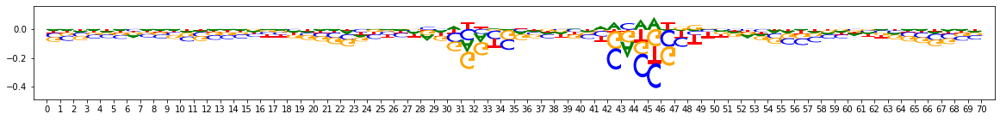

Task 0 actual importance scores:


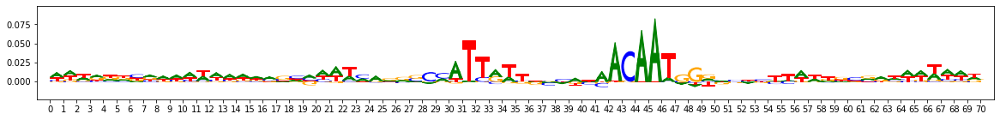

onehot, fwd and rev:


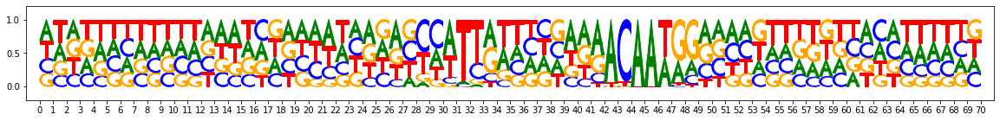

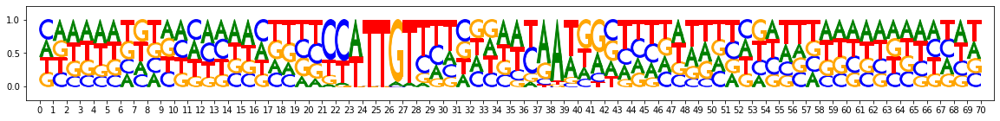

metacluster_0 pattern_24
total seqlets: 179
Task 0 hypothetical scores:


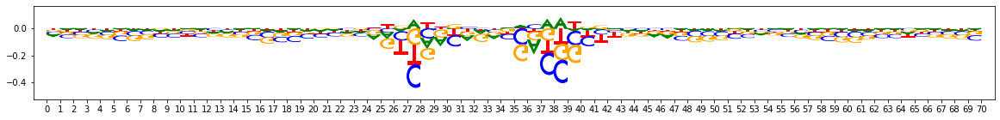

Task 0 actual importance scores:


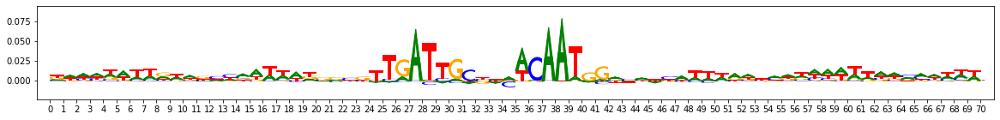

onehot, fwd and rev:


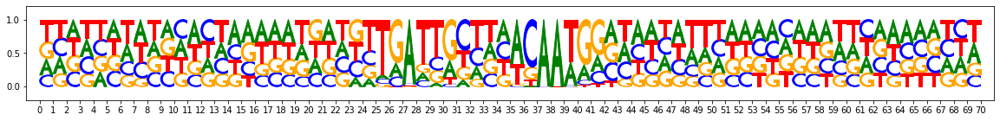

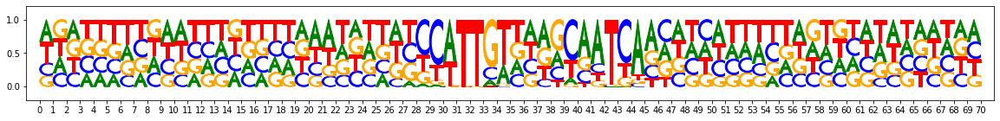

metacluster_0 pattern_25
total seqlets: 160
Task 0 hypothetical scores:


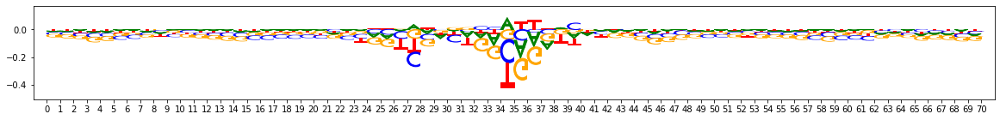

Task 0 actual importance scores:


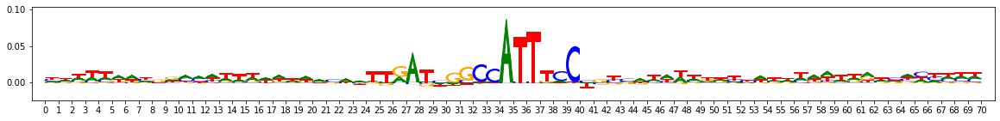

onehot, fwd and rev:


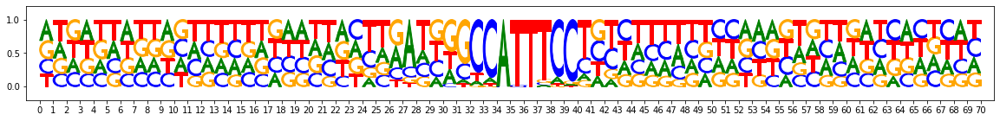

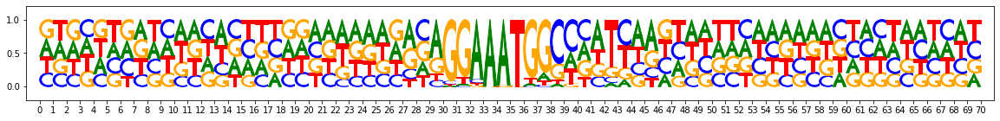

metacluster_0 pattern_26
total seqlets: 150
Task 0 hypothetical scores:


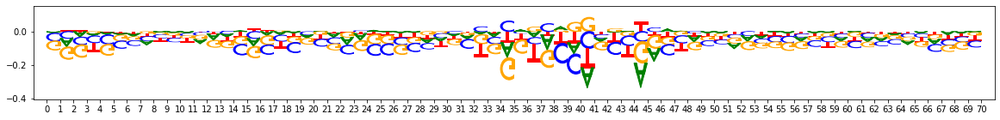

Task 0 actual importance scores:


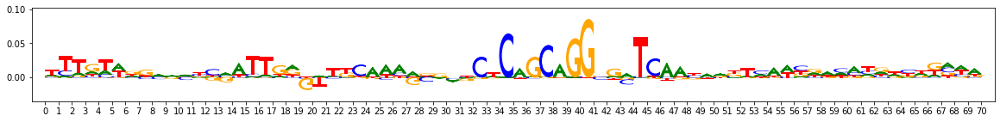

onehot, fwd and rev:


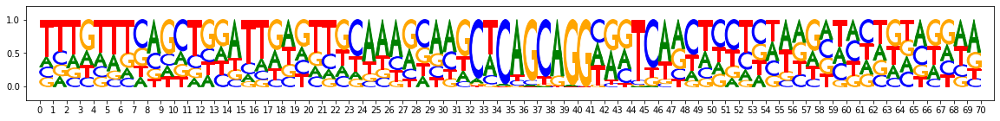

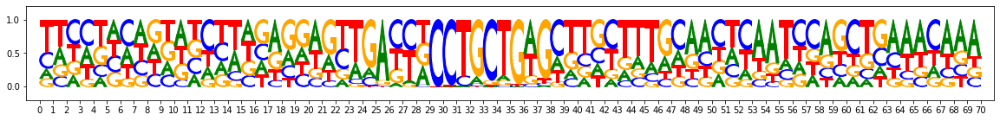

metacluster_0 pattern_27
total seqlets: 172
Task 0 hypothetical scores:


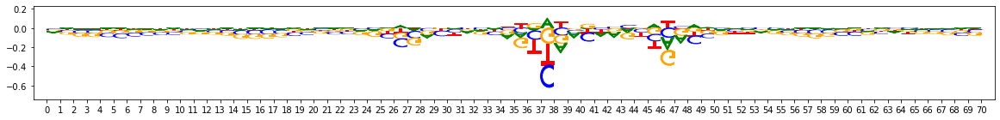

Task 0 actual importance scores:


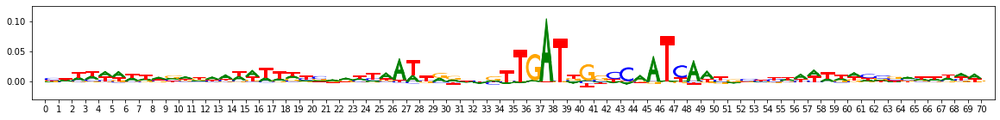

onehot, fwd and rev:


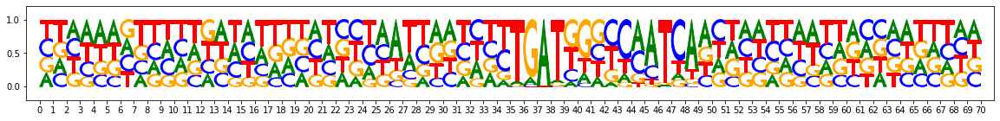

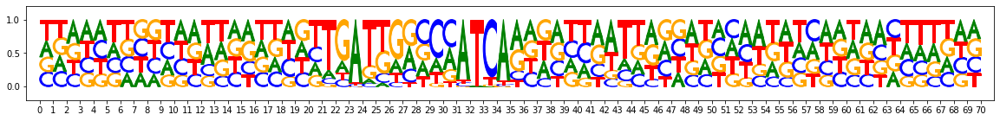

metacluster_0 pattern_28
total seqlets: 143
Task 0 hypothetical scores:


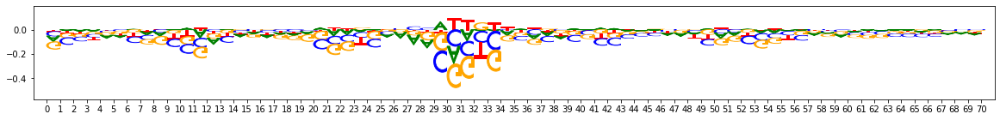

Task 0 actual importance scores:


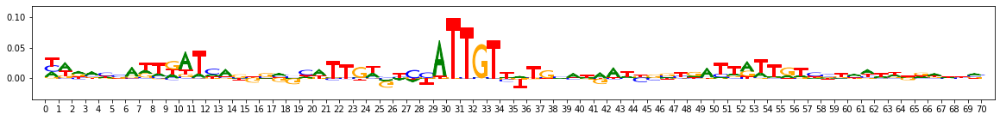

onehot, fwd and rev:


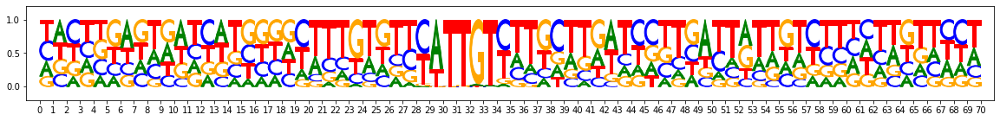

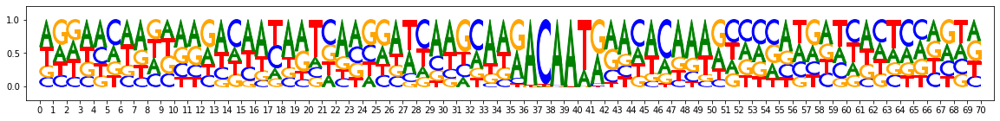

metacluster_0 pattern_29
total seqlets: 137
Task 0 hypothetical scores:


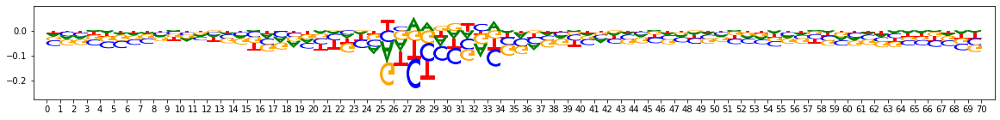

Task 0 actual importance scores:


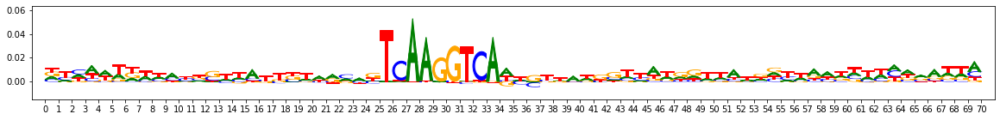

onehot, fwd and rev:


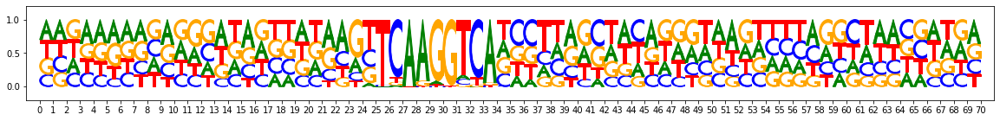

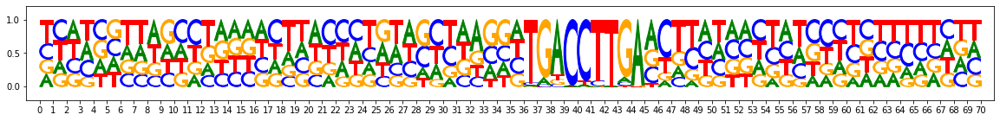

metacluster_0 pattern_30
total seqlets: 127
Task 0 hypothetical scores:


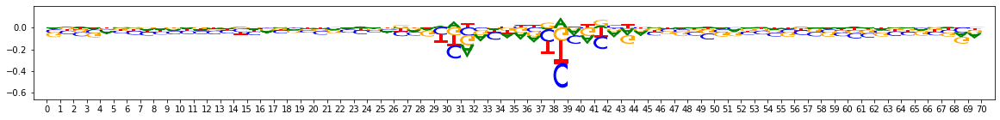

Task 0 actual importance scores:


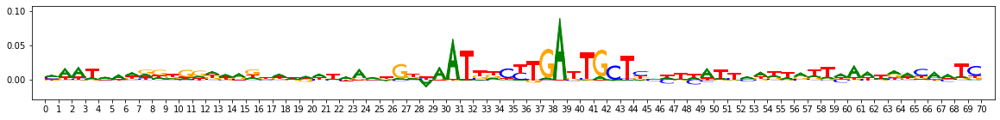

onehot, fwd and rev:


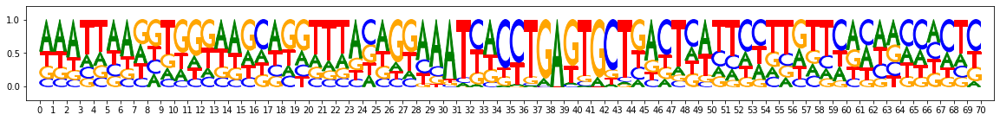

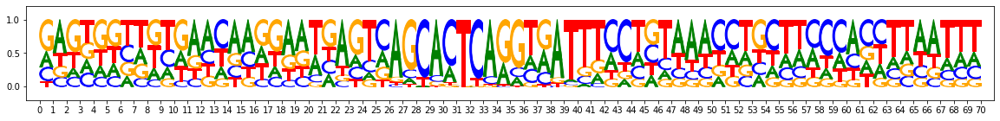

metacluster_0 pattern_31
total seqlets: 147
Task 0 hypothetical scores:


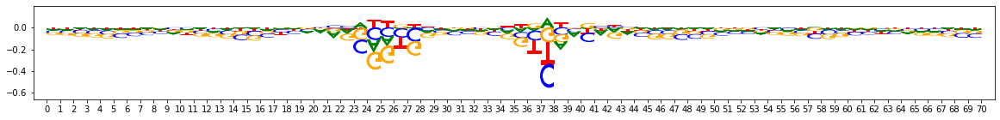

Task 0 actual importance scores:


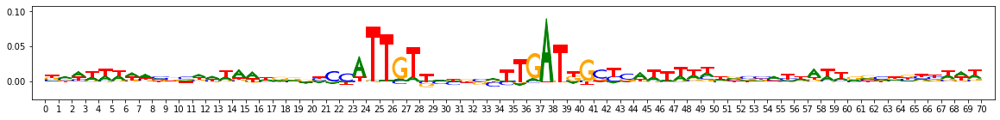

onehot, fwd and rev:


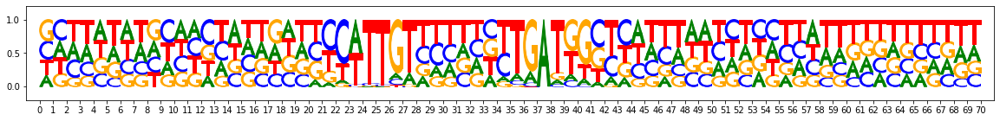

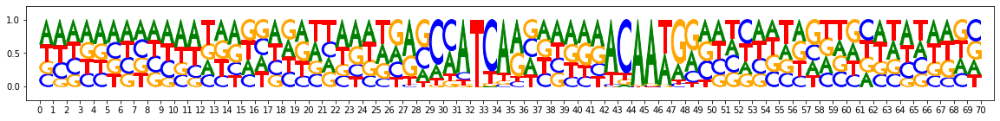

metacluster_0 pattern_32
total seqlets: 132
Task 0 hypothetical scores:


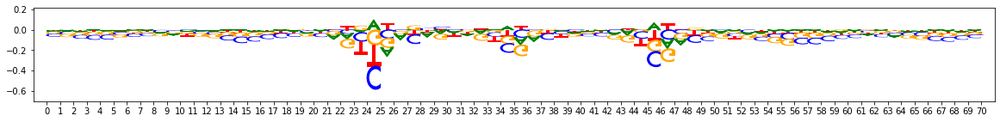

Task 0 actual importance scores:


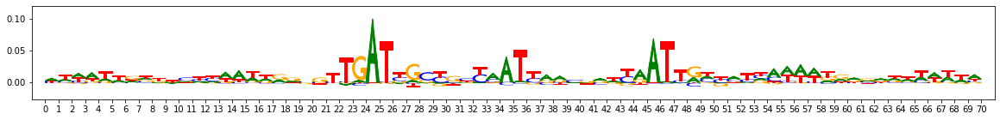

onehot, fwd and rev:


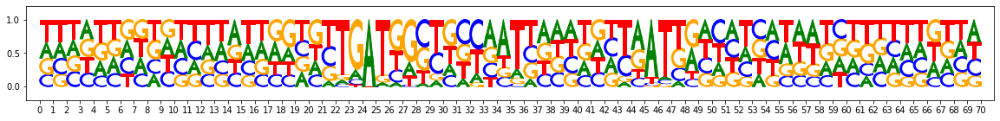

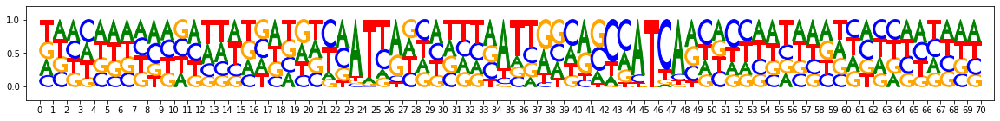

metacluster_0 pattern_33
total seqlets: 116
Task 0 hypothetical scores:


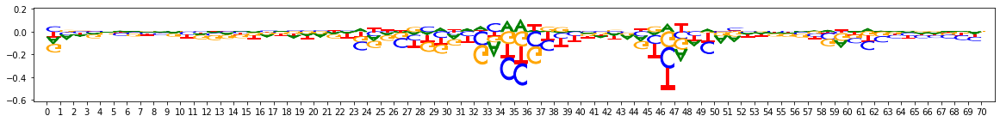

Task 0 actual importance scores:


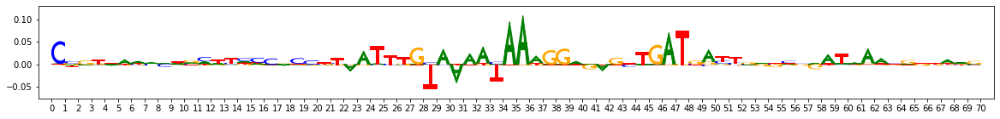

onehot, fwd and rev:


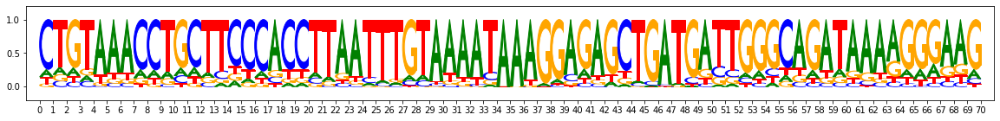

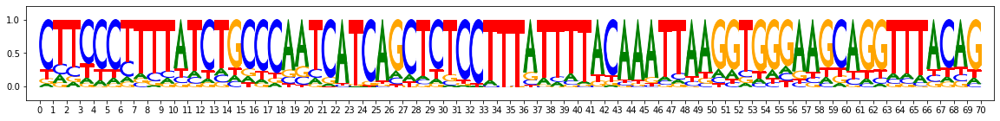

metacluster_0 pattern_34
total seqlets: 117
Task 0 hypothetical scores:


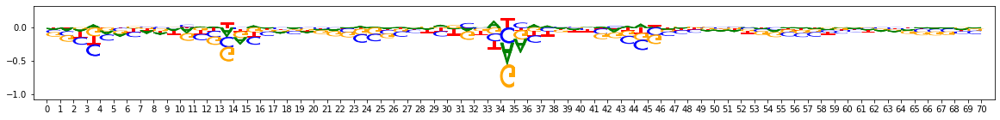

Task 0 actual importance scores:


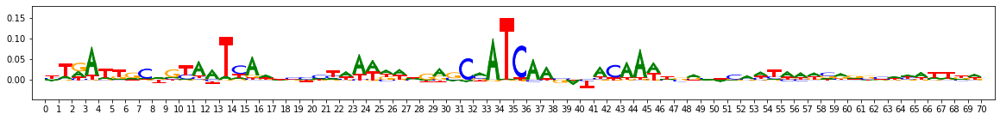

onehot, fwd and rev:


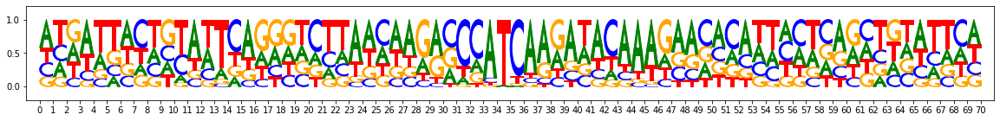

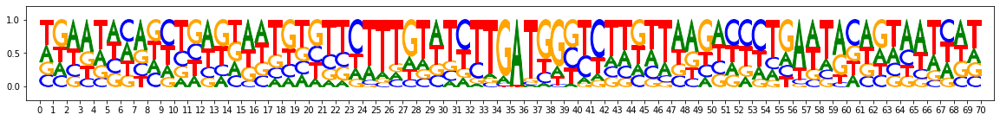

metacluster_0 pattern_35
total seqlets: 109
Task 0 hypothetical scores:


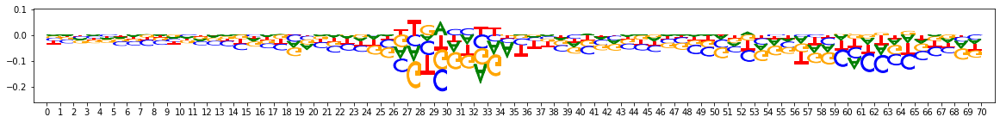

Task 0 actual importance scores:


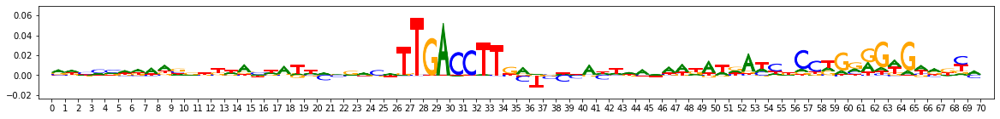

onehot, fwd and rev:


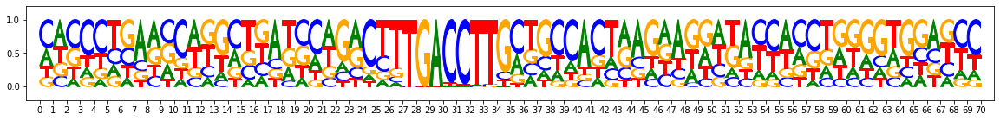

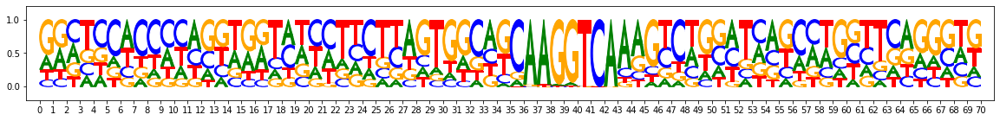

metacluster_0 pattern_36
total seqlets: 125
Task 0 hypothetical scores:


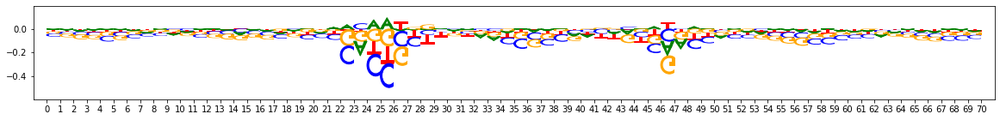

Task 0 actual importance scores:


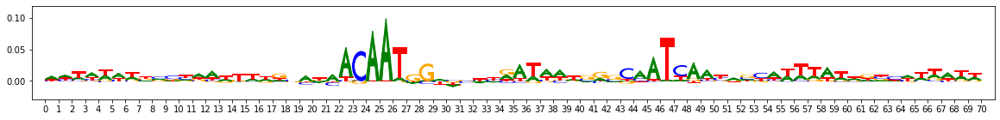

onehot, fwd and rev:


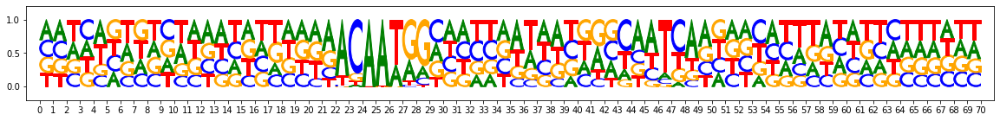

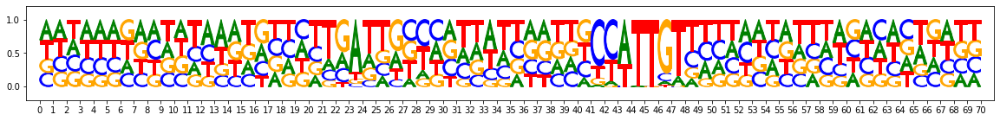

metacluster_0 pattern_37
total seqlets: 114
Task 0 hypothetical scores:


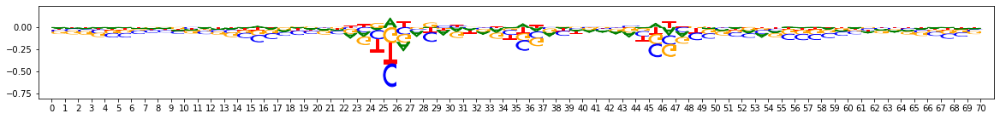

Task 0 actual importance scores:


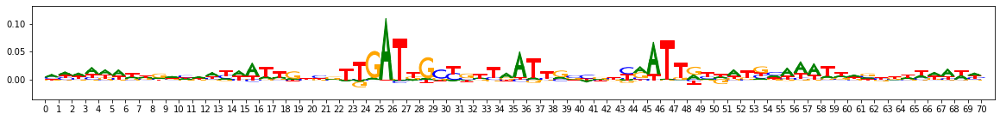

onehot, fwd and rev:


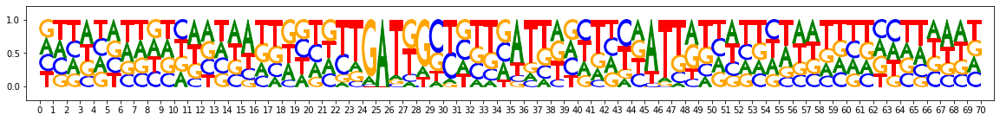

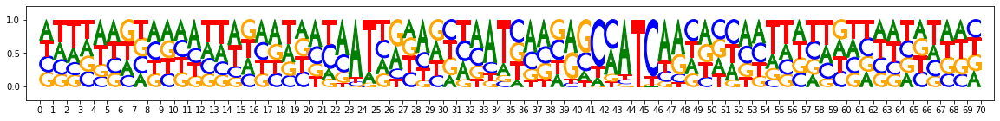

metacluster_0 pattern_38
total seqlets: 103
Task 0 hypothetical scores:


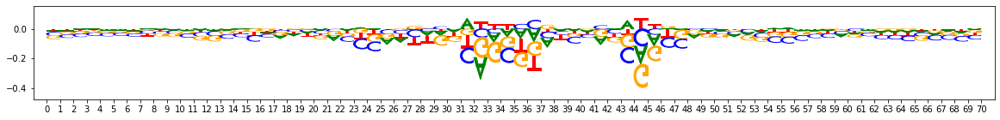

Task 0 actual importance scores:


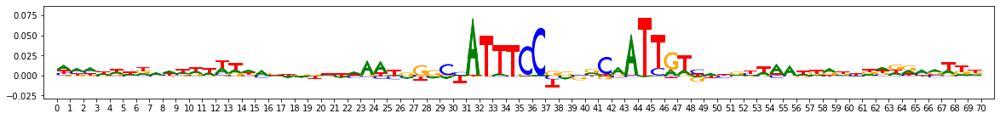

onehot, fwd and rev:


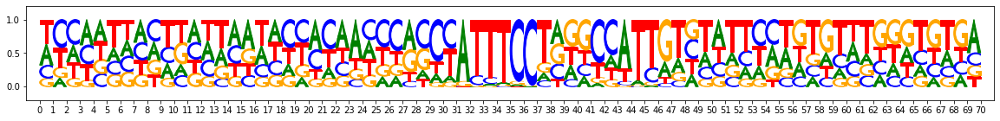

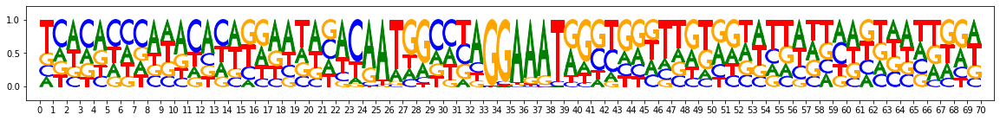

metacluster_0 pattern_39
total seqlets: 122
Task 0 hypothetical scores:


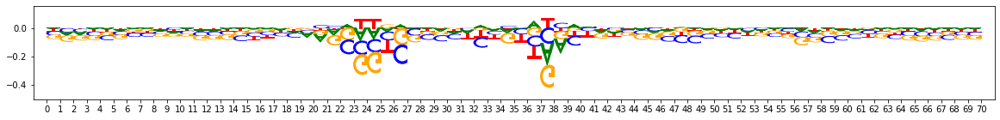

Task 0 actual importance scores:


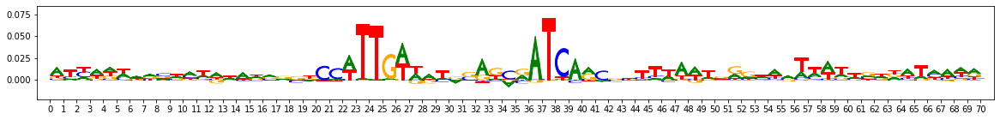

onehot, fwd and rev:


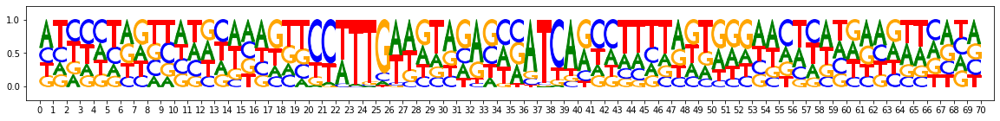

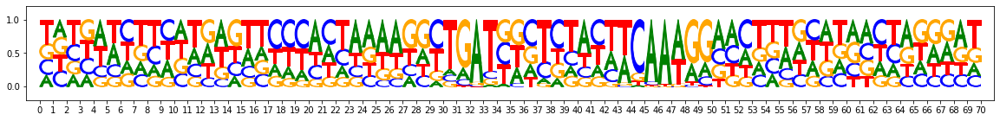

metacluster_0 pattern_40
total seqlets: 92
Task 0 hypothetical scores:


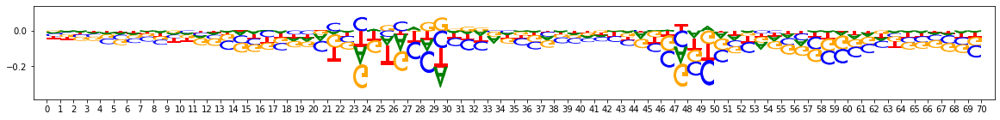

Task 0 actual importance scores:


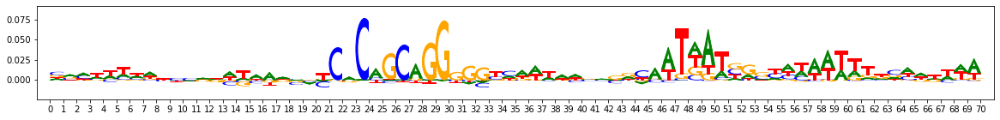

onehot, fwd and rev:


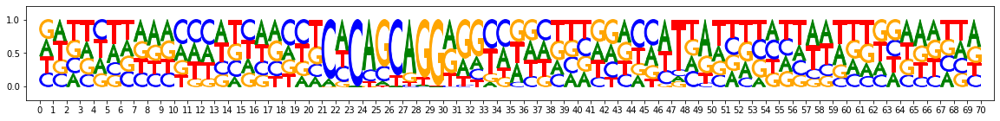

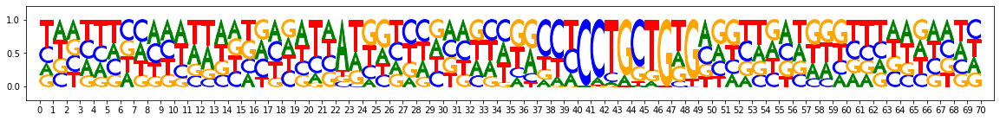

metacluster_0 pattern_41
total seqlets: 100
Task 0 hypothetical scores:


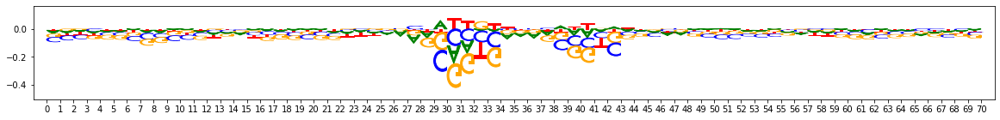

Task 0 actual importance scores:


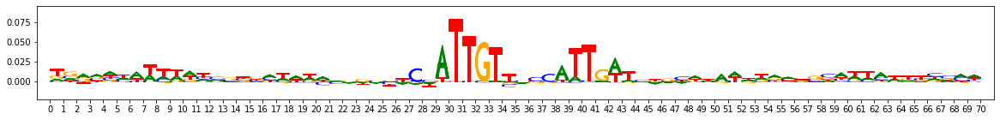

onehot, fwd and rev:


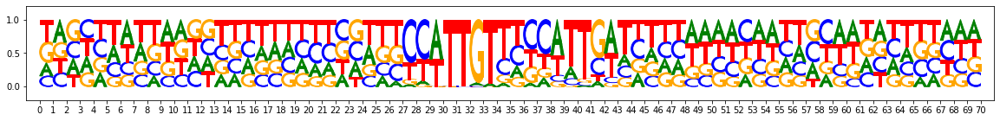

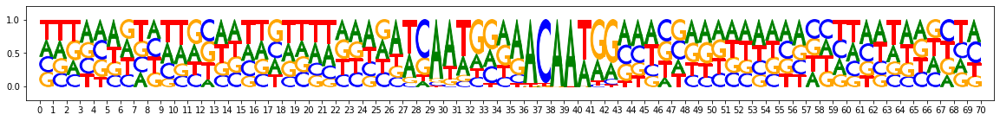

metacluster_0 pattern_42
total seqlets: 109
Task 0 hypothetical scores:


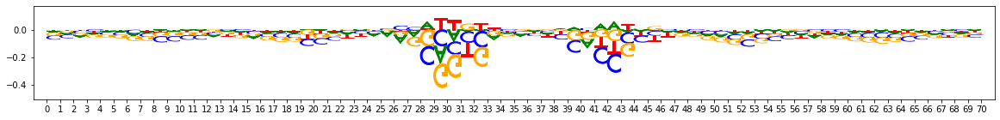

Task 0 actual importance scores:


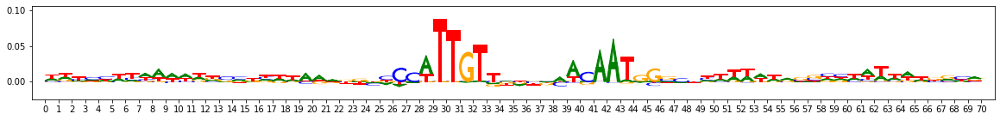

onehot, fwd and rev:


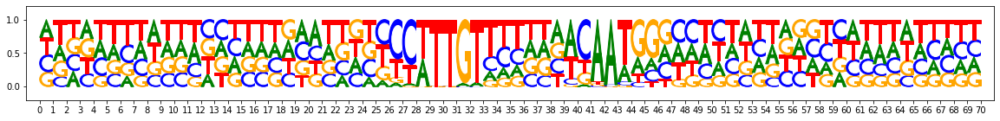

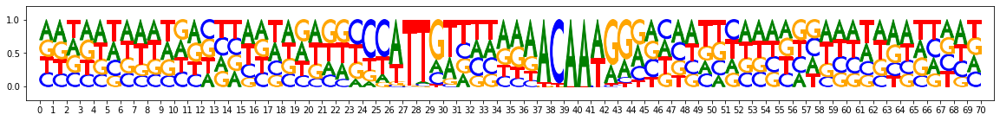

metacluster_0 pattern_43
total seqlets: 115
Task 0 hypothetical scores:


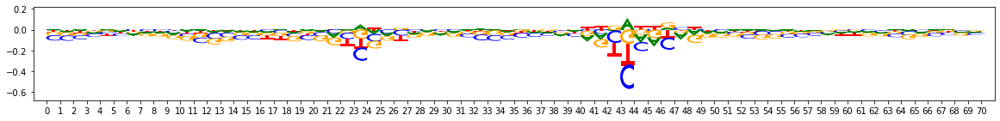

Task 0 actual importance scores:


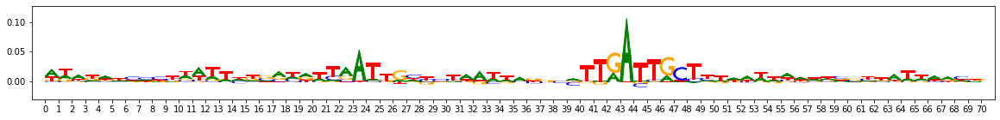

onehot, fwd and rev:


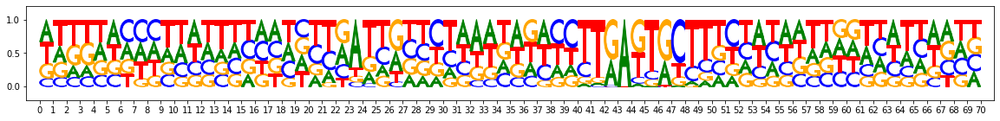

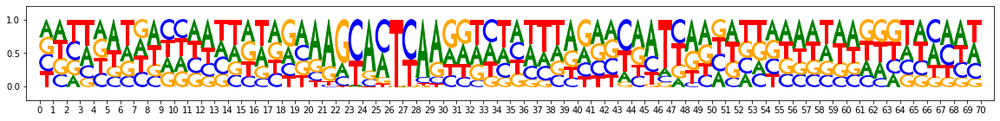

metacluster_0 pattern_44
total seqlets: 122
Task 0 hypothetical scores:


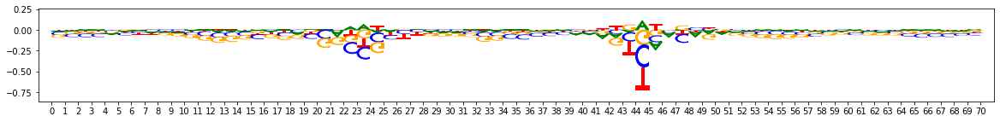

Task 0 actual importance scores:


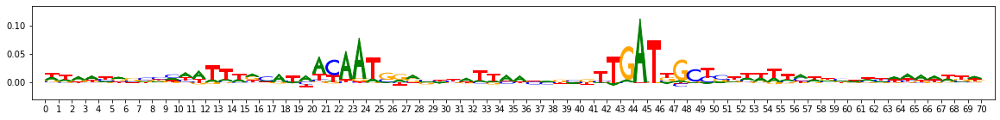

onehot, fwd and rev:


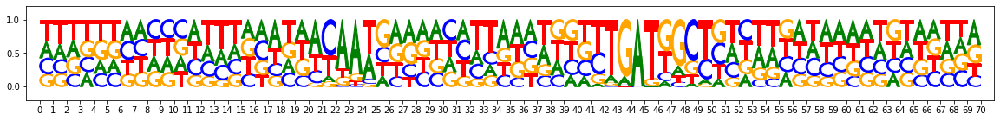

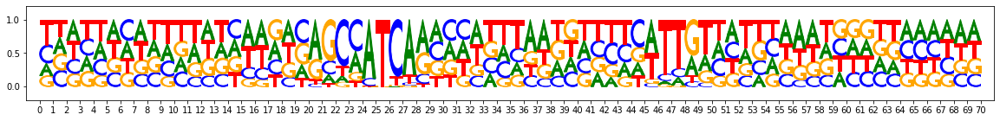

metacluster_0 pattern_45
total seqlets: 88
Task 0 hypothetical scores:


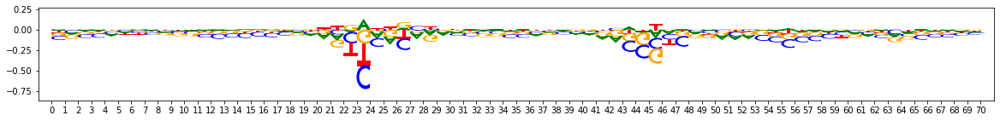

Task 0 actual importance scores:


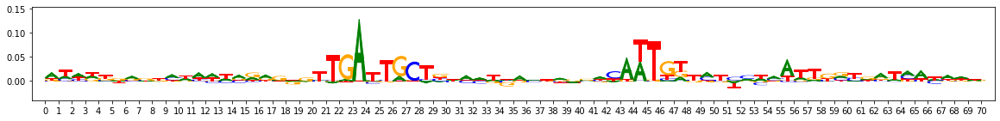

onehot, fwd and rev:


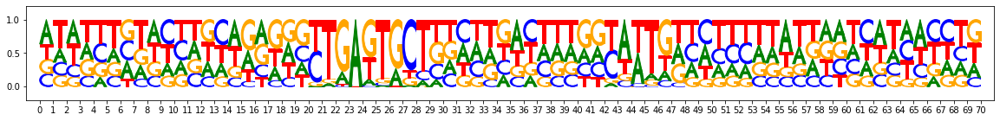

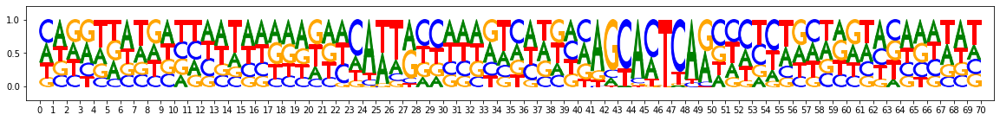

metacluster_0 pattern_46
total seqlets: 84
Task 0 hypothetical scores:


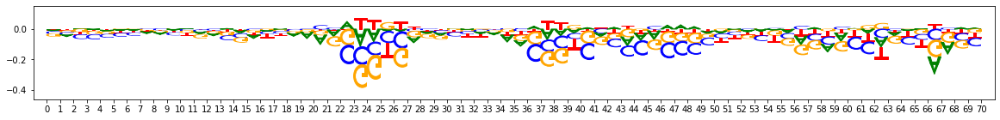

Task 0 actual importance scores:


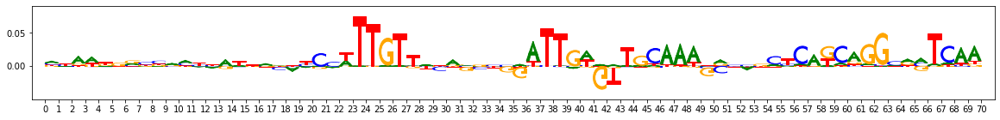

onehot, fwd and rev:


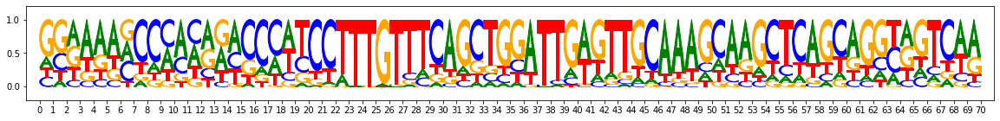

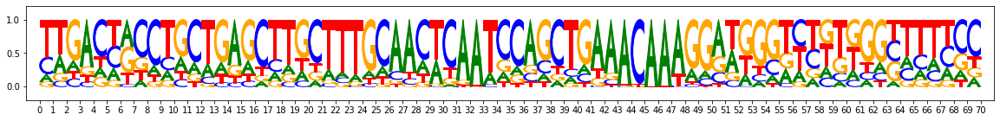

metacluster_0 pattern_47
total seqlets: 103
Task 0 hypothetical scores:


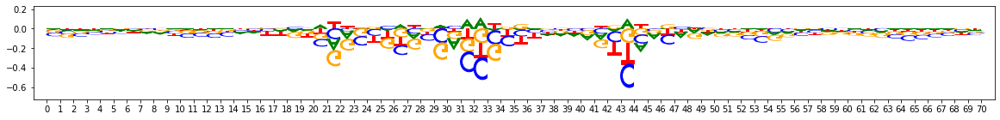

Task 0 actual importance scores:


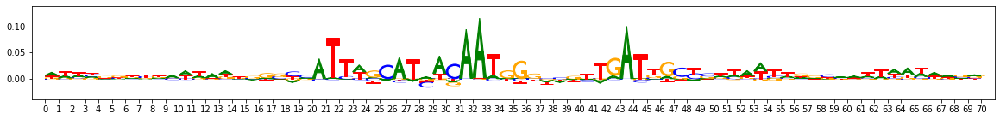

onehot, fwd and rev:


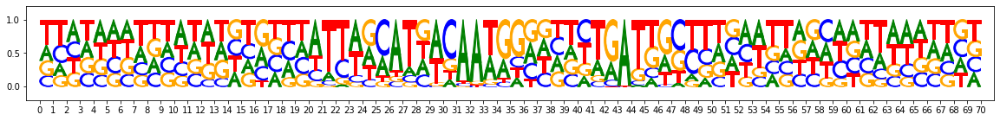

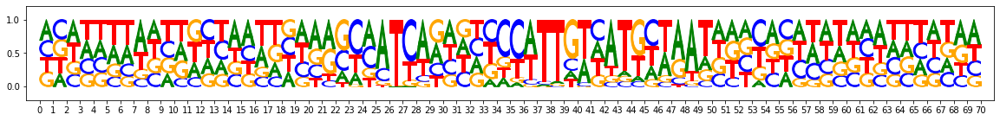

metacluster_0 pattern_48
total seqlets: 91
Task 0 hypothetical scores:


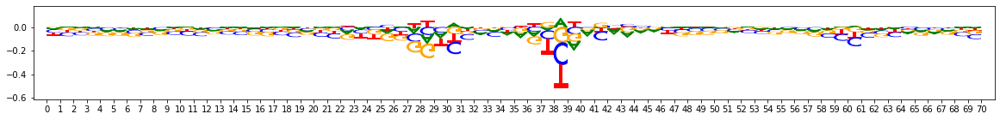

Task 0 actual importance scores:


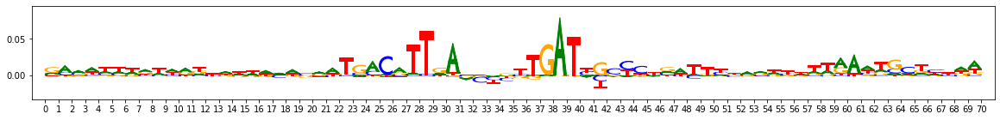

onehot, fwd and rev:


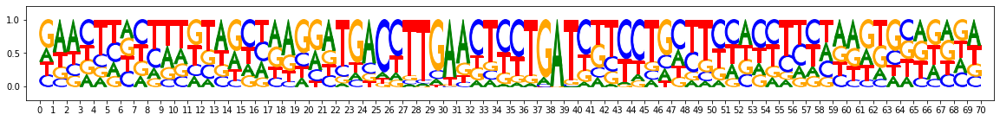

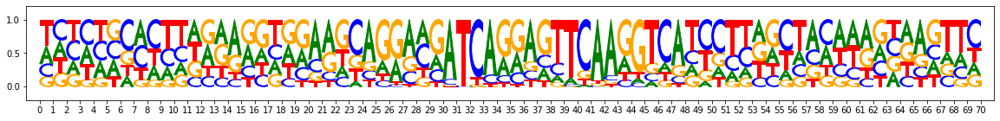

metacluster_0 pattern_49
total seqlets: 107
Task 0 hypothetical scores:


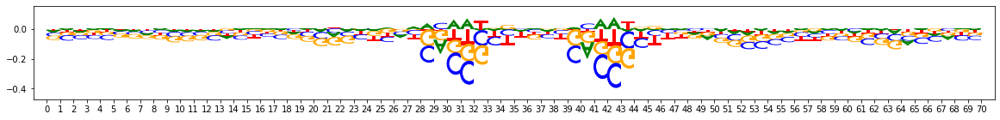

Task 0 actual importance scores:


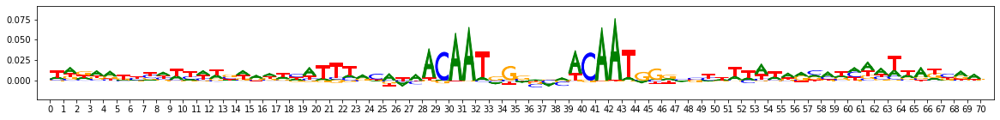

onehot, fwd and rev:


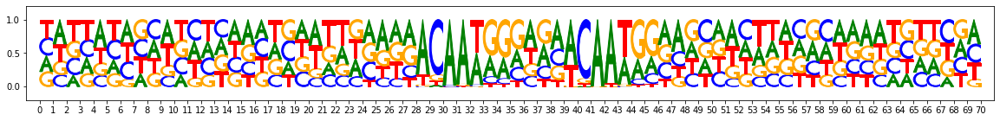

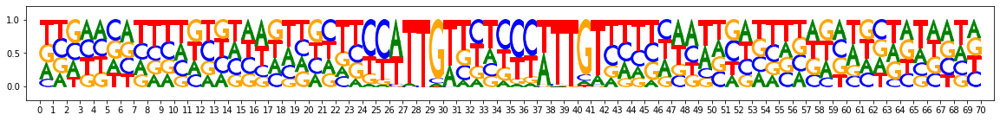

metacluster_0 pattern_50
total seqlets: 80
Task 0 hypothetical scores:


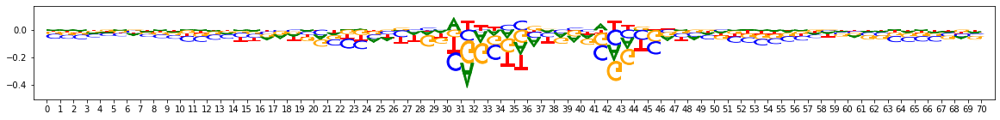

Task 0 actual importance scores:


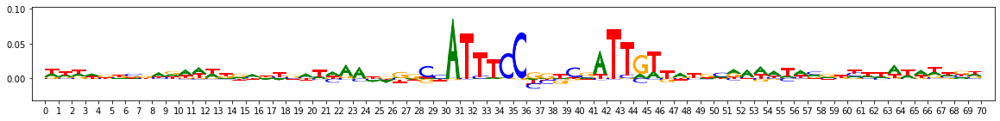

onehot, fwd and rev:


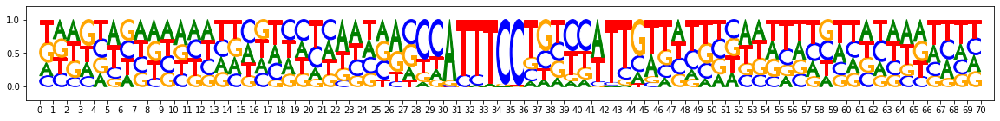

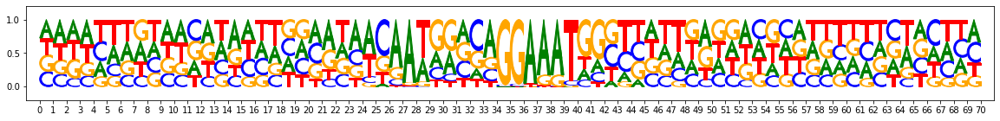

metacluster_0 pattern_51
total seqlets: 101
Task 0 hypothetical scores:


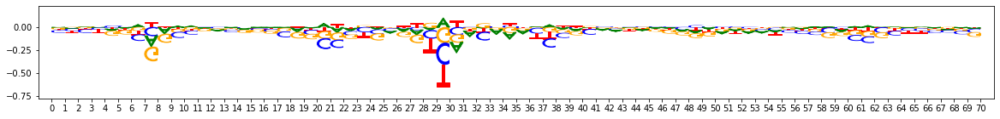

Task 0 actual importance scores:


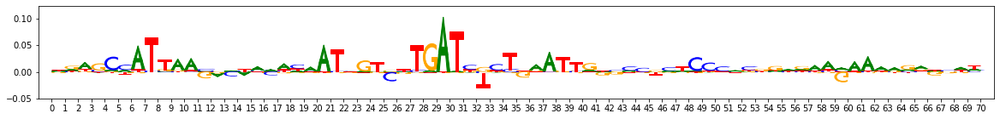

onehot, fwd and rev:


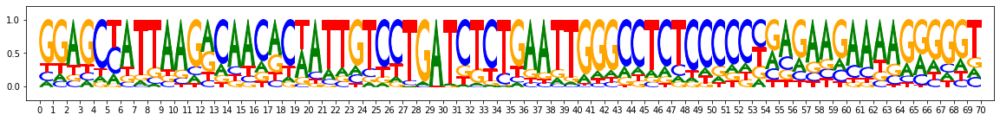

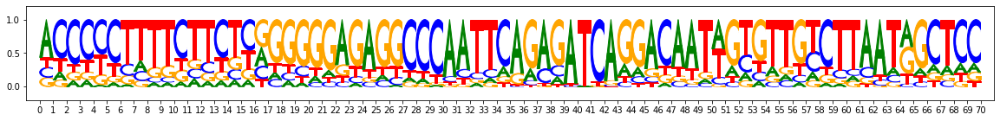

metacluster_0 pattern_52
total seqlets: 102
Task 0 hypothetical scores:


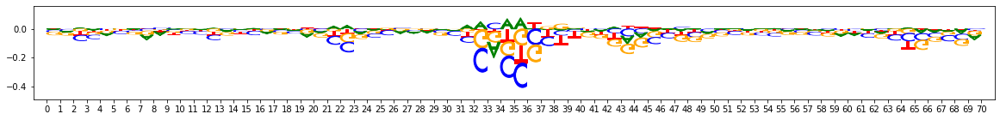

Task 0 actual importance scores:


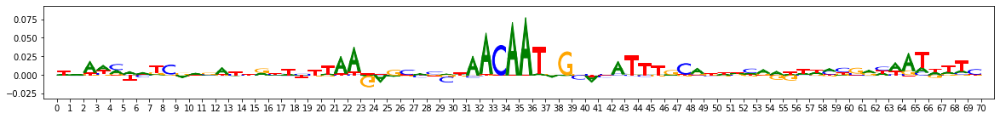

onehot, fwd and rev:


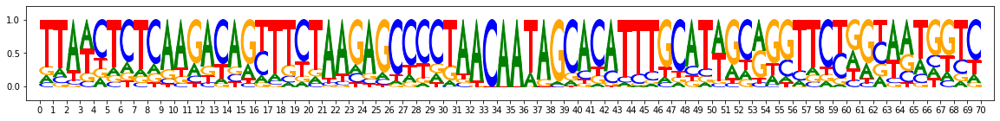

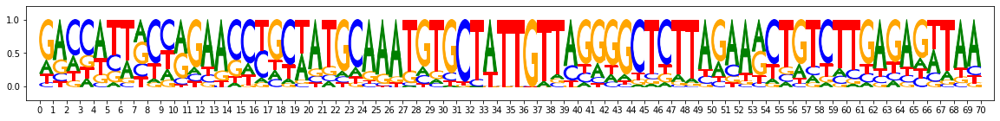

metacluster_0 pattern_53
total seqlets: 91
Task 0 hypothetical scores:


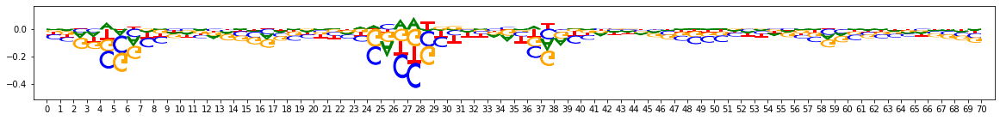

Task 0 actual importance scores:


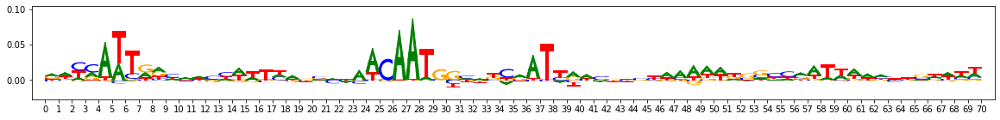

onehot, fwd and rev:


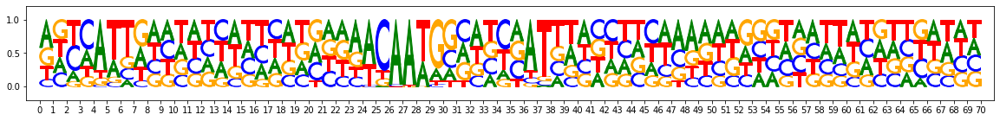

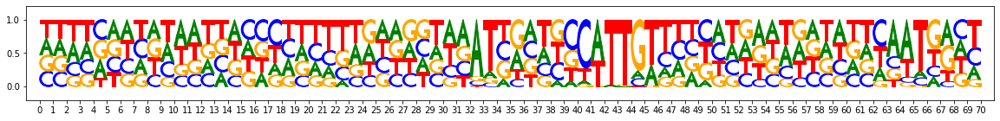

metacluster_0 pattern_54
total seqlets: 80
Task 0 hypothetical scores:


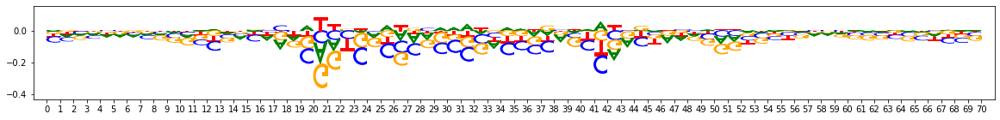

Task 0 actual importance scores:


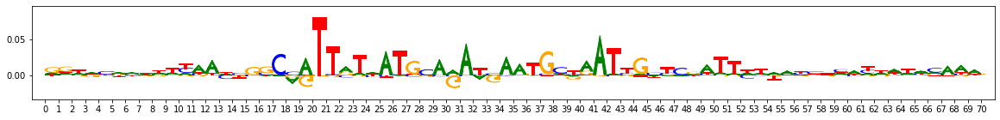

onehot, fwd and rev:


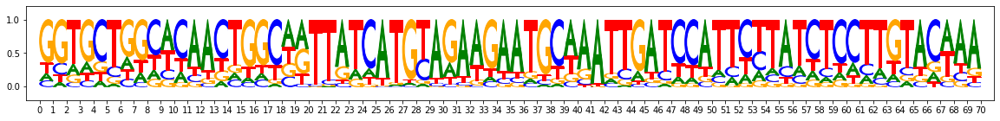

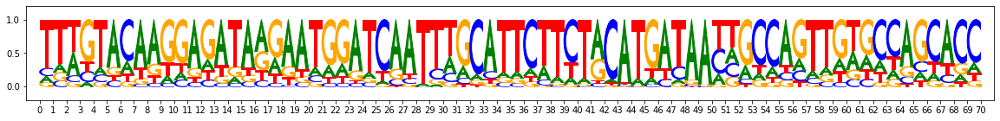

metacluster_0 pattern_55
total seqlets: 109
Task 0 hypothetical scores:


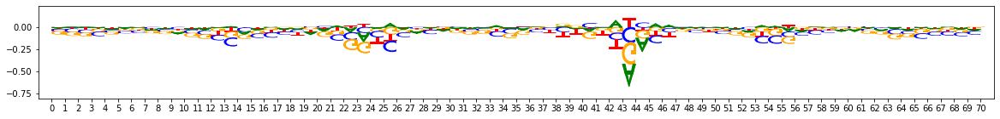

Task 0 actual importance scores:


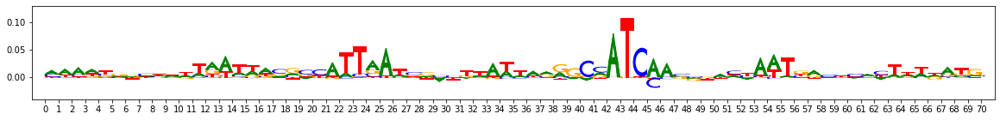

onehot, fwd and rev:


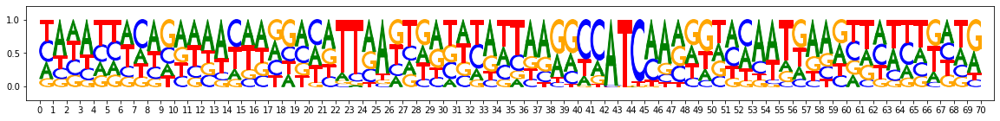

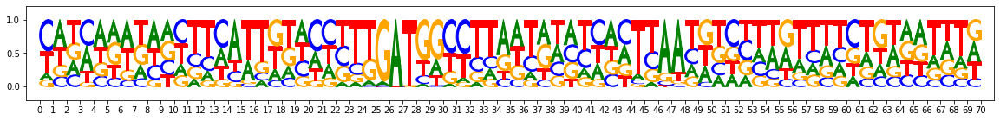

In [8]:
from modisco.visualization import viz_sequence
%matplotlib inline

hdf5_results = h5py.File(file_path,"r")

metacluster_names = [
    x.decode("utf-8") for x in 
    list(hdf5_results["metaclustering_results"]
         ["all_metacluster_names"][:])]

all_patterns = []
background = np.array([0.27, 0.23, 0.23, 0.27])

for metacluster_name in metacluster_names:
    print(metacluster_name)
    metacluster_grp = (hdf5_results["metacluster_idx_to_submetacluster_results"]
                                   [metacluster_name])
    print("activity pattern:",metacluster_grp["activity_pattern"][:])
    all_pattern_names = [x.decode("utf-8") for x in 
                         list(metacluster_grp["seqlets_to_patterns_result"]
                                             ["patterns"]["all_pattern_names"][:])]
    if (len(all_pattern_names)==0):
        print("No motifs found for this activity pattern")
    for pattern_name in all_pattern_names:
        print(metacluster_name, pattern_name)
        all_patterns.append((metacluster_name, pattern_name))
        pattern = metacluster_grp["seqlets_to_patterns_result"]["patterns"][pattern_name]
        print("total seqlets:",len(pattern["seqlets_and_alnmts"]["seqlets"]))
        print("Task 0 hypothetical scores:")
        viz_sequence.plot_weights(pattern["Nanog_profile_wn_hypothetical_contribs"]["fwd"])
        print("Task 0 actual importance scores:")
        viz_sequence.plot_weights(pattern["Nanog_profile_wn_contrib_scores"]["fwd"])
        print("onehot, fwd and rev:")
        viz_sequence.plot_weights(np.array(pattern["sequence"]["fwd"])) 
        viz_sequence.plot_weights(np.array(pattern["sequence"]["rev"])) 
        
hdf5_results.close()

In [9]:
import h5py
import numpy as np
from importlib import reload
import modisco
reload(modisco.util)
reload(modisco.core)
reload(modisco.tfmodisco_workflow)
from modisco.tfmodisco_workflow import workflow

track_set = modisco.tfmodisco_workflow.workflow.prep_track_set(
    task_names=["Nanog_profile_wn"],
    contrib_scores={'Nanog_profile_wn': nanog_profile_wn_contribs},
    hypothetical_contribs={'Nanog_profile_wn': nanog_profile_wn_hypimp},
    one_hot=onehot_seq)

grp = h5py.File(file_path,"r")
loaded_tfmodisco_results =\
    workflow.TfModiscoResults.from_hdf5(grp, track_set=track_set)
grp.close()

Pattern idx 0
overall - num seqlets: 10149


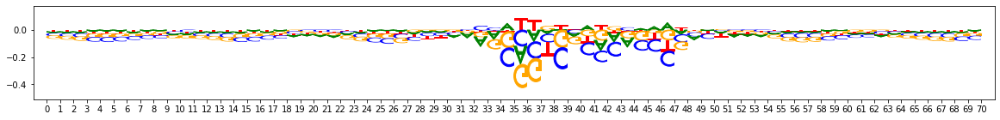

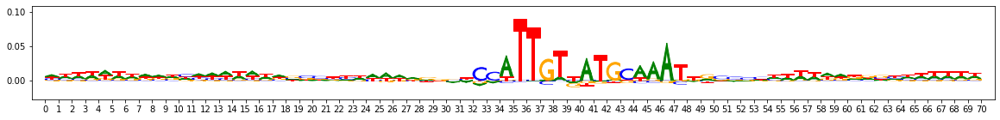

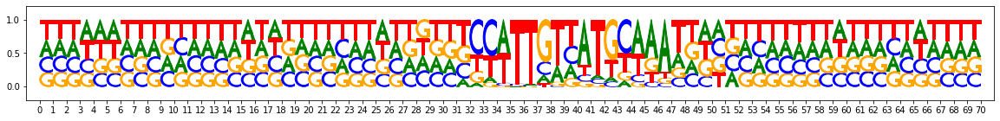

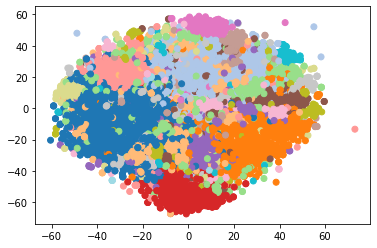

Subcluster: 0 size: 2074


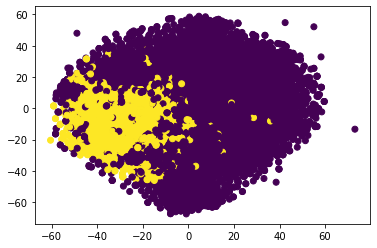

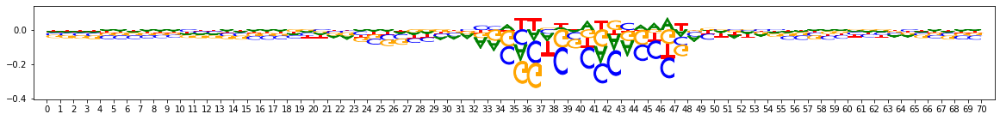

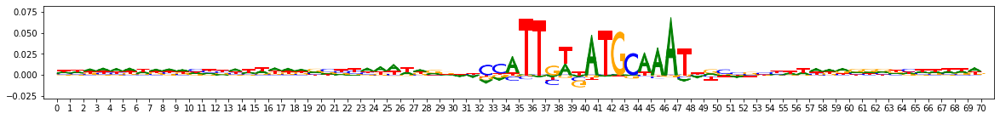

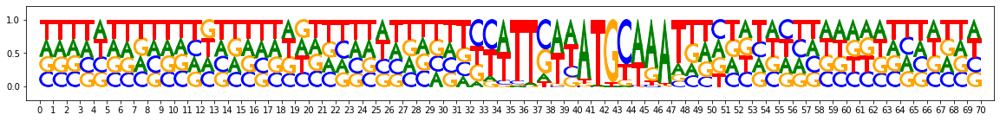

Subcluster: 1 size: 1456


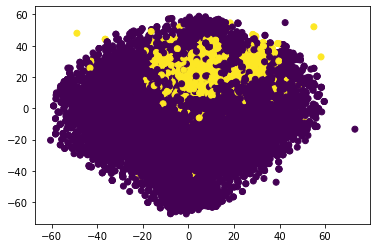

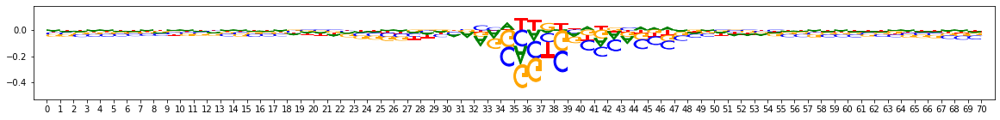

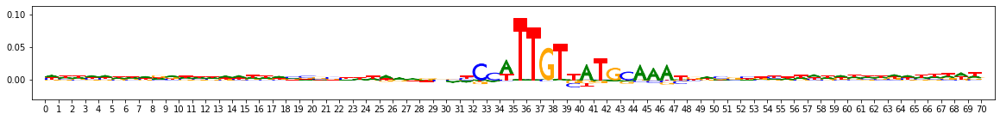

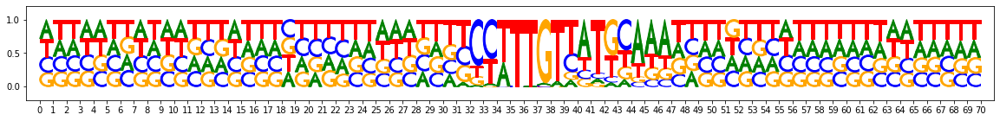

Subcluster: 2 size: 1306


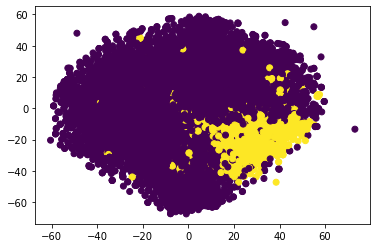

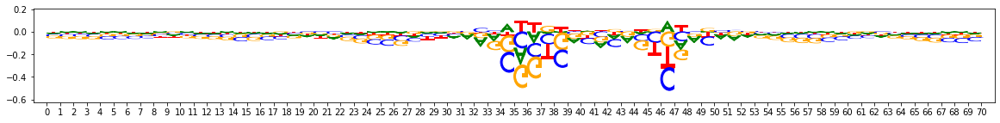

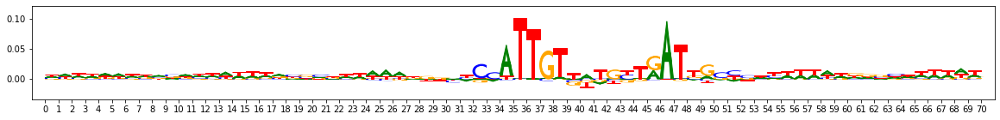

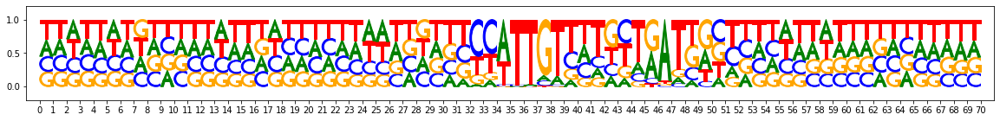

Subcluster: 3 size: 762


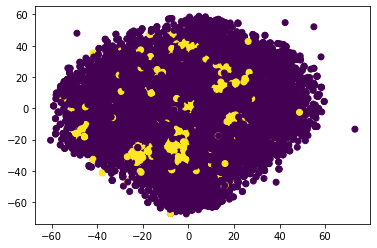

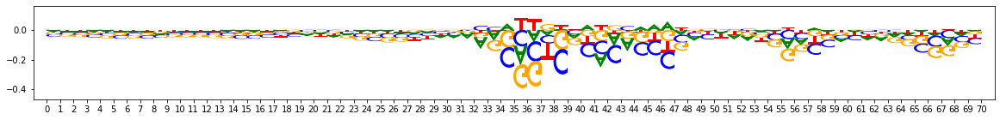

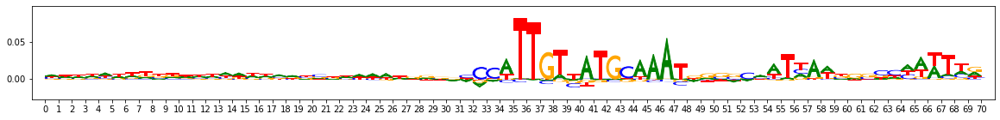

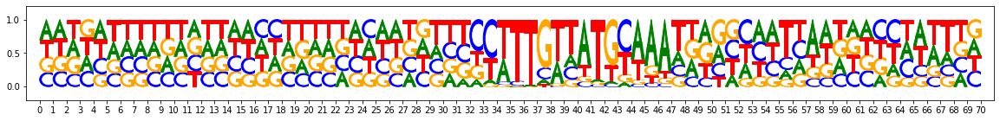

Subcluster: 4 size: 685


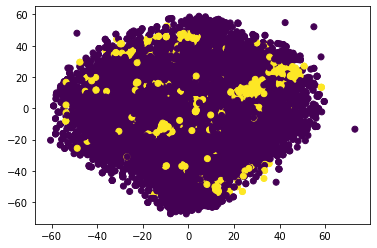

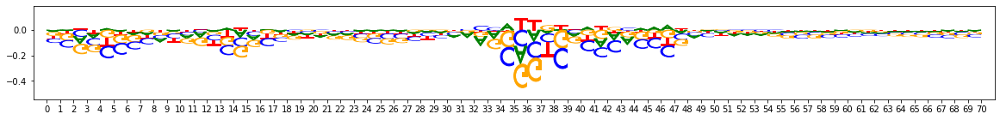

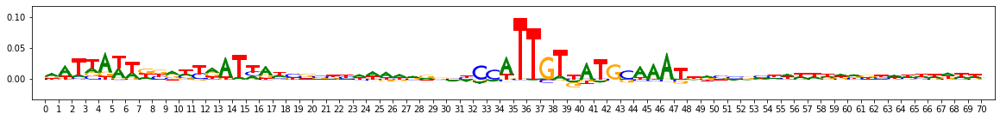

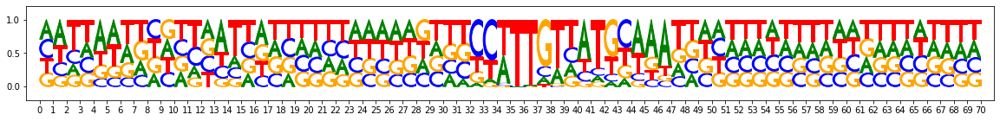

Subcluster: 5 size: 661


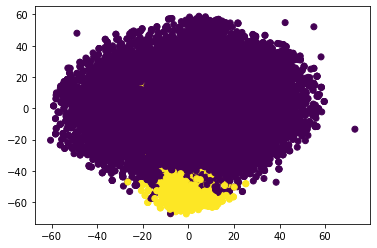

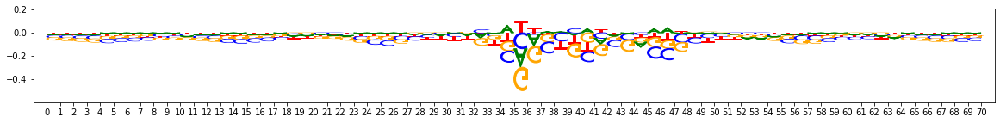

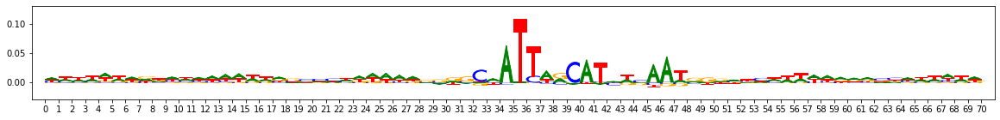

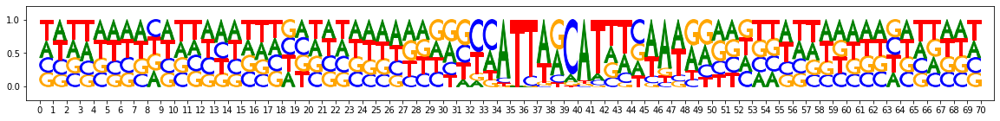

Subcluster: 6 size: 591


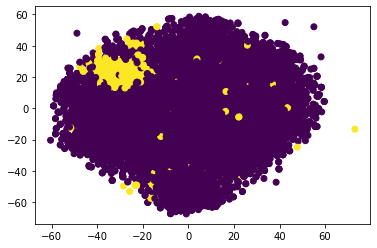

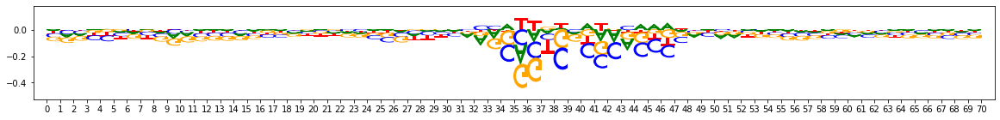

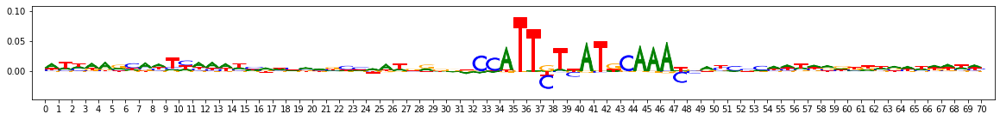

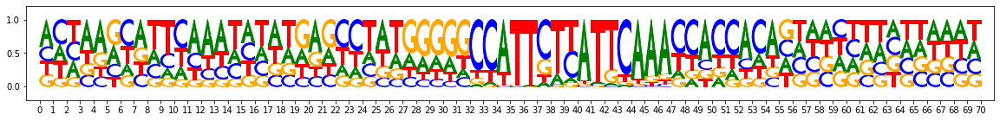

Subcluster: 7 size: 512


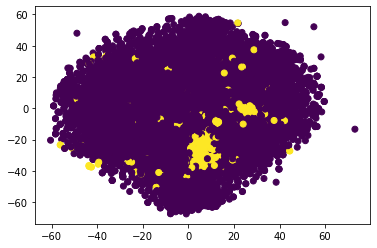

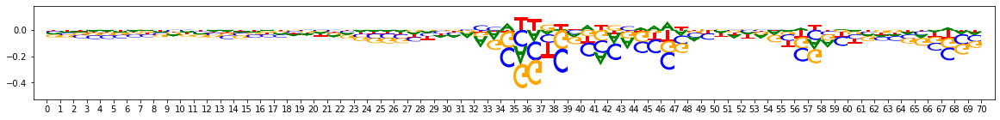

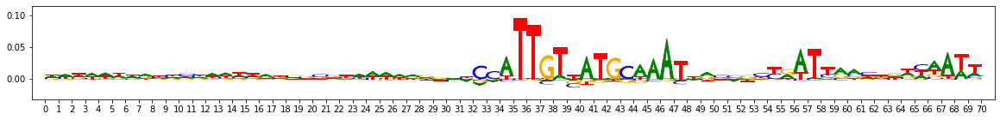

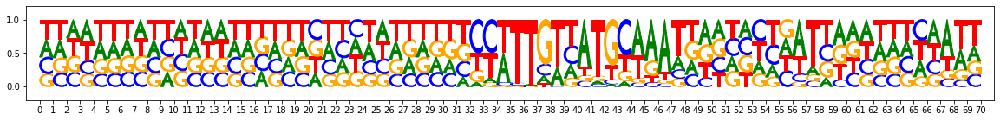

Subcluster: 8 size: 376


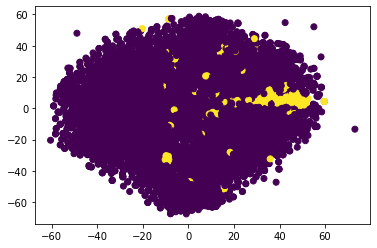

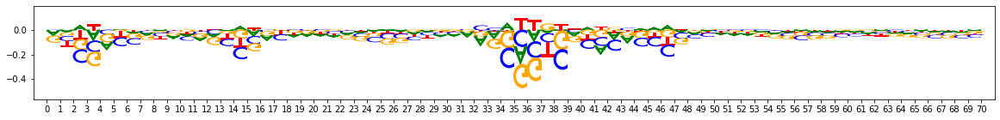

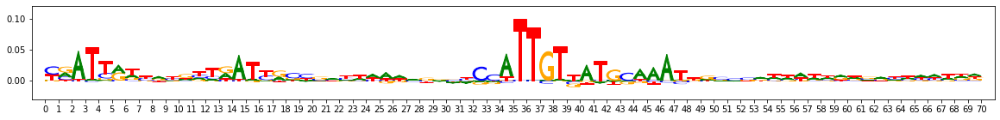

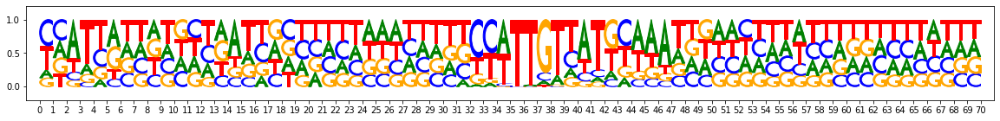

Subcluster: 9 size: 334


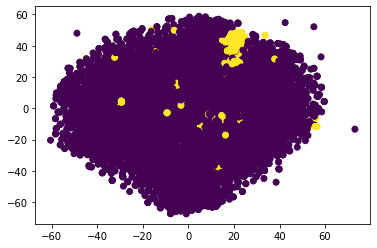

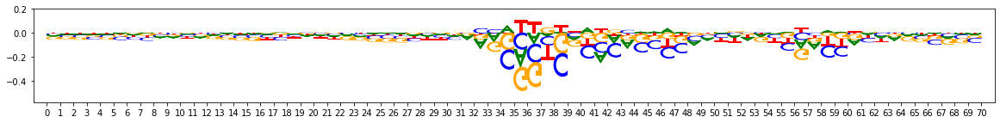

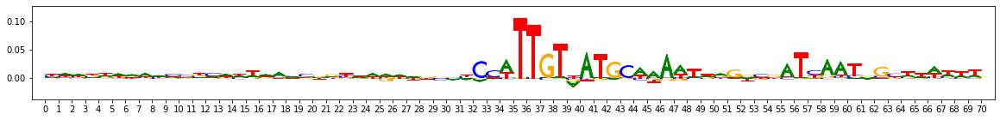

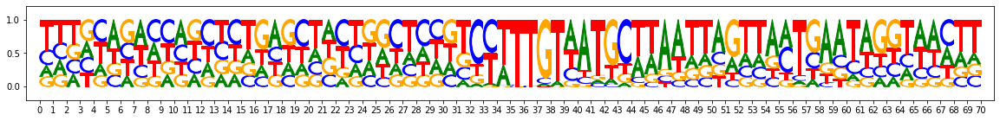

Subcluster: 10 size: 295


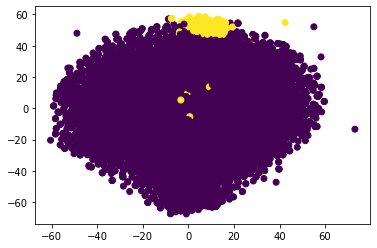

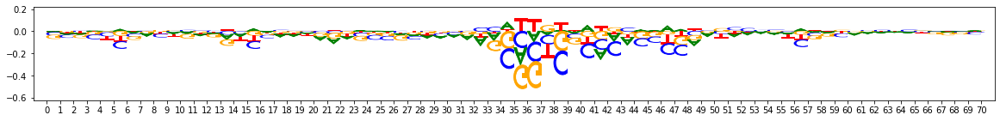

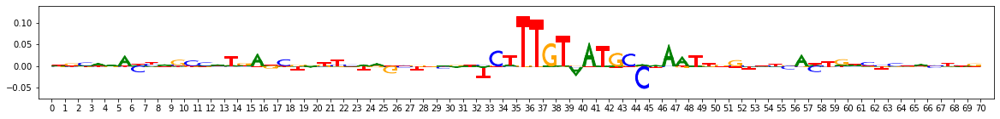

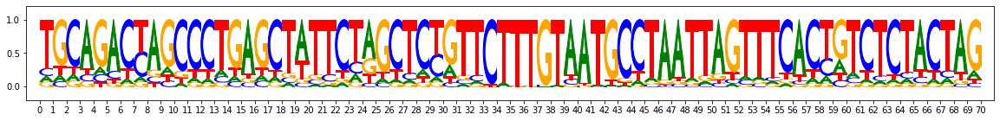

Subcluster: 11 size: 281


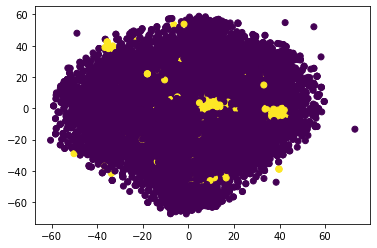

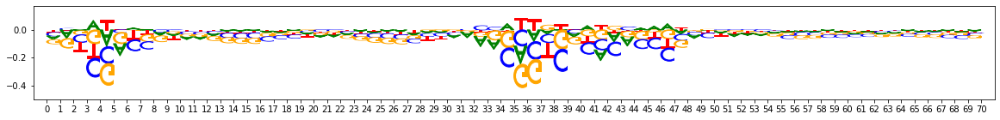

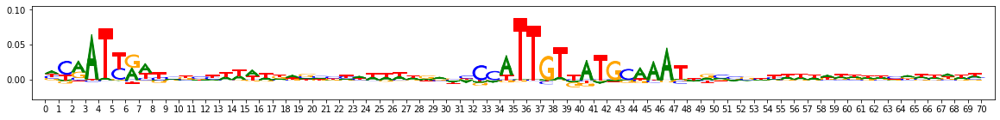

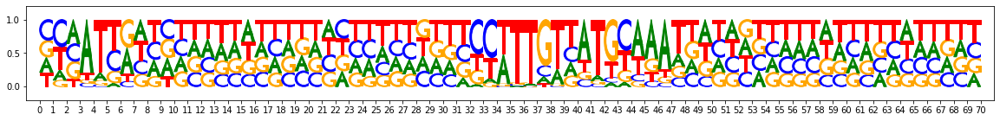

Subcluster: 12 size: 272


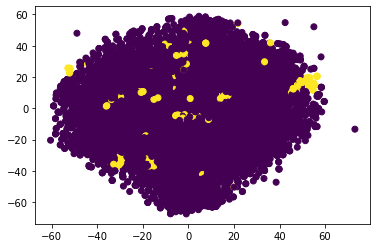

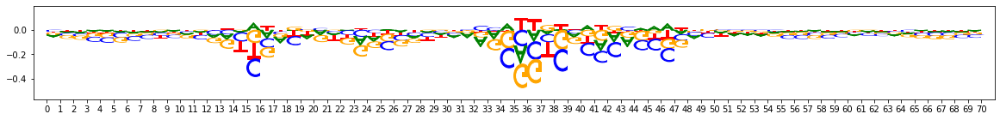

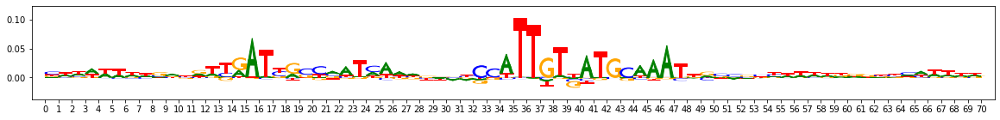

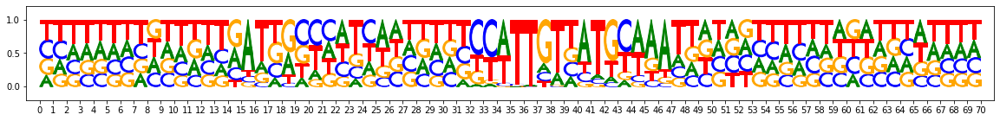

Subcluster: 13 size: 214


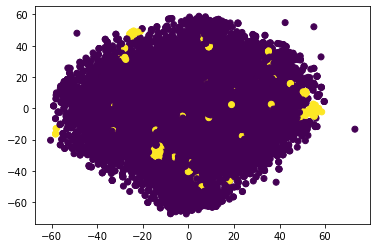

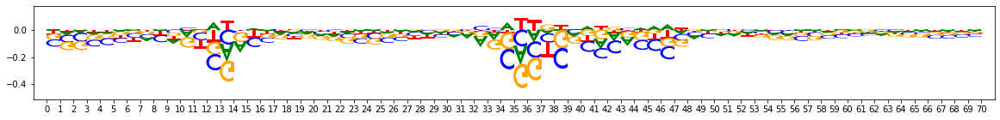

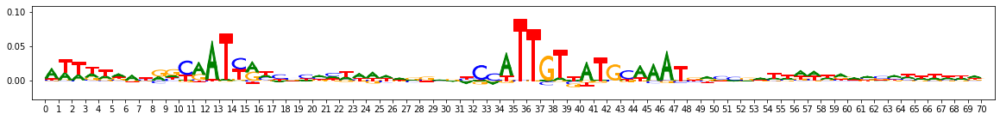

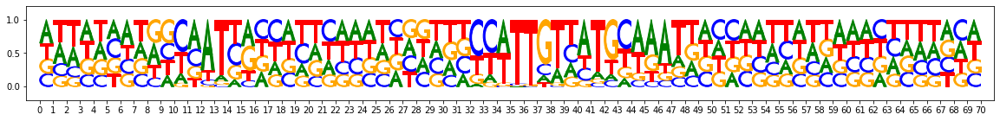

Subcluster: 14 size: 175


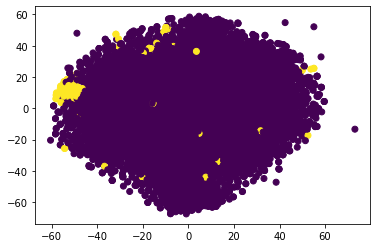

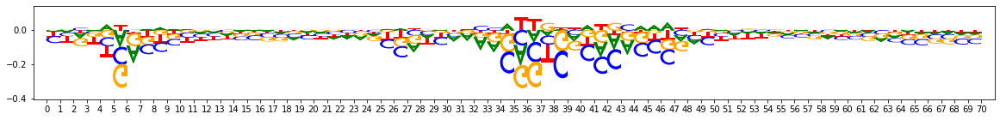

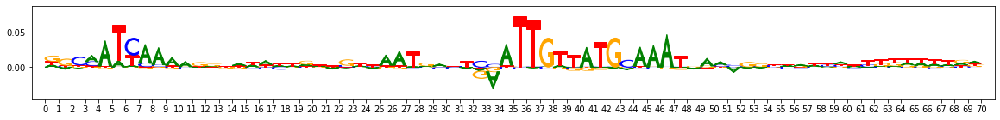

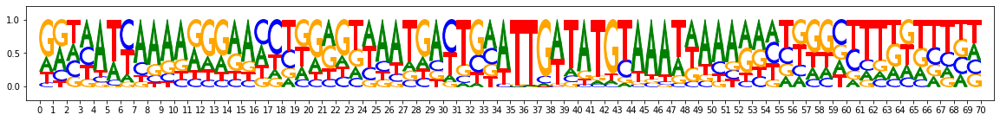

Subcluster: 15 size: 131


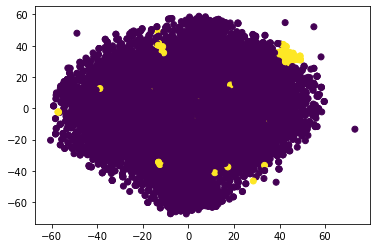

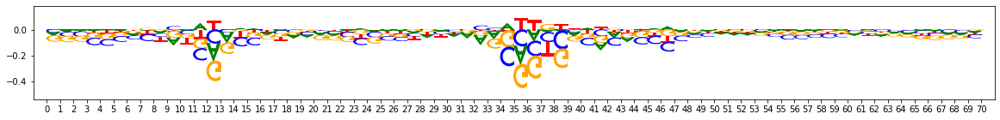

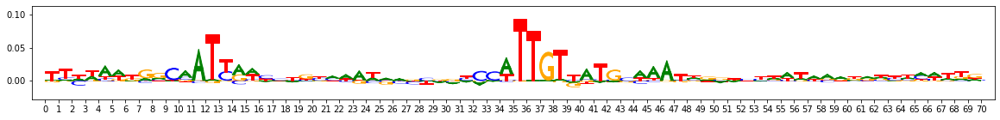

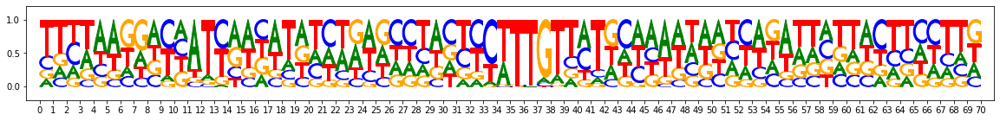

Subcluster: 16 size: 24


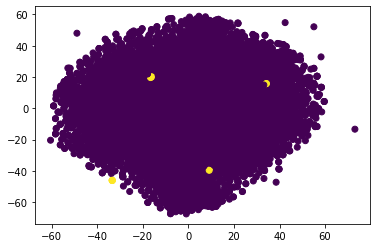

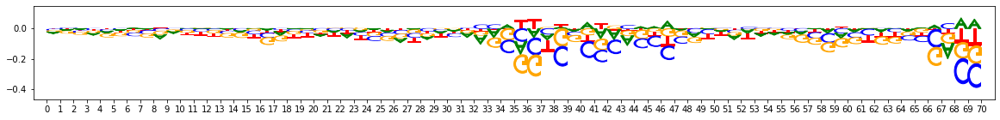

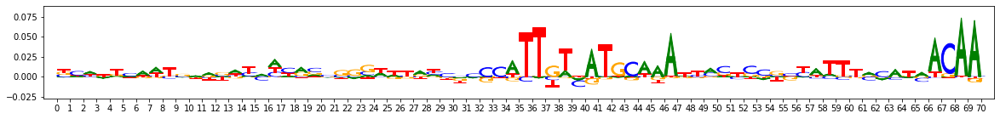

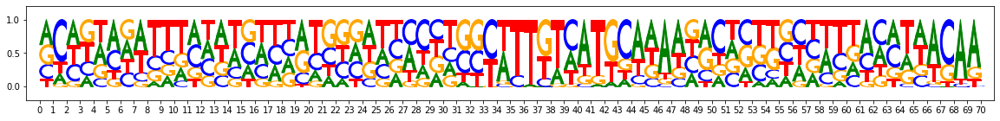

Pattern idx 1
overall - num seqlets: 8933


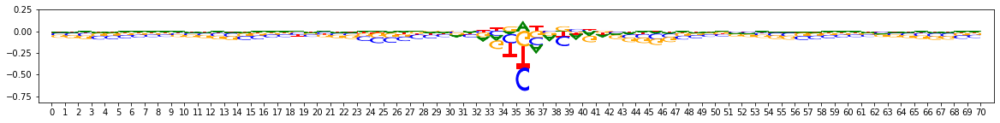

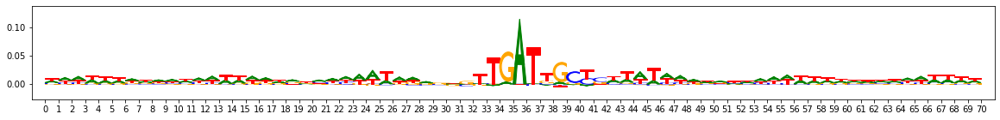

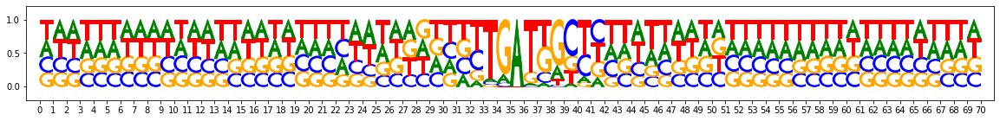

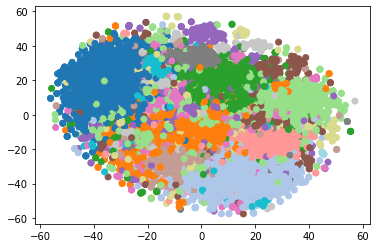

Subcluster: 0 size: 1669


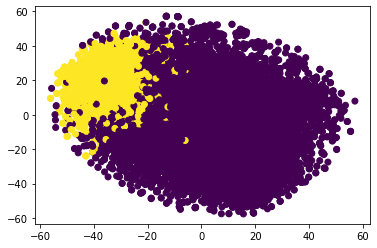

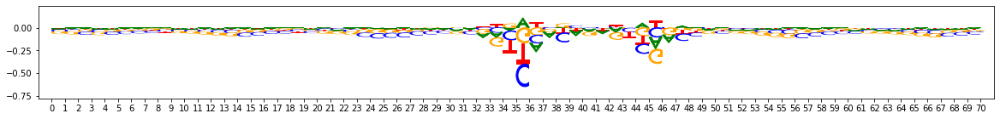

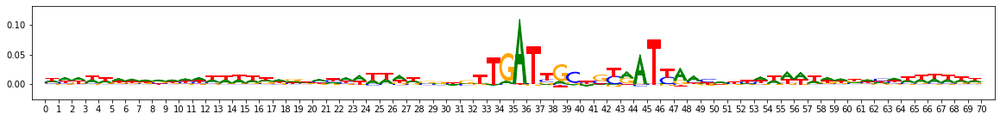

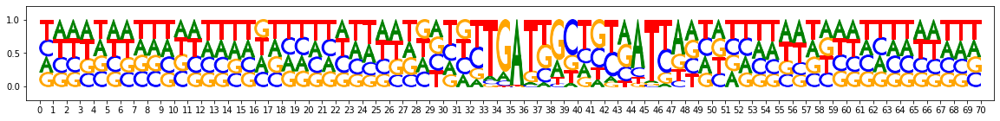

Subcluster: 1 size: 1217


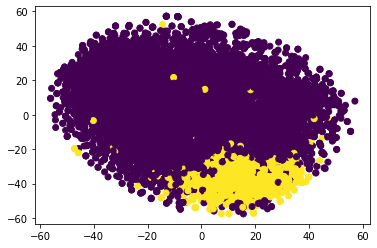

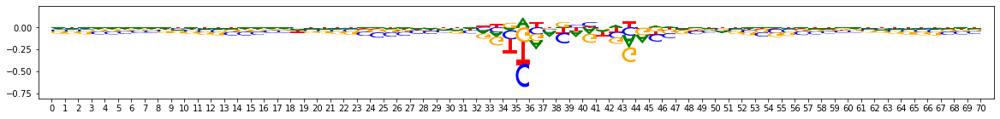

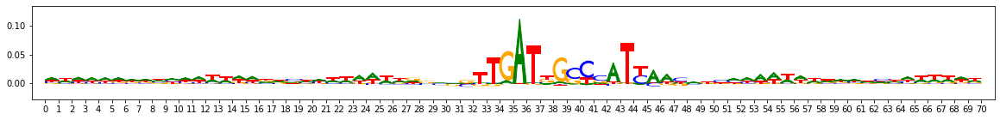

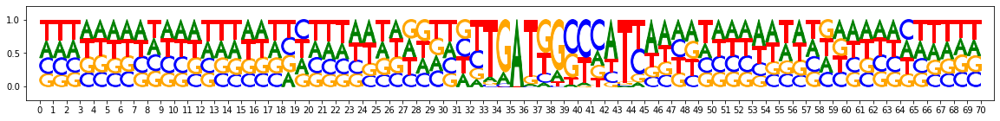

Subcluster: 2 size: 1123


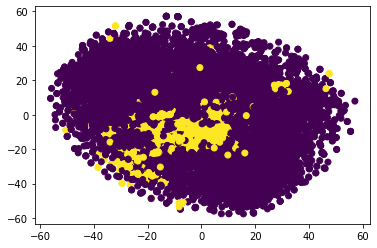

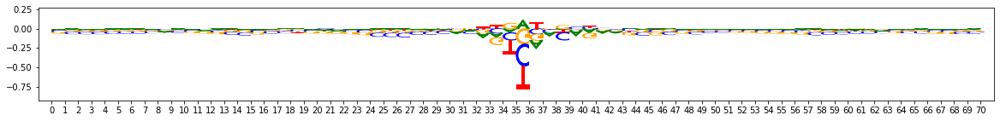

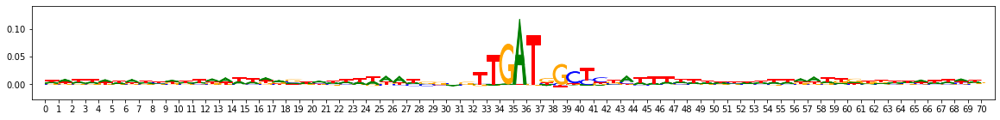

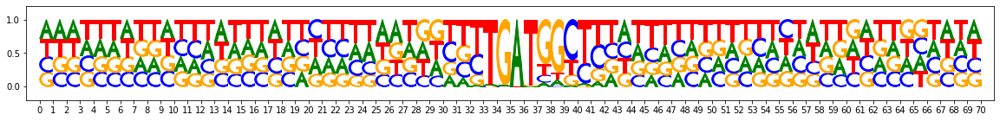

Subcluster: 3 size: 999


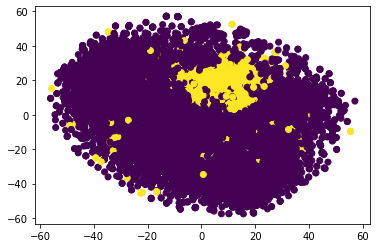

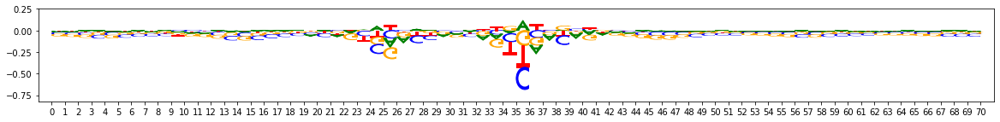

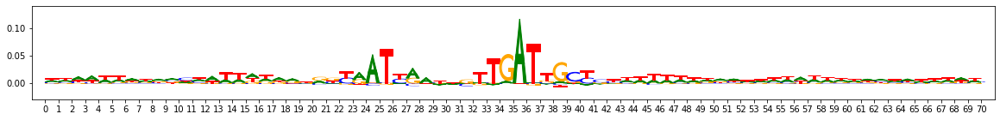

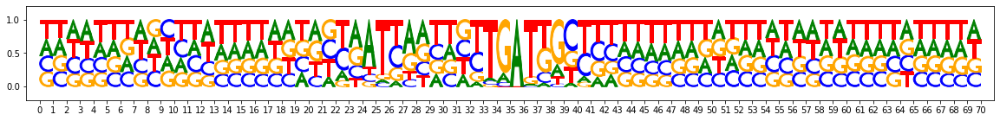

Subcluster: 4 size: 937


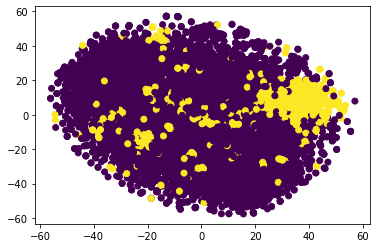

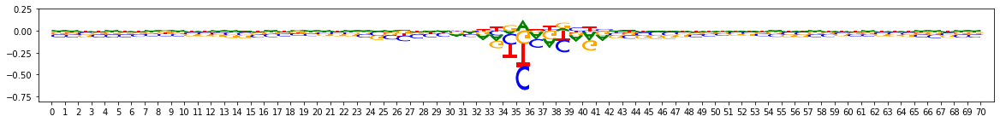

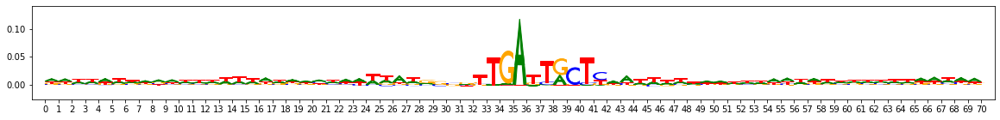

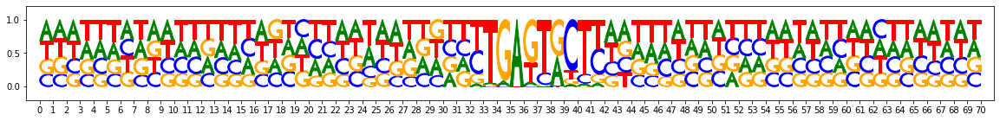

Subcluster: 5 size: 506


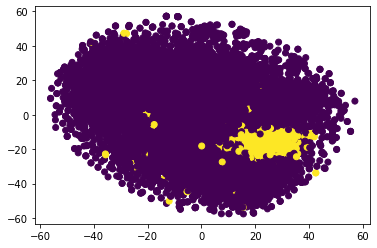

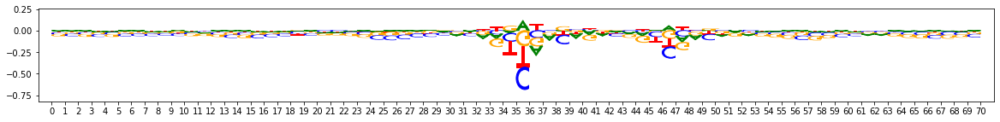

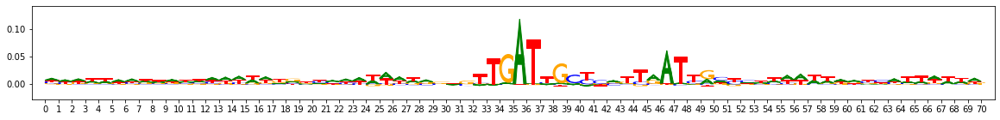

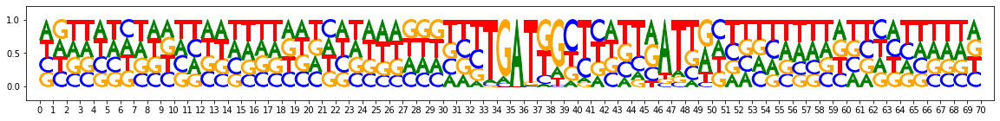

Subcluster: 6 size: 411


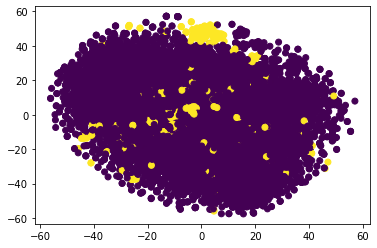

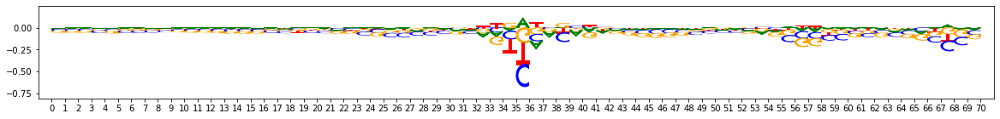

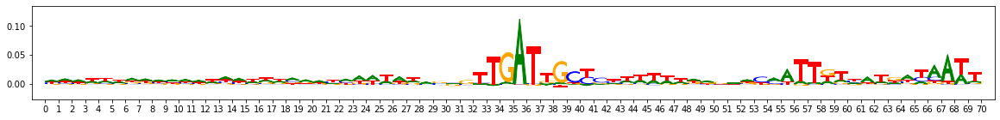

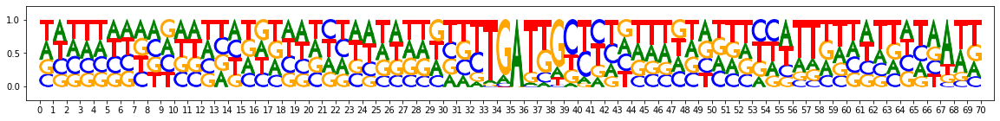

Subcluster: 7 size: 410


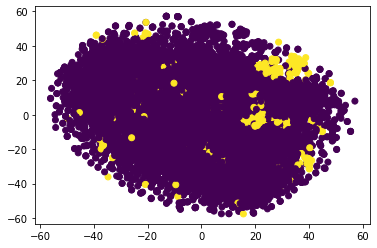

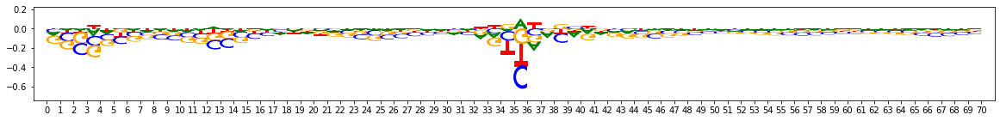

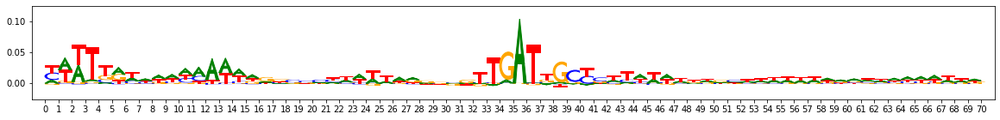

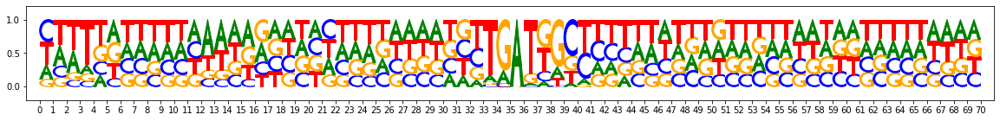

Subcluster: 8 size: 397


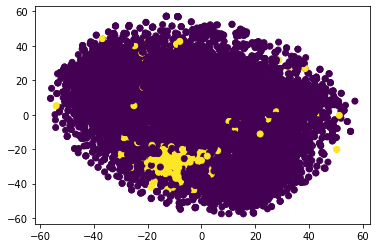

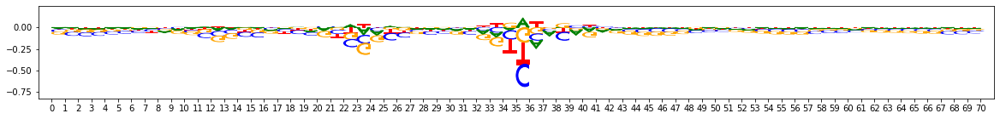

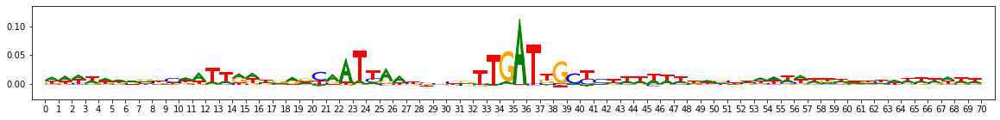

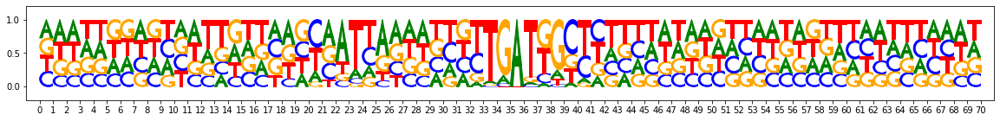

Subcluster: 9 size: 366


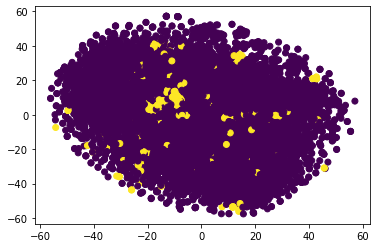

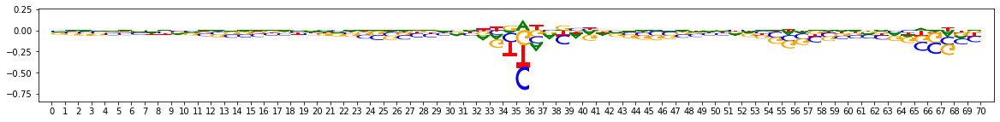

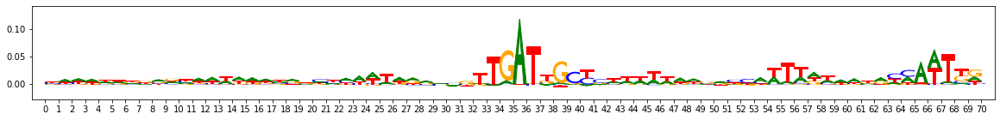

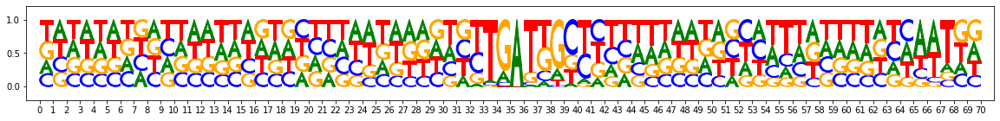

Subcluster: 10 size: 276


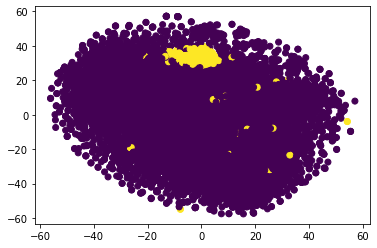

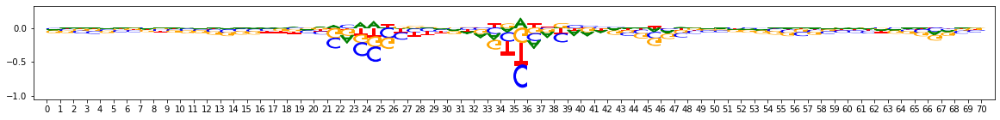

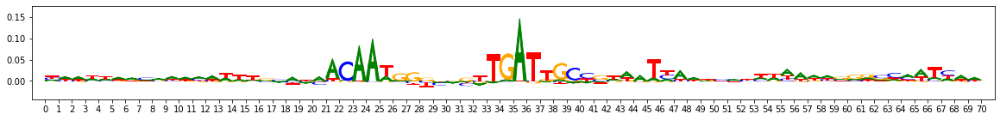

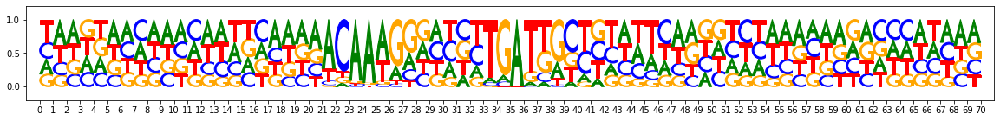

Subcluster: 11 size: 250


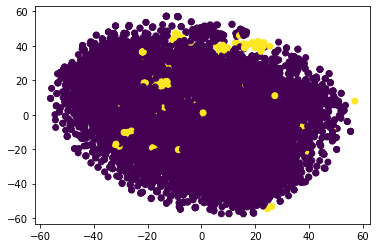

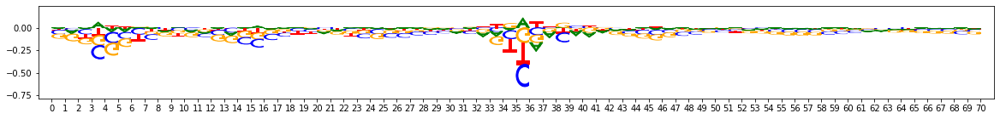

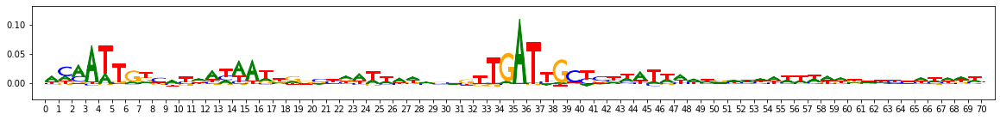

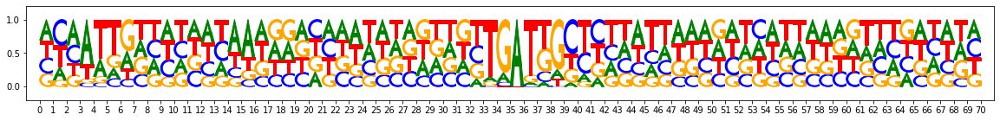

Subcluster: 12 size: 223


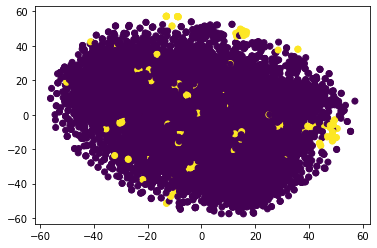

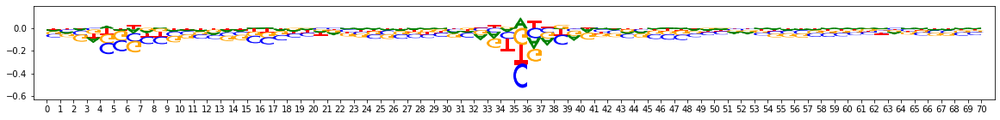

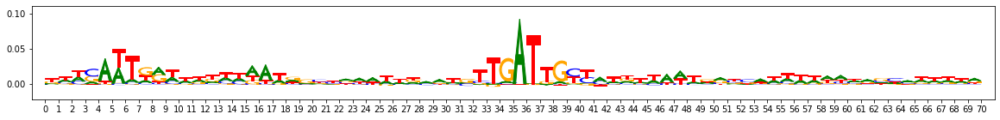

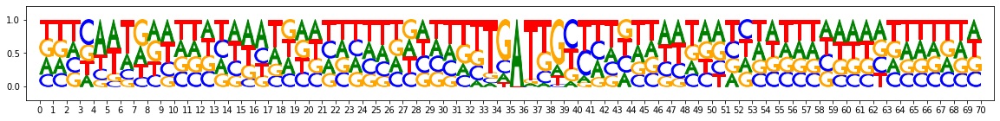

Subcluster: 13 size: 133


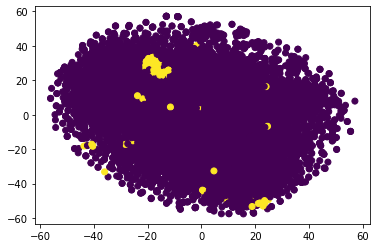

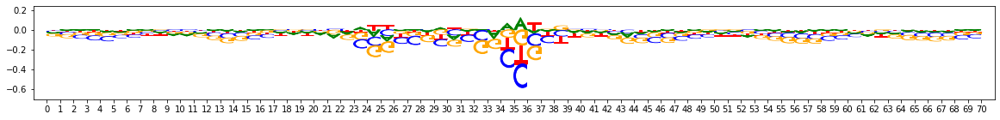

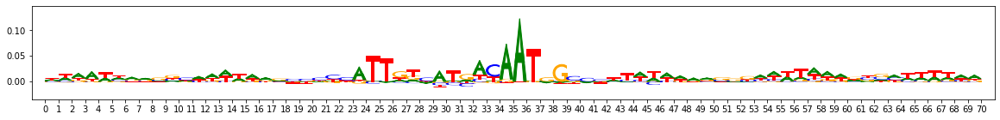

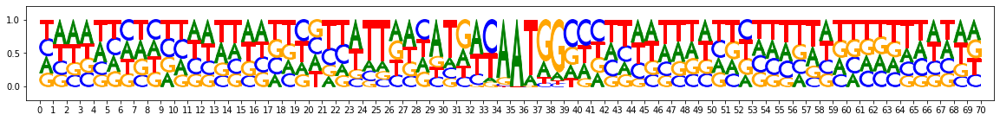

Subcluster: 14 size: 16


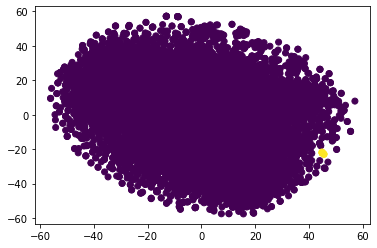

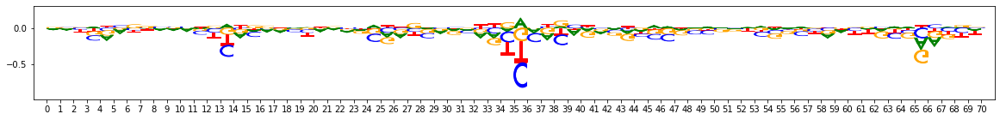

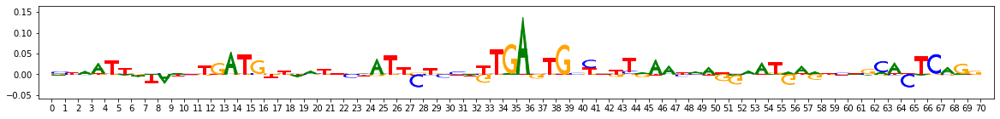

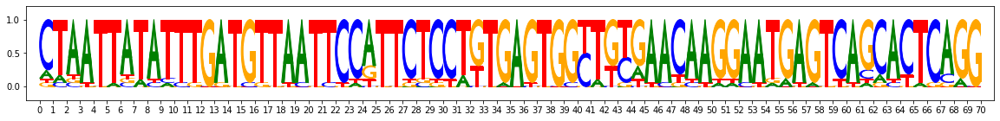

In [10]:
from matplotlib import pyplot as plt

patterns = (loaded_tfmodisco_results
            .metacluster_idx_to_submetacluster_results["metacluster_0"]
            .seqlets_to_patterns_result.patterns)
for patternidx,pattern in enumerate(patterns[:2]):
    print("Pattern idx",patternidx)
    print("overall - num seqlets:",len(pattern.seqlets))
    viz_sequence.plot_weights(pattern["Nanog_profile_wn_hypothetical_contribs"].fwd)
    viz_sequence.plot_weights(pattern["Nanog_profile_wn_contrib_scores"].fwd)
    viz_sequence.plot_weights(pattern["sequence"].fwd)
    subclusters = np.array(pattern.subclusters)
    twod_embedding = np.array(pattern.twod_embedding)
    plt.scatter(twod_embedding[:,0], twod_embedding[:,1], c=subclusters, cmap="tab20")
    plt.show()
    for subcluster, subpattern in pattern.subcluster_to_subpattern.items():
        print("Subcluster:",subcluster,"size:",len(subpattern.seqlets))
        plt.scatter(twod_embedding[:,0], twod_embedding[:,1], c=(subclusters==subcluster))
        plt.show()
        viz_sequence.plot_weights(subpattern["Nanog_profile_wn_hypothetical_contribs"].fwd)
        viz_sequence.plot_weights(subpattern["Nanog_profile_wn_contrib_scores"].fwd)
        viz_sequence.plot_weights(subpattern["sequence"].fwd)